### 1 Import

##### 1.1 Load Libraries

In [184]:
import numpy as np
import pandas as pd
from math import isnan
import glob
import os
from zipfile import BadZipFile
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import seaborn as sns
import quantstats as qs

from datetime import datetime as dt 
import time
import datetime

import refinitiv.data as rd
from refinitiv.data.content import fundamental_and_reference

from collections import defaultdict
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.cluster import KMeans
from scipy.spatial.distance import mahalanobis
from scipy.linalg import inv
from scipy.stats import shapiro
from scipy.stats import jarque_bera
from sklearn.metrics import silhouette_score
from sklearn.metrics import silhouette_samples
from scipy import stats
from scipy.stats import chi2
from scipy.stats import zscore
from sklearn.neighbors import KNeighborsRegressor, NearestNeighbors
from random import sample
from numpy.random import uniform
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from mpl_toolkits.mplot3d import Axes3D
import statsmodels.api as sm
from scipy.spatial.distance import cdist
from scipy.spatial import distance
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import adjusted_rand_score

In [185]:
#import eikon as ek
#ek.set_app_key('ABCD')

In [186]:
start_year = 2005
end_year = 2023

quarter_end_dates = pd.read_excel('Data/QuarterEndDates.xlsx')
start_date = f'{start_year}-01-01'
end_date = f'{end_year}-12-31'

filtered_dates = quarter_end_dates[(quarter_end_dates['Date'] >= start_date) & (quarter_end_dates['Date'] <= end_date)]

quarter_end_dates_list = filtered_dates['Date'].dt.date.tolist()
quarter_end_dates_list

[datetime.date(2023, 12, 29),
 datetime.date(2023, 9, 29),
 datetime.date(2023, 6, 30),
 datetime.date(2023, 3, 31),
 datetime.date(2022, 12, 30),
 datetime.date(2022, 9, 30),
 datetime.date(2022, 6, 30),
 datetime.date(2022, 3, 31),
 datetime.date(2021, 12, 31),
 datetime.date(2021, 9, 30),
 datetime.date(2021, 6, 30),
 datetime.date(2021, 3, 31),
 datetime.date(2020, 12, 31),
 datetime.date(2020, 9, 30),
 datetime.date(2020, 6, 30),
 datetime.date(2020, 3, 31),
 datetime.date(2019, 12, 31),
 datetime.date(2019, 9, 30),
 datetime.date(2019, 6, 28),
 datetime.date(2019, 3, 29),
 datetime.date(2018, 12, 31),
 datetime.date(2018, 9, 28),
 datetime.date(2018, 6, 29),
 datetime.date(2018, 3, 29),
 datetime.date(2017, 12, 29),
 datetime.date(2017, 9, 29),
 datetime.date(2017, 6, 30),
 datetime.date(2017, 3, 31),
 datetime.date(2016, 12, 30),
 datetime.date(2016, 9, 30),
 datetime.date(2016, 6, 30),
 datetime.date(2016, 3, 31),
 datetime.date(2015, 12, 31),
 datetime.date(2015, 9, 30),
 date

In [187]:
dates_df = pd.DataFrame(quarter_end_dates_list, columns=['End Date'])

def derive_fiscal_period(date):
    quarter_mapping = {3: '1FQ', 6: '2FQ', 9: '3FQ', 12: '4FQ'}
    quarter = quarter_mapping[date.month]
    year = date.year
    if date.month == 1:
        year -= 1
    fiscal_period = f"{quarter}{year}"
    return fiscal_period

dates_df['Fiscal Period'] = dates_df['End Date'].apply(derive_fiscal_period)
dates_df = dates_df.rename(columns={"End Date" : "Date"})
dates_df

,Date,Fiscal Period
0,2023-12-29,4FQ2023
1,2023-09-29,3FQ2023
2,2023-06-30,2FQ2023
3,2023-03-31,1FQ2023
4,2022-12-30,4FQ2022
...,...,...
71,2006-03-31,1FQ2006
72,2005-12-30,4FQ2005
73,2005-09-30,3FQ2005
74,2005-06-30,2FQ2005


In [188]:
# df, err = ek.get_data('AMCR.N', ['TR.IPODate'])
# df

In [189]:
# Import SPX Index Constituents from Eikon API Pre-Loaded:
spx_const = pd.read_csv('Data/spx_index_constituents.csv').drop(columns=['Unnamed: 0'])
spx_const['Date'] = pd.to_datetime(spx_const['Date'])

# Remove this Instrument, as it didnt exist before 2019:
spx_const = spx_const[~((spx_const['Instrument'] == 'AMCR.N') & (spx_const['Date'] < pd.Timestamp('2019-06-11')))]
spx_const

,Instrument,ISIN,Date
0,MMM.N,US88579Y1010,2023-12-29
1,AOS.N,US8318652091,2023-12-29
2,ABT.N,US0028241000,2023-12-29
3,ABBV.N,US00287Y1091,2023-12-29
4,ACN.N,IE00B4BNMY34,2023-12-29
...,...,...,...
38157,XL.N^I18,BMG982941046,2005-03-31
38158,XTO.N^F10,US98385X1063,2005-03-31
38159,YUM.N,US9884981013,2005-03-31
38160,ZBH.N,US98956P1021,2005-03-31


##### 1.2 Eikon API Import -> Save to Excel/csv

In [190]:
# # Check if every ISIN can be found by requesting the Industry
# isins = spx_const
# isins = isins['ISIN'].dropna().unique()
# isins = [isin for isin in isins if isin != ""]

# data, err = ek.get_data(list(isins), ["TR.TRBCEconomicSector"])

# if err is not None:
#     print("Ein Fehler ist aufgetreten:", err)
# else:
#     data.to_excel('all_const_TRBCEconomicSector.xlsx', index=False)
#     print('Daten wurden erfolgreich in all_const_bc_industry.xlsx gespeichert.')

In [191]:
# # Check if every ISIN can be found by requesting the Industry
# isins = spx_const
# isins = isins['ISIN'].dropna().unique()
# isins = [isin for isin in isins if isin != ""]

# data, err = ek.get_data(list(isins), ["TR.TRBCIndustry"])

# if err is not None:
#     print("Ein Fehler ist aufgetreten:", err)
# else:
#     data.to_excel('all_const_bc_industry.xlsx', index=False)
#     print('Daten wurden erfolgreich in all_const_bc_industry.xlsx gespeichert.')

In [192]:
# # Check if every ISIN can be found by requesting the Industry
# isins = spx_const
# isins = isins['ISIN'].dropna().unique()
# isins = [isin for isin in isins if isin != ""]
# print(isins)
# data, err = ek.get_data((isins), ["TR.IPODate"])

# if err is not None:
#     print("Ein Fehler ist aufgetreten:", err)
# else:
#     data.to_excel('IPO Dates.xlsx', index=False)
#     print('Daten wurden erfolgreich in IPO Dates.xlsx gespeichert.')

In [193]:
# # Define the index ticker and market index
# index_ticker = ".SP500PV"
# market_index = "SP_Pure_val"

# # Assuming 'constituents_dates' is a list of dates for which you want to retrieve data
# constituents_dates = quarter_end_dates_list  # Use the dates obtained previously
# # Initialize an empty DataFrame for index constituents
# index_constituents = pd.DataFrame()

# dt_counter = 0
# for dt in constituents_dates:
#     dt_counter += 1
#     print(f"Date: {dt_counter} / {len(constituents_dates)}")
    
#     if dt == "":
#         continue
#     dt2 = dt.strftime('%Y-%m-%d')  # Format date as needed
    
#     flag = False
#     while not flag:
#         try:
#             # Retrieve data using the Eikon API
#             df, err = ek.get_data(instruments=[f"0#{index_ticker}({dt2})"], fields=["TR.ISIN"])
#             if err is None and not df.empty and len(df.columns) == 2 and len(df) >= 2:
#                 flag = True
#                 df['Date'] = dt
#                 index_constituents = pd.concat([index_constituents, df], ignore_index=True)
#             else:
#                 print("No data retrieved, waiting 5 seconds")
#                 time.sleep(5)
#         except Exception as e:
#             print("Error with download, waiting 5 minutes")
#             time.sleep(300)

# # Save the DataFrame to a file
# index_constituents.to_csv(f"{market_index}_index_constituents.csv")

In [194]:
# # Import of ADS Indicator
# ads_all_vint = pd.read_excel('Data/ADS_All_Vintages.xlsx').set_index('Date')

# def format_column_name(column_name):
#     if column_name.startswith("ADS_INDEX_"):
#         date_str = column_name.replace("ADS_INDEX_", "")
#         formatted_date = f"20{date_str[4:6]}-{date_str[0:2]}-{date_str[2:4]}"
#         return formatted_date
#     else:
#         return column_name

# ads_all_vint.columns = [format_column_name(col) for col in ads_all_vint.columns]

In [195]:
# formatted_column_dates = [datetime.datetime.strptime(col, "%Y-%m-%d").date() for col in ads_all_vint.columns]

# def find_closest_date(target_date, available_dates):
#     # Filter für Daten vor oder gleich dem Ziel-Datum
#     valid_dates = [date for date in available_dates if date <= target_date]
#     if not valid_dates:
#         return None
#     return max(valid_dates)  # Das letzte verfügbare Datum

# selected_columns = []
# for target_date in end_of_month_business_days_dates:
#     closest_date = find_closest_date(target_date, formatted_column_dates)
#     if closest_date:
#         # Finden Sie den entsprechenden Spaltennamen für das nächstgelegene Datum
#         column_name = closest_date.strftime("%Y-%m-%d")
#         if column_name in ads_all_vint.columns:
#             selected_columns.append(column_name)

# new_table = ads_all_vint[selected_columns].copy()
# new_table.to_excel('ADS_Quarterly_filtered.xlsx')

In [196]:
# def fn_get_close_prices(current_year_constituents, start_date, end_date):
#     data_directory = 'Data/Eikon/Prices'
#     os.makedirs(data_directory, exist_ok=True)
    
#     rics = current_year_constituents.tolist()
#     rics = [ric for ric in rics if ric != ""]

#     batch_size = 5 
#     all_close_prices = pd.DataFrame()  

#     for i in range(0, len(rics), batch_size):
#         slice_rics = rics[i:i+batch_size]
#         flag = False
#         while not flag:
#             try:
#                 df = ek.get_timeseries(slice_rics, 
#                                        start_date=start_date, 
#                                        end_date=end_date, 
#                                        interval="daily", 
#                                        fields="CLOSE")
#                 if not df.empty:
#                     flag = True
#                     all_close_prices = pd.concat([all_close_prices, df], axis=1)
#                 else:
#                     print("Keine Daten abgerufen, warte 5 Sekunden")
#                     time.sleep(5)
#             except Exception as e:
#                 print(f"HTTP-Anfrage fehlgeschlagen: {e}")
#                 print("Fehler beim Download, warte 5 Minuten")
#                 time.sleep(12)

#     excel_file_path = os.path.join(data_directory, f"SPX_CLOSE_PRICES_{start_date.replace('-', '')}_to_{end_date.replace('-', '')}.xlsx")
#     with pd.ExcelWriter(excel_file_path) as writer:
#         all_close_prices.to_excel(writer, sheet_name='Close Prices')
#     print("Datenabruf und Speicherung abgeschlossen.")

In [197]:
# Analyse the changes in Index Constituents
min_max_dates = spx_const.groupby('Instrument')['Date'].agg(MIN_DATE='min', MAX_DATE='max')
min_max_dates['DAY_DIFF'] = ((min_max_dates['MAX_DATE'] - min_max_dates['MIN_DATE']) / np.timedelta64(1, 'D')).astype(int)
min_max_dates

,MIN_DATE,MAX_DATE,DAY_DIFF
Instrument,,,
A.N,2005-03-31,2023-12-29,6847
AABA.OQ^J19,2005-03-31,2017-03-31,4383
AAL.OQ,2015-03-31,2023-12-29,3195
AAP.N,2015-09-30,2023-06-30,2830
AAPL.OQ,2005-03-31,2023-12-29,6847
...,...,...,...
YUM.N,2005-03-31,2023-12-29,6847
ZBH.N,2005-03-31,2023-12-29,6847
ZBRA.OQ,2019-12-31,2023-12-29,1459


In [198]:
# spx_const.to_excel('spx constituents.xlsx')

In [199]:
def filter_const_per_year(year, spx_const):
    start_date = pd.Timestamp(year=year-1, month=1, day=1)  # gehe 1 Jahr weiter zurück um Histo zu haben um Momentum zu rechnen
    end_date = pd.Timestamp(year=year, month=12, day=31)

    filtered_constituents = min_max_dates[
        (min_max_dates['MIN_DATE'] <= end_date) &
        (min_max_dates['MAX_DATE'] >= start_date)
    ].index

    return filtered_constituents


# for year in range(2010, 2024):
#     print(f"Starte Datenabruf für das Jahr: {year}")
#     current_year_constituents = filter_const_per_year(year, spx_const)
    
#     if 'AABA.OQ^J19' in current_year_constituents.values:
#         print(f"'AABA.OQ^J19' ist im Jahr {year} ein Konstituent.")
#     else:
#         print('')
    

In [200]:
# for year in range(2005, 2023):
#     print(f"Starte Datenabruf für das Jahr: {year}")
    
#     # Hier nur die aktuellen Const filtern, +/- in Jahr
#     current_year_constituents = filter_const_per_year(year, spx_const)
#     start_date = f"{year}-01-01"
#     end_date = f"{year}-12-31"
    
#     fn_get_close_prices(current_year_constituents, start_date, end_date)

In [201]:
# def fn_get_basic_data(req_date, fields):   
#     data_directory = 'Data/Eikon/basic'
#     os.makedirs(data_directory, exist_ok=True)
    
#     # Only Request exactly the constituents in S&P500 at that time:
#     current_spx_const = spx_const[spx_const['Date'] == req_date]
#     isins = current_spx_const
#     isins = isins['Instrument'].dropna().unique()
#     isins = [isin for isin in isins if isin != ""]

#     batch_size = 20

#     if isinstance(fields, str):
#         fields = [fields]

#     outputdata = {}
#     for field in fields:
#         print(f"Requesting Field: {field} for Date per: {req_date}")

#         excel_file_path = os.path.join(data_directory, f"SPX_{field}_{req_date.replace('-', '')}.xlsx")
        
#         if os.path.exists(excel_file_path):
#             print(f"File already exists: {excel_file_path}. Skipping data retrieval.")
#             continue

#         for i in range(0, len(isins), batch_size): 
#             slice_isins = isins[i:i+batch_size]
#             flag = False
#             while not flag:
#                 try:
#                     df, err = ek.get_data(slice_isins, [field], {"Frq": 'Y', "SDate": req_date, "EDate": req_date})
#                     ## For Dividend:
#                     #df, err = ek.get_data(slice_isins, [field], {"Frq": 'Y', "SDate": req_date})
#                     if err is None and not df.empty:
#                         flag = True
#                         if field in outputdata:
#                             outputdata[field] = pd.concat([outputdata[field], df], ignore_index=True)
#                         else:
#                             outputdata[field] = df
#                     else:
#                         print("No data retrieved, waiting 5 seconds")
#                         time.sleep(5)
#                 except Exception as e:
#                     print(f"HTTP request failed: {e}")
#                     print(f"Error with download, waiting 4 minutes: {e}")
#                     time.sleep(10)

#     if outputdata:
#         with pd.ExcelWriter(excel_file_path) as writer:
#             for key, df in outputdata.items():
#                 df.to_excel(writer, sheet_name=key[:31])
#         print("Data retrieval and saving completed.")
#     else:
#         print("No data to save.")

In [202]:
# for req_date in quarter_end_dates_list:
#     req_date_str = req_date.strftime('%Y-%m-%d')
    
#     #fn_get_basic_data(req_date_str, "TR.FreeFloat")
#     #fn_get_basic_data(req_date_str, "TR.WACCBeta")
#     #fn_get_basic_data(req_date_str, "TR.MarketCapDS")
#     #fn_get_basic_data(req_date_str, "TR.PriceClose")
#     # fn_get_basic_data(req_date_str, "TR.DPSActValue")
#     fn_get_basic_data(req_date_str, "TR.CompanyMarketCap")

In [203]:
# df, err = ek.get_data('AMCR.N', ['TR.F.BVperShrIssue'], {"Frq": 'd', "SDate": '2005-06-30', "EDate": '2007-06-29'})
# df

In [204]:
# def fn_get_data(req_date, fiscal_period, fields):
#     data_directory = 'Data/Eikon/Financials/'
#     os.makedirs(data_directory, exist_ok=True)
    
#     # Only Request exactly the constituents in S&P500 at that time:
#     current_spx_const = spx_const[spx_const['Date'] == req_date]
#     isins = current_spx_const
#     isins = isins['Instrument'].dropna().unique()
#     isins = [isin for isin in isins if isin != ""]

#     req_date_str = req_date.strftime('%Y-%m-%d')
    
#     batch_size = 300

#     if isinstance(fields, str):
#         fields = [fields]

#     outputdata = {}

#     for field in fields:
#         print(f"Requesting Field: {field} for Date per: {req_date} for Fiscal Period: {fiscal_period}")

#         excel_file_path = os.path.join(data_directory, f"SPX_{field}_{req_date.year}_Q{((req_date.month - 1) // 3 + 1)}.xlsx")
    
#         if os.path.exists(excel_file_path):
#             print(f"File already exists: {excel_file_path}. Skipping data retrieval.")
#             continue

#         for i in range(0, len(isins), batch_size): 
#             slice_isins = isins[i:i+batch_size]
#             flag = False
#             while not flag:
#                 try:
# #                    df, err = ek.get_data(slice_isins, [field], {"Period": fiscal_period})
#                     # df, err = ek.get_data(slice_isins, [field], {"Frq": 'Y', "SDate": req_date_str, "EDate": req_date_str})
#                     df, err = ek.get_data(slice_isins, [field], {"SDate": req_date_str, "Frq": 'Y'})
#                     if not df.empty:
#                         flag = True
#                         if field in outputdata:
#                             outputdata[field] = pd.concat([outputdata[field], df], ignore_index=True)
#                         else:
#                             outputdata[field] = df
#                     else:
#                         print("No data retrieved, waiting 5 seconds")
#                         print(err)
#                         time.sleep(5)
#                 except Exception as e:
#                     print(f"HTTP request failed: {e}")
#                     print(f"Error with download, waiting 4 minutes")
#                     time.sleep(240) 

#     if outputdata:
#         with pd.ExcelWriter(excel_file_path) as writer:
#             for key, df in outputdata.items():
#                 df.to_excel(writer, sheet_name=key[:31])
#         print("Data retrieval and saving completed.")
#     else:
#         print("No data to save.")
    

In [205]:
# for index, row in dates_df.iterrows():
#     date = row['Date']
#     req_date = pd.Timestamp(date)
#     period = row['Fiscal Period']
#     #fn_get_data(req_date, period, "TR.DPSActValue")
#     ##fn_get_data(req_date, period, "TR.F.BookValuePerShr")
#     ##fn_get_data(req_date, period, "TR.F.EPSDilExclExOrdComTotTTM") 
#     ##fn_get_data(req_date, period, "TR.F.LeveredFOCFPerShrTTM") 
#     ##fn_get_data(req_date, period, "TR.F.TotRevPerShrTTM") 
#     ##fn_get_data(req_date, period, "TR.F.DivYldComStockIssuePctTTM") 
#     fn_get_data(req_date, period, "TR.DPSActValue") 
    

In [206]:
# df, err = ek.get_data('BRKb.N', ['TR.F.BVperShrIssue'], {"EDate": '2021-12-29',"Frq":'Y', "InstrumentType" : 'Primary'})
# df

### 2 Data Pre-Processing / Descriptive Analysis

#### 2.1 Index Prices

In [207]:
# Import S&P500 Total Price Index Monthly
SPX = pd.read_excel('Data/SPX G V.xlsx').set_index('Date')
SPX.describe()

,SPG,SPV,SPX,SPXPG,SPXPV,SPW Index
count,240.000000,240.000000,240.000000,240.000000,240.000000,240.000000
mean,1290.589346,907.838380,2193.735042,8150.944833,4695.437750,3161.404792
std,821.409039,336.301383,1132.260316,5079.890996,2009.401036,1598.905603
min,390.575900,338.888500,735.090000,1990.100000,1034.940000,908.400000
25%,632.090900,629.491500,1280.517500,3595.392500,2911.672500,1773.852500
50%,1007.715000,836.895000,1878.145000,7428.540000,4760.165000,2958.435000
75%,1740.536500,1107.901750,2851.180000,11700.717500,6373.980000,4186.590000
max,3410.904000,1845.714000,5254.350000,21425.680000,8901.140000,6875.880000


In [208]:
# # Import S&P500 Total Price Index Monthly
# SPX = pd.read_excel('Data/SPXPR.xlsx').set_index('Date')
# SPX = SPX['Last'].sort_index()
# print('Nr of isna: '+ str(SPX.isna().sum()))
# SPX.describe()

In [209]:
# # Import S&P500 Growth Price Return Index Monthly
# SP_GrowthIndex = pd.read_excel('Data/SPXGPR.xlsx').set_index('Date')
# SP_GrowthIndex = SP_GrowthIndex['Last'].sort_index()
# print('Nr of isna: '+ str(SP_GrowthIndex.isna().sum()))
# SP_GrowthIndex.describe()

In [210]:
# # Import S&P500 Value Price Return Index Monthly
# SP_ValueIndex = pd.read_excel('Data/SPXVPR.xlsx').set_index('Date')
# SP_ValueIndex = SP_ValueIndex['Last'].sort_index()
# print('Nr of isna: '+ str(SP_ValueIndex.isna().sum()))
# SP_ValueIndex.describe()

In [211]:
SPX.index = pd.to_datetime(SPX.index)
start_date = dt.strptime('2008-03-01', '%Y-%m-%d').date()
end_date = dt.strptime('2023-12-29', '%Y-%m-%d').date()

start_date = pd.to_datetime(start_date)
end_date = pd.to_datetime(end_date)

SPX = SPX[SPX.index > start_date]
SPX = SPX[SPX.index <= end_date]

def normalize_series(series):
    return (series / series.iloc[0]) * 100

SPX_norm = normalize_series(SPX['SPX'][SPX.index > start_date])
SP_GrowthIndex_norm = normalize_series(SPX['SPG'][SPX.index > start_date])
SP_ValueIndex_norm = normalize_series(SPX['SPV'][SPX.index > start_date])
SP_pureGrowthIndex_norm = normalize_series(SPX['SPXPG'][SPX.index > start_date])
SP_pureValueIndex_norm = normalize_series(SPX['SPXPV'][SPX.index > start_date])
sp_gg_norm = normalize_series(SPX['SPW Index'][SPX.index > start_date])

In [212]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=SPX.index, y=SPX_norm, mode='lines', name='S&P 500 Index'))
fig.add_trace(go.Scatter(x=SPX.index, y=SP_GrowthIndex_norm, mode='lines', name='S&P 500 Growth Index'))
fig.add_trace(go.Scatter(x=SPX.index, y=SP_ValueIndex_norm, mode='lines', name='S&P 500 Value Index'))
fig.add_trace(go.Scatter(x=SPX.index, y=SP_pureGrowthIndex_norm, mode='lines', name='S&P 500 Pure Growth Index'))
fig.add_trace(go.Scatter(x=SPX.index, y=SP_pureValueIndex_norm, mode='lines', name='S&P 500 Pure Value Index'))
fig.add_trace(go.Scatter(x=SPX.index, y=sp_gg_norm, mode='lines', name='S&P 500 Equal Weighted Index'))


fig.update_layout(title='S&P 500 Growth, S&P 500 Value & S&P 500',
                  xaxis_title='Datum',
                  yaxis_title='Wert',
                  legend_title='Index',
                  hovermode='x')
fig.show()

In [213]:
# # Import S&P500 Total Return Index Monthly
# SPX_TR = pd.read_excel('Data/SPXTR.xlsx').set_index('Date')
# SPX_TR = SPX_TR['Last'].sort_index()

# SP_ValueIndex_TR = pd.read_excel('Data/SPXVTR.xlsx').set_index('Date')
# SP_ValueIndex_TR = SP_ValueIndex_TR['Close'].sort_index()

# SP_GrowthIndex_TR = pd.read_excel('Data/SPXGTR.xlsx').set_index('Date')
# SP_GrowthIndex_TR = SP_GrowthIndex_TR['Close'].sort_index()


# fig = go.Figure()
# fig.add_trace(go.Scatter(x=SP_ValueIndex_TR.index, y=SP_ValueIndex_TR.values, mode='lines', name='SP_ValueIndex_TR'))
# fig.add_trace(go.Scatter(x=SP_GrowthIndex_TR.index, y=SP_GrowthIndex_TR.values, mode='lines', name='SP_GrowthIndex_TR'))
# fig.add_trace(go.Scatter(x=SPX_TR.index, y=SPX_TR.values, mode='lines', name='SP500 Index'))
# fig.update_layout(title='Zeitreihenvergleich: SP500 Growth TR Index, SP500 Value TR Index & SP500 TR Index',
#                   xaxis_title='Datum',
#                   yaxis_title='Wert',
#                   legend_title='Index',
#                   hovermode='x')
# fig.show()

In [214]:
# Adjusted Price/Earnings ratio	
# Adjusted Price/Book ratio	
# Adjusted Price/Sales ratio

Index_Ratios = pd.read_excel('Data/Index Infos Histo.xlsx')
Index_Ratios['Date'] = Index_Ratios['Date'].dt.strftime('%Y-%m-%d')
Index_Ratios

,Date,Index,INDX_ADJ_PE,INDX_PX_BOOK,INDX_PX_SALES
0,2008-03-30,SPX Index,15.1249,2.5110,1.3707
1,2008-06-30,SPX Index,14.9168,2.4275,1.2814
2,2008-09-30,SPX Index,14.5941,2.2046,1.1436
3,2008-12-31,SPX Index,11.2416,1.7967,0.8873
4,2009-03-31,SPX Index,11.3303,1.8262,0.8058
...,...,...,...,...,...
385,2023-03-31,SPW Index,15.6762,2.8867,1.5445
386,2023-06-30,SPW Index,16.6030,2.9617,1.5556
387,2023-09-29,SPW Index,15.7361,2.7403,1.4505
388,2023-12-29,SPW Index,17.2413,3.0055,1.6352


In [215]:
spx_top_weights = pd.read_excel('Data/SP500 Overview.xlsx', sheet_name='2')
spx_top_weights

,ED,ISIN,NAME,GICS_SECTOR,WEIGHT
0,2011-12-30,US30231G1022,Exxon Mobil Corporation,Energy,0.035983
1,2011-12-30,US0378331005,Apple Inc.,Information Technology,0.032814
2,2011-12-30,US4592001014,International Business Machines Corporation,Information Technology,0.019172
3,2011-12-30,US1667641005,Chevron Corporation,Energy,0.018613
4,2011-12-30,US5949181045,Microsoft Corporation,Information Technology,0.016901
...,...,...,...,...,...
112,2023-12-29,US02079K3059,Alphabet Inc. Class A,Communication Services,0.020647
113,2023-12-29,US30303M1027,Meta Platforms Inc Class A,Communication Services,0.019622
114,2023-12-29,US02079K1079,Alphabet Inc. Class C,Communication Services,0.017532
115,2023-12-29,US88160R1014,"Tesla, Inc.",Consumer Discretionary,0.017164


In [216]:
# spx_top_weights = pd.read_excel('Data/SP500 Overview.xlsx', sheet_name='2')

# # Umwandlung des Datums in das richtige Format, falls nötig
# spx_top_weights['ED'] = pd.to_datetime(spx_top_weights['ED'])

# # Daten nach Datum sortieren
# spx_top_weights.sort_values('ED', inplace=True)

# fig = px.bar(spx_top_weights, x='ED', y='WEIGHT', color='NAME', 
#              title='Gestapelte Gewichtung der Top 10 S&P 500 Konstituenten über die Zeit',
#              labels={'WEIGHT': 'Gewicht (%)', 'ED': 'Datum', 'NAME': 'Unternehmen'},
#              text_auto=True,  # Fügt den Balken Text mit Gewichtungsdaten hinzu
             
#              )

# # Verbesserung der Achsenbeschriftungen und des Layouts
# fig.update_layout(xaxis_title='Datum', yaxis_title='Gewicht (%)',
#                   yaxis=dict(tickformat=".1%"),  # Formatierung der y-Achse als Prozentsatz
#                   legend_title_text='Unternehmen')  # Legendentitel setzen

# # Diagramm anzeigen
# fig.show()


In [217]:
# spx_top_weights = pd.read_excel('Data/SP500 Overview.xlsx', sheet_name='2')
# spx_top_weights['ED'] = pd.to_datetime(spx_top_weights['ED'])

# data_2012 = spx_top_weights[spx_top_weights['ED'].dt.year == 2012]
# latest_year = spx_top_weights['ED'].dt.year.max()
# data_latest = spx_top_weights[spx_top_weights['ED'].dt.year == latest_year]

# comparison_data = pd.concat([data_2012.assign(Year='2012'), data_latest.assign(Year=str(latest_year))])

# fig = px.bar(comparison_data, x='Year', y='WEIGHT', color='NAME',
#              title=f'Vergleich der Top 10 S&P 500 Konstituenten 2012 vs. {latest_year}',
#              labels={'WEIGHT': 'Gewicht (%)', 'NAME': 'Unternehmen', 'Year': 'Jahr'},
#              category_orders={"Year": ["2012", str(latest_year)]}) 

# fig.update_layout(xaxis_title='Jahr', yaxis_title='Gewicht (%)',
#                   yaxis=dict(tickformat=".1%"),
#                   legend_title_text='Unternehmen')

# fig.show()

In [218]:
spx_sector_weights = pd.read_excel('Data/SP500 Overview.xlsx', sheet_name='1')
spx_sector_weights['Date'] = pd.to_datetime(spx_sector_weights['Date'])
spx_sector_weights

,Date,Sector,Weight
0,2011-12-30,Information Technology,0.155948
1,2011-12-30,Financials,0.132317
2,2011-12-30,Health Care,0.123336
3,2011-12-30,Energy,0.122342
4,2011-12-30,Consumer Staples,0.115018
...,...,...,...
138,2023-12-29,Consumer Staples,0.061551
139,2023-12-29,Energy,0.038875
140,2023-12-29,Real Estate,0.025177
141,2023-12-29,Materials,0.024074


In [219]:
# fig = px.bar(spx_sector_weights, x='Date', y='Weight', color='Sector',              
#              labels={'Weight': 'Gewicht (%)', 'Date': 'Datum', 'Sector': 'Sektor'},
#              text_auto=True
#              )

# fig.update_layout(xaxis_title='Date', yaxis_title='Weights (%)',
#                   yaxis=dict(tickformat=".0%"), 
#                   legend_title_text='GICS Sector') 

# fig.show()

#### 2.2 SPX Constituents

In [220]:
# spx_const.groupby('Date').size().plot(figsize=(12,4))

In [221]:
# Analyse the changes in Index Constituents
spx_const['Date'] = pd.to_datetime(spx_const['Date'])
min_max_dates = spx_const.groupby('Instrument')['Date'].agg(MIN_DATE='min', MAX_DATE='max')
min_max_dates['DAY_DIFF'] = ((min_max_dates['MAX_DATE'] - min_max_dates['MIN_DATE']) / np.timedelta64(1, 'D')).astype(int)
filtered_min_max_dates = min_max_dates[(min_max_dates['DAY_DIFF'] != 6848)] #Remove all the Constituents, which are in Index since 05 to 23
filtered_min_max_dates.to_excel('Min Max.xlsx')

In [222]:
# Remove all the Constituents that were not longer in SPX than 360 Days
const_to_remove = filtered_min_max_dates[(filtered_min_max_dates['DAY_DIFF'] < 360)] 
const_to_remove_list = const_to_remove.reset_index()['Instrument']
const_to_remove_list = const_to_remove_list.tolist()
const_to_remove_list

['ABNB.OQ',
 'AXON.OQ',
 'BG.N',
 'BLDR.N',
 'BX.N',
 'BXLT.N^F16',
 'CMCSK.OQ^L15',
 'CPGX.N^G16',
 'CPN.N^L05',
 'DAL.N^J05',
 'DCN.N^C06',
 'DPH.N^J05',
 'FICO.N',
 'G.N^J05',
 'GEHC.OQ',
 'GLK.N^G05',
 'GP.N^L05',
 'H.N^D07',
 'HUBB.N',
 'KRB.N^A06',
 'KVUE.N',
 'LULU.OQ',
 'MAY.N^H05',
 'MERQE.OQ^A06',
 'NXTL.OQ^H05',
 'PANW.OQ',
 'PODD.OQ',
 'PVN.N^J05',
 'RBK.N^B06',
 'SDS.N^H05',
 'SEBL.OQ^B06',
 'SFA.N^B06',
 'T.N^K05',
 'TOY.N^G05',
 'UBER.N',
 'UCL.N^H05',
 'VC.N^C09',
 'VLTO.N',
 'VNT.N',
 'VRTS.OQ^G05']

In [223]:
len(const_to_remove_list)

40

In [224]:
# Import SPX Index Constituents from Eikon API Pre-Loaded:
spx_const_industry = pd.read_excel('Data/All Constituents BCIndustry.xlsx')
spx_const_industry = spx_const_industry.rename(columns={'Instrument': 'ISIN'})
spx_const_industry

,ISIN,TRBC Industry Name
0,US0758961009,Investment Holding Companies
1,US88579Y1010,Consumer Goods Conglomerates
2,US0028241000,"Medical Equipment, Supplies & Distribution"
3,US00724F1012,Software
4,US0530151036,IT Services & Consulting
...,...,...
905,US12008R1077,Construction Supplies & Fixtures
906,US4435106079,Electrical Components & Equipment
907,US5500211090,Apparel & Accessories
908,US90353T1007,Online Services


In [225]:
# Import SPX Index Constituents from Eikon API Pre-Loaded:
spx_const_eco_sector = pd.read_excel('Data/all_const_TRBCEconomicSector.xlsx')
spx_const_eco_sector = spx_const_eco_sector.rename(columns={'Instrument': 'ISIN', 'TRBC Economic Sector Name': 'Sector'})
spx_const_eco_sector

,ISIN,Sector
0,US88579Y1010,Consumer Non-Cyclicals
1,US8318652091,Industrials
2,US0028241000,Healthcare
3,US00287Y1091,Healthcare
4,IE00B4BNMY34,Technology
...,...,...
859,US4016981056,Healthcare
860,US4750701082,Financials
861,US4990401030,Consumer Cyclicals
862,US1700401094,Healthcare


In [226]:
# Import SPX Index Constituents from Eikon API Pre-Loaded:
spx_ipo = pd.read_excel('Data/IPO Dates.xlsx')
spx_ipo = spx_ipo.rename(columns={'Instrument': 'ISIN'})
spx_ipo

,ISIN,IPO Date
0,US3696043013,1892-06-23
1,IE00BK9ZQ967,1906-10-10
2,US1170431092,1907-12-31
3,US4592001014,1915-11-11
4,US69331C1080,1919-07-24
...,...,...
859,US4016981056,NaN
860,US4750701082,NaN
861,US4990401030,NaN
862,US1700401094,NaN


#### 2.3 Constituent Prices (Daily)

In [227]:
# Importiere alle Constituents Preise
directory_path = 'Data/Eikon/Prices'
all_prices_long = pd.DataFrame()

for filename in os.listdir(directory_path):
    if filename.startswith("SPX_CLOSE_PRICES") and filename.endswith(".xlsx"):
        file_path = os.path.join(directory_path, filename)
        temp_df = pd.read_excel(file_path)

        if 'Date' not in temp_df.columns:
            print(f"Die Date-Spalte fehlt in der Datei {filename}.")
            continue

        temp_df_long = temp_df.melt(id_vars=['Date'], var_name='Instrument', value_name='Price')
        temp_df_long['Date'] = pd.to_datetime(temp_df_long['Date'])

        all_prices_long = pd.concat([all_prices_long, temp_df_long], ignore_index=True)

all_prices_long.sort_values(by=['Date', 'Instrument'], inplace=True)

In [228]:
all_prices_long

,Date,Instrument,Price
404337,2005-01-03,A.N,16.089644
404589,2005-01-03,AABA.OQ^J19,38.260000
404841,2005-01-03,AAPL.OQ,1.131070
405093,2005-01-03,ABI.N^K08,21.010000
405345,2005-01-03,ABK.N^K10,82.390000
...,...,...,...
795668,2023-12-29,YUM.N,130.660000
795918,2023-12-29,ZBH.N,121.700000
796168,2023-12-29,ZBRA.OQ,273.330000
796418,2023-12-29,ZION.OQ,43.870000


In [229]:
all_prices_long.Price.isnull().sum()

35682

In [230]:
missing_prices_to_request = all_prices_long[all_prices_long.Price.isnull()]
missing_prices_to_request 

,Date,Instrument,Price
411897,2005-01-03,AMP.N,NaN
411898,2005-01-04,AMP.N,NaN
411899,2005-01-05,AMP.N,NaN
411900,2005-01-06,AMP.N,NaN
411901,2005-01-07,AMP.N,NaN
...,...,...,...
772667,2023-12-28,SIVB.OQ^C23,NaN
678168,2023-12-29,ATVI.OQ^J23,NaN
715918,2023-12-29,FRC.N^E23,NaN
771168,2023-12-29,SBNY.OQ^C23,NaN


In [231]:
# df, err = ek.get_data('ZION.OQ', ['TR.PriceCloseDate', 'TR.PriceClose'], {"Frq": 'd', "SDate": '2004-01-01', "EDate": '2023-12-29'})
# df

In [232]:
# results = []

# # Durchlaufen aller Zeilen im DataFrame
# for index, row in missing_prices_to_request.iterrows():
#     instrument = row['Instrument']
#     date = row['Date']
    
#     try:
#         # Anfrage an Eikon senden
#         df, err = ek.get_data(
#             instrument, 
#             ['TR.PriceCloseDate', 'TR.PriceClose'], 
#             {
#                 "Frq": 'd', 
#                 "SDate": date,  # Startdatum
#                 "EDate": date   # Enddatum (gleich Startdatum für tägliche Daten)
#             }
#         )
        
#         # Ergebnis zur Liste hinzufügen, falls keine Fehler aufgetreten sind
#         if err is None:
#             results.append(df)
#         else:
#             print(f"Fehler bei der Anfrage für {instrument} am {date}: {err}")
#     except Exception as e:
#         print(f"Ausnahme bei der Anfrage für {instrument} am {date}: {e}")

# # Ergebnisse zusammenführen, falls gewünscht
# final_df = pd.concat(results, ignore_index=True)

# # final_df enthält nun alle erfolgreichen Anfragen
# print(final_df)


In [233]:
# def request_missing_prices(df):
#     # Erstellen eines leeren DataFrames für die Ergebnisse
#     results_df = pd.DataFrame(columns=['Date', 'Instrument', 'PriceClose'])
    
#     # Gruppieren des DataFrames nach Datum
#     grouped = df.groupby('Date')
    
#     for date, group in grouped:
#         instruments = group['Instrument'].tolist()
#         batch_size = 50  # Angepasst an API-Limit
#         for i in range(0, len(instruments), batch_size):
#             batch_instruments = instruments[i:i+batch_size]
            
#             try:
#                 # Anfrage für den Schlusskurs für das gegebene Instrument und Datum
#                 data, err = ek.get_data(
#                     instruments=batch_instruments,
#                     fields=['TR.PriceClose'],
#                     parameters={"SDate": date, "EDate": date, "Frq": "D"}
#                 )
                
#                 # Überprüfen, ob die Anfrage erfolgreich war und Daten zurückgegeben wurden
#                 if err is None and not data.empty:
#                     # Iterieren über die zurückgegebenen Daten und zum Ergebnis-DataFrame hinzufügen
#                     for index, row in data.iterrows():
#                         results_df = results_df.append({
#                             'Date': date, 
#                             'Instrument': row['Instrument'], 
#                             'PriceClose': row['TR.PriceClose']
#                         }, ignore_index=True)
#                 else:
#                     print(f"Keine Daten für Datum {date} gefunden.")
#             except Exception as e:
#                 print(f"Fehler bei der Anfrage für Datum {date}: {e}")
#                 time.sleep(1)  # Kurze Pause, um Rate Limiting zu vermeiden
    
#     return results_df

In [234]:
# instruments_to_request = missing_prices_to_request[missing_prices_to_request.Instrument == 'ZION.OQ']
# instruments_to_request

In [235]:
# fehlende Preise hier wieder importieren
# updated_prices = request_missing_prices(instruments_to_request)
# updated_prices

In [236]:
def fill_missing_prices(df, max_gap=2):    
    df_filled = df.copy()
    for column in df_filled:
        # Vorwärtsfüllung (ffill) mit einem Limit von 'max_gap' anwenden
        df_filled[column] = df_filled[column].ffill(limit=max_gap)
    
    return df_filled

In [237]:
all_price_horizontal = all_prices_long.pivot(index='Date', columns='Instrument', values='Price')
all_price_horizontal = fill_missing_prices(all_price_horizontal)
all_price_horizontal.to_excel('Data/All Prices Horizontal.xlsx')
all_price_horizontal

Instrument,A.N,AABA.OQ^J19,AAL.OQ,AAP.N,AAPL.OQ,ABBV.N,ABI.N^K08,ABK.N^K10,ABMD.OQ^L22,ABNB.OQ,...,XOM.N,XRAY.OQ,XRX.OQ,XTO.N^F10,XYL.N,YUM.N,ZBH.N,ZBRA.OQ,ZION.OQ,ZTS.N
Date,,,,,,,,,,,,,,,,,,,,,
2005-01-03,16.089644,38.26,NaN,NaN,1.131070,NaN,21.01,82.39,NaN,NaN,...,50.09,NaN,44.709026,19.062806,NaN,16.833054,77.008364,NaN,67.39,NaN
2005-01-04,15.665169,36.58,NaN,NaN,1.141785,NaN,20.20,81.30,NaN,NaN,...,49.75,NaN,44.050378,18.981934,NaN,16.610147,76.979260,NaN,66.47,NaN
2005-01-05,15.658431,36.13,NaN,NaN,1.151785,NaN,20.22,82.11,NaN,NaN,...,49.49,NaN,43.180963,18.438933,NaN,16.570599,76.377784,NaN,66.23,NaN
2005-01-06,15.314808,35.43,NaN,NaN,1.152677,NaN,20.64,82.09,NaN,NaN,...,50.12,NaN,42.996541,18.745093,NaN,16.757553,77.260596,NaN,66.61,NaN
2005-01-07,15.301333,35.96,NaN,NaN,1.236606,NaN,20.52,81.00,NaN,NaN,...,49.79,NaN,42.759428,18.612231,NaN,16.664076,77.124778,NaN,64.99,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,139.570000,NaN,14.31,61.25,193.600000,154.94,NaN,NaN,NaN,140.80,...,101.91,35.22,NaN,NaN,112.64,130.000000,120.560000,269.41,44.00,194.98
2023-12-26,139.810000,NaN,14.11,60.92,193.050000,154.62,NaN,NaN,NaN,138.72,...,102.14,35.54,NaN,NaN,113.62,130.260000,121.420000,275.50,44.88,195.50
2023-12-27,139.820000,NaN,13.99,61.56,193.150000,154.88,NaN,NaN,NaN,136.55,...,101.66,35.63,NaN,NaN,114.38,130.840000,121.130000,275.79,44.51,196.90


In [238]:
# def fill_missing_prices_with_log(df, max_gap=2):
#     df_filled = df.copy()
#     fill_log_entries = []

#     for column in df_filled.columns:
#         for i in range(len(df_filled) - 1):  # Adjust loop to prevent index out of range
#             if pd.isna(df_filled.at[df_filled.index[i], column]):
#                 fill_count = 0
#                 # Find next non-NaN value within max_gap
#                 for j in range(1, max_gap + 1):
#                     if i + j < len(df_filled) and not pd.isna(df_filled.at[df_filled.index[i + j], column]):
#                         fill_count = j  # Update fill_count to reflect the gap correctly
#                         break

#                 # Fill the gaps if within max_gap and next value is not NaN
#                 if 0 < fill_count < max_gap:
#                     fill_value = df_filled.at[df_filled.index[i + fill_count], column]
#                     for k in range(fill_count):
#                         df_filled.at[df_filled.index[i + k], column] = fill_value
#                         fill_log_entries.append({
#                             'Date': df_filled.index[i + k].strftime('%Y-%m-%d'),
#                             'Instrument': column,
#                             'Price Filled': fill_value
#                         })

#     fill_log = pd.DataFrame(fill_log_entries)

#     return df_filled, fill_log

# # Beispiel für die Nutzung der Funktion mit Ihrem DataFrame
# all_price_horizontal_filled, fill_log = fill_missing_prices_with_log(all_price_horizontal)

# # Speichern des Füllprotokolls und ggf. Anzeigen des gefüllten DataFrames
# fill_log.to_excel('Data/Fill Log.xlsx')

In [239]:
# fill_log

In [240]:
desc_prices = all_price_horizontal.describe().T
desc_prices

missing_values_count = all_price_horizontal.isna().sum()
missing_values_percent = (all_price_horizontal.isna().sum() / len(all_price_horizontal)) * 100
mean_values = all_price_horizontal.mean()
median_values = all_price_horizontal.median()

detailed_stats = pd.DataFrame({
    'Missing Values Count': missing_values_count,
    'Missing Values %': missing_values_percent,
    'Mean': mean_values,
    'Median': median_values
})

detailed_stats.sort_values(by='Missing Values Count', ascending=False)

,Missing Values Count,Missing Values %,Mean,Median
Instrument,,,,
VLTO.N,4715,98.619536,75.055000,74.340000
GLK.N^G05,4653,97.322736,30.408750,31.275000
VRTS.OQ^G05,4653,97.322736,23.703906,23.885000
TOY.N^G05,4640,97.050826,24.580426,25.680000
UCL.N^H05,4626,96.758000,57.348645,57.960000
...,...,...,...,...
GILD.OQ,0,0.000000,52.195398,62.730000
GIS.N,0,0.000000,47.106292,48.800000
GL.N,0,0.000000,56.338706,52.510000


In [241]:
# Heatmap der fehlenden Preisen der Consituents, sollte auch eine Übersicht geben, welche Joiner und Lefters sind:
columns_with_missing_data = all_price_horizontal.columns[all_price_horizontal.isna().any()]
filtered_df = all_price_horizontal[columns_with_missing_data]

fig = px.imshow(filtered_df.isna(),
                title='Heatmap der fehlenden Daten (nur Instrumente mit fehlenden Daten)',
                labels={'x': "Instrument", 'y': "Datum", 'color': "Fehlende Daten"},
                x=filtered_df.columns,
                y=filtered_df.index,
                color_continuous_scale='Viridis')

fig.update_coloraxes(showscale=False)
fig.show()

In [242]:
all_prices_long[all_prices_long.Price.isnull()]

,Date,Instrument,Price
411897,2005-01-03,AMP.N,NaN
411898,2005-01-04,AMP.N,NaN
411899,2005-01-05,AMP.N,NaN
411900,2005-01-06,AMP.N,NaN
411901,2005-01-07,AMP.N,NaN
...,...,...,...
772667,2023-12-28,SIVB.OQ^C23,NaN
678168,2023-12-29,ATVI.OQ^J23,NaN
715918,2023-12-29,FRC.N^E23,NaN
771168,2023-12-29,SBNY.OQ^C23,NaN


In [243]:
# normalized_prices = all_price_horizontal.div(all_price_horizontal.iloc[0])

# fig = go.Figure()
# for col in normalized_prices.columns:
#     fig.add_trace(go.Scatter(
#         x=normalized_prices.index, 
#         y=normalized_prices[col], 
#         mode='lines', 
#         name=col,
#         hoverinfo='x+y+name', 
#         hovertemplate='%{y:.2f}<br>%{x}<br>%{name}'
#     ))

# fig.update_layout(
#     showlegend=False,
#     title='Normalisierte Preise über Zeit',
#     xaxis_title='Datum',
#     yaxis_title='Normalisierter Preis',
#     hovermode='closest' 
# )

# fig.show()

In [244]:
# # Filtern des DataFrames für die Instrumente 'MMM.N' und 'AOS.N'
# instruments = ['MMM.N', 'AOS.N']
# momentum_test = all_prices_long[all_prices_long['Instrument'].isin(instruments)]

# # DataFrame nach Datum sortieren
# momentum_test.sort_values('Date', inplace=True)

# # Berechnen des 1-Jahres-Momentum (1Y % Price Change)
# momentum_test['Date'] = pd.to_datetime(momentum_test['Date'])  # Stellen Sie sicher, dass 'Date' im richtigen Format ist
# momentum_test.set_index('Date', inplace=True)  # Datum als Index setzen

# # Berechnen des prozentualen Preisunterschieds zum Vorjahr
# momentum_test['1Y Mom'] = momentum_test.groupby('Instrument')['Price'].transform(lambda x: x.pct_change(periods=365))

# # Zurücksetzen des Index, wenn nötig
# momentum_test.reset_index(inplace=True)
# momentum_test.to_excel('Momtest.xlsx')
# momentum_test

In [245]:
# # 1 Jahr Momentum rechnen für alle Titel anhand daily Prices aller Constituents
# all_price_horizontal.sort_values('Date', inplace=True)

# # Definiere die maximale Anzahl an Tagen zurück (1 Jahr) und das Minimum an Tagen (2 Monate)
# max_shift = 252  # ca. 1 Jahr
# min_shift = 30 # min 30 Tage

# # Leeres DataFrame für die Momentum-Werte
# momentum_prices = pd.DataFrame()

# # Berechne das Momentum für jede Spalte außer dem Datum
# for column in all_price_horizontal.columns:
#     if column != 'Date':
#         # Finde den ersten verfügbaren Preis in dem gegebenen Zeitraum
#         for shift_days in range(max_shift, min_shift - 1, -1):
#             price_1y_ago = all_price_horizontal[column].shift(shift_days)
#             if price_1y_ago.notna().any():  # Überprüfe, ob es nicht-leere Werte gibt
#                 break

#         # Berechne das Momentum, falls ein gültiger Wert gefunden wurde
#         if price_1y_ago.notna().any():
#             momentum_prices[column + '_1YMom'] = all_price_horizontal[column] / price_1y_ago - 1


# momentum_prices

In [246]:
# momentum_long = momentum_prices.reset_index()
# momentum_long = momentum_long.melt(id_vars=['Date'], var_name='Instrument', value_name='1YMom')
# momentum_long['Instrument'] = momentum_long['Instrument'].str.replace('_1YMom', '')
# momentum_long.isnull().sum()

In [247]:
# momentum_long

#### 2.4 Financial Measures

In [248]:
# Import Basic Data: WACC und Market Cap
basic_data_list = []

file_pattern = "Data/Eikon/basic/*.xlsx"
files = glob.glob(file_pattern)
data_frames = []

for file_path in files:
    file_name = os.path.basename(file_path)
    parts = file_name.replace('.xlsx', '').split('_')
    if len(parts) < 3:
        continue

    field_name = parts[1] 
    date = dt.strptime(parts[2], '%Y%m%d').date()
    
    try:
        df = pd.read_excel(file_path, usecols=[1, 2]) 
        
    except BadZipFile:
        print(f"Problem mit der Datei: {file_path}")
        continue

    df.columns = ['Instrument', field_name]  
    df['Date'] = date 
    data_frames.append(df)

combined_data = pd.concat(data_frames)
combined_data.sort_values(by=['Instrument', 'Date'], inplace=True)
basic_data_list = combined_data.pivot_table(index=['Instrument', 'Date'], aggfunc='first')
basic_data_list.reset_index(inplace=True)

In [249]:
basic_data_list

,Instrument,Date,TR.CompanyMarketCap,TR.FreeFloat,TR.PriceClose,TR.WACCBeta
0,A.N,2005-03-31,1.090383e+10,465761160.0,14.957710,NaN
1,A.N,2005-06-30,1.131103e+10,466064640.0,15.510202,NaN
2,A.N,2005-09-30,1.609193e+10,469020470.0,22.065991,NaN
3,A.N,2005-12-30,1.635727e+10,487465779.0,22.429827,NaN
4,A.N,2006-03-31,1.626744e+10,407829791.0,25.300090,NaN
...,...,...,...,...,...,...
38118,ZTS.N,2022-12-30,6.830285e+10,464916500.0,146.550000,0.724268
38119,ZTS.N,2023-03-31,7.698830e+10,461376168.0,166.440000,0.767022
38120,ZTS.N,2023-06-30,7.958033e+10,461164869.0,172.210000,0.771248
38121,ZTS.N,2023-09-29,8.008594e+10,459203207.0,173.980000,0.792756


In [250]:
basic_data_list.describe()

,TR.CompanyMarketCap,TR.FreeFloat,TR.PriceClose,TR.WACCBeta
count,3.746200e+04,3.805700e+04,38027.000000,16154.000000
mean,4.156256e+10,6.728976e+08,88.783693,1.058590
std,1.068811e+11,1.456391e+09,234.655644,0.460016
min,3.598595e+08,4.603480e+05,0.588292,-0.423132
25%,9.043322e+09,1.567828e+08,28.910000,0.766709
50%,1.681616e+10,3.038139e+08,49.430000,1.052786
75%,3.608622e+10,5.910086e+08,87.230000,1.322466
max,3.050896e+12,2.627051e+10,12474.671808,4.973787


In [251]:
nan_counts = basic_data_list.isnull().sum()
nan_counts

Instrument                 0
Date                       0
TR.CompanyMarketCap      661
TR.FreeFloat              66
TR.PriceClose             96
TR.WACCBeta            21969
dtype: int64

In [252]:
# Import all the Financial Measures
financial_data_list = []
file_pattern = "Data/Eikon/Financials/*.xlsx"
files = glob.glob(file_pattern)
data_frames = []

for file_path in files:
    file_name = os.path.basename(file_path)
    parts = file_name.replace('.xlsx', '').split('_')
    if len(parts) < 4:
        continue

    field_name = parts[1]
    year_string = parts[2]  
    quarter_string = parts[3]

    # Umwandlung in das gesuchte Format, z.B. 3FQ2023
    quarter_number = quarter_string[1]  # Extrahiere die Quartalszahl aus QX
    fiscal_period_format = f"{quarter_number}FQ{year_string}"

    date_row = dates_df[dates_df['Fiscal Period'] == fiscal_period_format]

    if date_row.empty:
        print(f"Kein Datum gefunden für die Fiskalperiode: {fiscal_period_format} in der Datei: {file_path}")
        continue
    
    # Datum aus der gefundenen Zeile extrahieren
    date = pd.to_datetime(date_row['Date'].values[0]).date()

    try:
        df = pd.read_excel(file_path, usecols=[1, 2])
    except BadZipFile:
        print(f"Problem mit der Datei: {file_path}")
        continue

    df.columns = ['Instrument', field_name]
    df['Date'] = date
    data_frames.append(df)

combined_data = pd.concat(data_frames)
combined_data.sort_values(by=['Instrument', 'Date'], inplace=True)
financial_data = combined_data.pivot_table(index=['Instrument', 'Date'], aggfunc='first')
financial_data.reset_index(inplace=True)
financial_data

,Instrument,Date,TR.DPSActValue,TR.F.BookValuePerShr,TR.F.DivYldComStockIssuePctTTM,TR.F.EPSDilExclExOrdComTotTTM,TR.F.LeveredFOCFPerShrTTM,TR.F.TotRevPerShrTTM
0,A.N,2005-03-31,0.000,7.671576,0.000000,0.07833,1.418108,8.392675
1,A.N,2005-06-30,NaN,7.874115,0.000000,-0.02524,1.470259,7.263854
2,A.N,2005-09-30,0.000,7.989022,0.000000,-0.12062,1.612152,5.932152
3,A.N,2005-12-30,0.000,8.113320,0.000000,0.38000,1.548970,9.412356
4,A.N,2006-03-31,0.000,9.725581,0.000000,2.29574,0.992922,9.383215
...,...,...,...,...,...,...,...,...
37953,ZTS.N,2022-12-30,0.325,9.497463,0.921187,4.49419,2.820742,17.188229
37954,ZTS.N,2023-03-31,0.375,9.716855,0.841144,4.42730,3.117289,17.305442
37955,ZTS.N,2023-06-30,0.375,10.037967,0.841995,4.75377,2.760092,17.660295
37956,ZTS.N,2023-09-29,NaN,11.050548,0.862168,4.91783,3.218020,18.054990


In [253]:
financial_data.describe()

,TR.DPSActValue,TR.F.BookValuePerShr,TR.F.DivYldComStockIssuePctTTM,TR.F.EPSDilExclExOrdComTotTTM,TR.F.LeveredFOCFPerShrTTM,TR.F.TotRevPerShrTTM
count,32745.000000,37885.000000,29608.000000,37707.000000,37694.000000,37736.000000
mean,0.375081,324.802524,1.843757,30.064065,21.377589,258.631833
std,0.831384,8373.212640,3.684209,1015.328442,514.632806,5558.867131
min,0.000000,-1089.810592,-7.226212,-15494.160160,-4559.412305,-55.786227
25%,0.065000,9.242410,0.000000,1.220000,0.956871,13.583715
50%,0.240000,17.317783,1.348501,2.506620,2.527123,25.136322
75%,0.470000,31.636376,2.641968,4.564160,5.079018,50.064514
max,35.200000,389371.917671,339.508171,67245.516740,20686.270993,251556.735143


In [254]:
const_info = spx_const.drop(['Date'], axis=1)
const_info = const_info[~const_info['Instrument'].isin(const_to_remove_list)]
const_info

,Instrument,ISIN
0,MMM.N,US88579Y1010
1,AOS.N,US8318652091
2,ABT.N,US0028241000
3,ABBV.N,US00287Y1091
4,ACN.N,IE00B4BNMY34
...,...,...
38157,XL.N^I18,BMG982941046
38158,XTO.N^F10,US98385X1063
38159,YUM.N,US9884981013
38160,ZBH.N,US98956P1021


In [255]:
# def request_and_save_missing_data(missing_data, column):
#     missing_data_rereq = pd.DataFrame()
    
#     for index, row in missing_data.iterrows():
#         print(row.get('Fiscal Period'))
#         try:
#             temp_df, err = ek.get_data(row['Instrument'], [column], {"Period": row.get('Fiscal Period')})
            
#             if err is None and not temp_df.empty:
#                 # Umbenennen der zweiten Spalte
#                 column_names = temp_df.columns.tolist()
#                 if len(column_names) > 1:  # Sicherstellen, dass die Spalte existiert
#                     column_names[1] = column  # Umbenennen der zweiten Spalte
#                     temp_df.columns = column_names
                    
#                 temp_df['Instrument'] = row['Instrument']
#                 temp_df['Date'] = row['Date']
#                 if 'Fiscal Period' in row:
#                     temp_df['Fiscal Period'] = row['Fiscal Period']
#                 missing_data_rereq = pd.concat([missing_data_rereq, temp_df], ignore_index=True)
#         except Exception as e:
#             print(f"Fehler bei der Datenabfrage für {row['Instrument']}: {e}")
    
#     excel_file_path = f'Data/Eikon/Financials/{column}_missing.xlsx'
#     missing_data_rereq.to_excel(excel_file_path, index=False)
    
#     return missing_data_rereq

In [256]:
nan_counts = financial_data.isnull().sum()
nan_counts

Instrument                           0
Date                                 0
TR.DPSActValue                    5213
TR.F.BookValuePerShr                73
TR.F.DivYldComStockIssuePctTTM    8350
TR.F.EPSDilExclExOrdComTotTTM      251
TR.F.LeveredFOCFPerShrTTM          264
TR.F.TotRevPerShrTTM               222
dtype: int64

In [257]:
financial_data['AVGDPS'] = financial_data.groupby('Instrument')['TR.DPSActValue'].transform(lambda x: x.rolling(window=4, min_periods=1).mean())
financial_data

,Instrument,Date,TR.DPSActValue,TR.F.BookValuePerShr,TR.F.DivYldComStockIssuePctTTM,TR.F.EPSDilExclExOrdComTotTTM,TR.F.LeveredFOCFPerShrTTM,TR.F.TotRevPerShrTTM,AVGDPS
0,A.N,2005-03-31,0.000,7.671576,0.000000,0.07833,1.418108,8.392675,0.000000
1,A.N,2005-06-30,NaN,7.874115,0.000000,-0.02524,1.470259,7.263854,0.000000
2,A.N,2005-09-30,0.000,7.989022,0.000000,-0.12062,1.612152,5.932152,0.000000
3,A.N,2005-12-30,0.000,8.113320,0.000000,0.38000,1.548970,9.412356,0.000000
4,A.N,2006-03-31,0.000,9.725581,0.000000,2.29574,0.992922,9.383215,0.000000
...,...,...,...,...,...,...,...,...,...
37953,ZTS.N,2022-12-30,0.325,9.497463,0.921187,4.49419,2.820742,17.188229,0.325000
37954,ZTS.N,2023-03-31,0.375,9.716855,0.841144,4.42730,3.117289,17.305442,0.337500
37955,ZTS.N,2023-06-30,0.375,10.037967,0.841995,4.75377,2.760092,17.660295,0.350000
37956,ZTS.N,2023-09-29,NaN,11.050548,0.862168,4.91783,3.218020,18.054990,0.358333


In [258]:
missing_bv = financial_data[
    financial_data['TR.F.BookValuePerShr'].isnull() &
    financial_data['Date'].notnull()
]
missing_bv = missing_bv[['Instrument', 'Date', 'TR.F.BookValuePerShr']]
missing_bv = pd.merge(missing_bv, dates_df, on=['Date'], how='left')
print('BookValuePerShr: '+ str(missing_bv['Date'].count()))

BookValuePerShr: 73


In [259]:
## request_and_save_missing_data(missing_bv, 'TR.F.BookValuePerShr')
## request_and_save_missing_data(missing_rev, 'TR.F.TotRevPerShrTTM')
# request_and_save_missing_data(missing_div_yield, 'TR.F.DivYldComStockIssuePctTTM')
# request_and_save_missing_data(missing_eps, 'TR.F.EPSDilExclExOrdComTotTTM')
# request_and_save_missing_data(missing_fcf, 'TR.F.LeveredFOCFPerShrTTM')

In [260]:
# Insert the Imported missing Vales:
missing_bv_imported = pd.read_excel('Data/Eikon/Financials/TR.F.BookValuePerShr_missing.xlsx')
missing_bv_imported = missing_bv_imported.dropna(subset=['TR.F.BookValuePerShr'])
missing_bv_imported

,Instrument,TR.F.BookValuePerShr,Date,Fiscal Period
17,F.N,10.289391,2023-12-29,4FQ2023
24,GOOG.OQ,22.743098,2023-12-29,4FQ2023
25,GOOGL.OQ,22.743098,2023-12-29,4FQ2023


In [261]:
financial_data['Date'] = pd.to_datetime(financial_data['Date'])
missing_bv_imported['Date'] = pd.to_datetime(missing_bv_imported['Date'])

# Führe einen Merge durch, um die übereinstimmenden Zeilen zu finden. Verwende einen geeigneten Merge-Typ, je nachdem, welche Daten erhalten bleiben sollen.
merged_df = pd.merge(financial_data, missing_bv_imported[['Instrument', 'Date', 'TR.F.BookValuePerShr']], on=['Instrument', 'Date'], how='left', suffixes=('', '_new'))

# Überprüfe, ob es im Ergebnis des Merge neue Werte für 'TR.F.BookValuePerShr' gibt (nicht-NA-Werte in 'TR.F.BookValuePerShr_new').
# Wenn ja, überschreibe den Wert in 'TR.F.BookValuePerShr' mit dem aus 'TR.F.BookValuePerShr_new'.
mask = ~merged_df['TR.F.BookValuePerShr_new'].isna()
merged_df.loc[mask, 'TR.F.BookValuePerShr'] = merged_df.loc[mask, 'TR.F.BookValuePerShr_new']
merged_df.drop(columns=['TR.F.BookValuePerShr_new'], inplace=True)
financial_data = merged_df

In [262]:
nan_counts = financial_data.isnull().sum()
nan_counts

Instrument                           0
Date                                 0
TR.DPSActValue                    5213
TR.F.BookValuePerShr                73
TR.F.DivYldComStockIssuePctTTM    8350
TR.F.EPSDilExclExOrdComTotTTM      251
TR.F.LeveredFOCFPerShrTTM          264
TR.F.TotRevPerShrTTM               222
AVGDPS                            3072
dtype: int64

In [263]:
def forward_fill_columns_transform(dataframe, groupby_column, columns_to_fill, limit=4):
    for column in columns_to_fill:
        filled_series = dataframe.groupby(groupby_column)[column].transform(lambda x: x.ffill(limit=limit))
        dataframe[column] = filled_series
    return dataframe

columns_to_fill = [
    'AVGDPS',
    'TR.F.BookValuePerShr',
    'TR.F.TotRevPerShrTTM',
    'TR.F.DivYldComStockIssuePctTTM',
    'TR.F.EPSDilExclExOrdComTotTTM',
    'TR.F.LeveredFOCFPerShrTTM'
]

financial_data = forward_fill_columns_transform(financial_data, 'Instrument', columns_to_fill)
#financial_data.to_excel('check after fill.xlsx')
financial_data

,Instrument,Date,TR.DPSActValue,TR.F.BookValuePerShr,TR.F.DivYldComStockIssuePctTTM,TR.F.EPSDilExclExOrdComTotTTM,TR.F.LeveredFOCFPerShrTTM,TR.F.TotRevPerShrTTM,AVGDPS
0,A.N,2005-03-31,0.000,7.671576,0.000000,0.07833,1.418108,8.392675,0.000000
1,A.N,2005-06-30,NaN,7.874115,0.000000,-0.02524,1.470259,7.263854,0.000000
2,A.N,2005-09-30,0.000,7.989022,0.000000,-0.12062,1.612152,5.932152,0.000000
3,A.N,2005-12-30,0.000,8.113320,0.000000,0.38000,1.548970,9.412356,0.000000
4,A.N,2006-03-31,0.000,9.725581,0.000000,2.29574,0.992922,9.383215,0.000000
...,...,...,...,...,...,...,...,...,...
37953,ZTS.N,2022-12-30,0.325,9.497463,0.921187,4.49419,2.820742,17.188229,0.325000
37954,ZTS.N,2023-03-31,0.375,9.716855,0.841144,4.42730,3.117289,17.305442,0.337500
37955,ZTS.N,2023-06-30,0.375,10.037967,0.841995,4.75377,2.760092,17.660295,0.350000
37956,ZTS.N,2023-09-29,NaN,11.050548,0.862168,4.91783,3.218020,18.054990,0.358333


In [264]:
#Hier sollte nichts mehr fehlen
nan_counts = financial_data.isnull().sum()
nan_counts

Instrument                           0
Date                                 0
TR.DPSActValue                    5213
TR.F.BookValuePerShr                14
TR.F.DivYldComStockIssuePctTTM    7411
TR.F.EPSDilExclExOrdComTotTTM       52
TR.F.LeveredFOCFPerShrTTM           56
TR.F.TotRevPerShrTTM                34
AVGDPS                            2551
dtype: int64

In [265]:
financial_data = financial_data[~financial_data['Instrument'].isin(const_to_remove_list)]

In [266]:
# columns_to_filter = ['TR.DPSActValue', 'TR.F.BookValuePerShr']
# numerical_data_to_filter = financial_data[columns_to_filter]
# condition = (numerical_data_to_filter < 0)
# negative_numbers = financial_data[condition.any(axis=1)]
# negative_numbers

In [267]:
# columns_to_filter = ['TR.DPSActValue', 'TR.F.BookValuePerShr', 'TR.F.LeveredFOCFPerShrTTM', 'TR.F.EPSDilExclExOrdComTotTTM']
# numerical_data_to_filter = financial_data[columns_to_filter]
# condition = (numerical_data_to_filter > 150)
# big_numbers = financial_data[condition.any(axis=1)]
# big_numbers.to_excel('Big Numbers.xlsx')
# big_numbers

In [268]:
#Hier sollte nichts mehr fehlen
nan_counts = financial_data.isnull().sum()
nan_counts

Instrument                           0
Date                                 0
TR.DPSActValue                    5117
TR.F.BookValuePerShr                14
TR.F.DivYldComStockIssuePctTTM    7400
TR.F.EPSDilExclExOrdComTotTTM       52
TR.F.LeveredFOCFPerShrTTM           56
TR.F.TotRevPerShrTTM                34
AVGDPS                            2455
dtype: int64

In [269]:
financial_data

,Instrument,Date,TR.DPSActValue,TR.F.BookValuePerShr,TR.F.DivYldComStockIssuePctTTM,TR.F.EPSDilExclExOrdComTotTTM,TR.F.LeveredFOCFPerShrTTM,TR.F.TotRevPerShrTTM,AVGDPS
0,A.N,2005-03-31,0.000,7.671576,0.000000,0.07833,1.418108,8.392675,0.000000
1,A.N,2005-06-30,NaN,7.874115,0.000000,-0.02524,1.470259,7.263854,0.000000
2,A.N,2005-09-30,0.000,7.989022,0.000000,-0.12062,1.612152,5.932152,0.000000
3,A.N,2005-12-30,0.000,8.113320,0.000000,0.38000,1.548970,9.412356,0.000000
4,A.N,2006-03-31,0.000,9.725581,0.000000,2.29574,0.992922,9.383215,0.000000
...,...,...,...,...,...,...,...,...,...
37953,ZTS.N,2022-12-30,0.325,9.497463,0.921187,4.49419,2.820742,17.188229,0.325000
37954,ZTS.N,2023-03-31,0.375,9.716855,0.841144,4.42730,3.117289,17.305442,0.337500
37955,ZTS.N,2023-06-30,0.375,10.037967,0.841995,4.75377,2.760092,17.660295,0.350000
37956,ZTS.N,2023-09-29,NaN,11.050548,0.862168,4.91783,3.218020,18.054990,0.358333


In [270]:
const_info = const_info.drop_duplicates()

fundamental_data = pd.merge(const_info, spx_const_industry, on=['ISIN'], how='left')
fundamental_data = pd.merge(const_info, spx_const_eco_sector, on=['ISIN'], how='left')
fundamental_data = pd.merge(fundamental_data, basic_data_list, on=['Instrument'], how='left')
fundamental_data['Date'] = pd.to_datetime(fundamental_data['Date'])
fundamental_data = pd.merge(fundamental_data, financial_data, on=['Instrument', 'Date'], how='left')
all_prices_long['Date'] = pd.to_datetime(all_prices_long['Date'])
fundamental_data = pd.merge(fundamental_data, all_prices_long, on=['Instrument', 'Date'], how='left')
#fundamental_data = pd.merge(fundamental_data, momentum_long, on=['Instrument', 'Date'], how='left')
fundamental_data = fundamental_data.rename(columns= {'TR.CompanyMarketCap' : 'MarketCap','TR.F.DivYldComStockIssuePctTTM' : 'DivYieldPctTTM', 'TR.F.BookValuePerShr':'BV PS', 'TR.F.EPSDilExclExOrdComTotTTM': 'EPS', 'TR.F.LeveredFOCFPerShrTTM': 'FCF PS', 'TR.F.TotRevPerShrTTM':'Rev PS', 'TR.DPSActValue' : 'DPS'})
fundamental_data['Price'] = fundamental_data['Price'].fillna(fundamental_data['TR.PriceClose'])
fundamental_data = fundamental_data.drop(['TR.PriceClose'], axis=1)
fundamental_data = fundamental_data.dropna(subset=['Date'])
fundamental_data.to_excel('Data/Fundamental List.xlsx')
fundamental_data

,Instrument,ISIN,Sector,Date,MarketCap,TR.FreeFloat,TR.WACCBeta,DPS,BV PS,DivYieldPctTTM,EPS,FCF PS,Rev PS,AVGDPS,Price
0,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2005-03-31,6.594447e+10,771113627.0,NaN,0.42,13.371100,NaN,3.63444,4.077835,25.447801,0.42,85.69
1,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2005-06-30,5.531470e+10,768241905.0,NaN,0.42,13.600027,NaN,3.62839,3.922436,25.922183,0.42,72.30
2,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2005-09-30,5.574865e+10,763795139.0,NaN,0.42,13.873601,NaN,3.73499,4.223303,26.604391,0.42,73.36
3,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2005-12-30,5.889477e+10,758582782.0,NaN,0.42,13.776635,NaN,4.02662,4.173813,27.092026,0.42,77.50
4,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2006-03-31,5.706509e+10,770662168.0,NaN,0.46,14.575591,NaN,4.22206,3.807375,27.844250,0.43,75.69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38011,MYG.N^D06,US5785921074,Financials,2005-03-31,NaN,78614464.0,NaN,NaN,-0.729050,5.334482,-0.41277,2.164345,46.851632,NaN,13.97
38012,MYG.N^D06,US5785921074,Financials,2005-06-30,NaN,79439228.0,NaN,NaN,-0.779097,3.716612,0.03890,1.884655,46.989935,NaN,15.66
38013,MYG.N^D06,US5785921074,Financials,2005-09-30,NaN,79372771.0,NaN,NaN,-0.961204,2.792771,-0.21358,0.335603,47.690441,NaN,18.26
38014,MYG.N^D06,US5785921074,Financials,2005-12-30,NaN,79276798.0,NaN,NaN,-1.911212,2.277168,-0.82446,-0.730319,49.309520,NaN,18.82


In [271]:
copy_funda = fundamental_data

In [272]:
nan_counts = fundamental_data.isnull().sum()
nan_counts

Instrument            0
ISIN                  0
Sector               80
Date                  0
MarketCap           554
TR.FreeFloat         66
TR.WACCBeta       21893
DPS                5271
BV PS               168
DivYieldPctTTM     7554
EPS                 206
FCF PS              210
Rev PS              188
AVGDPS             2609
Price                 0
dtype: int64

In [273]:
missing_counts = fundamental_data.isnull().groupby(fundamental_data['Instrument']).sum()
total_counts = fundamental_data.groupby('Instrument').size()
missing_percentage = (missing_counts.T / total_counts).T * 100
missing_percentage.to_excel('Fundamental Missing Analyse.xlsx')
missing_percentage

,Instrument,ISIN,Sector,Date,MarketCap,TR.FreeFloat,TR.WACCBeta,DPS,BV PS,DivYieldPctTTM,EPS,FCF PS,Rev PS,AVGDPS,Price
Instrument,,,,,,,,,,,,,,,
A.N,0.0,0.0,0.0,0.0,0.0,0.0,56.578947,22.368421,0.0,3.947368,0.0,0.0,0.0,2.631579,0.0
AABA.OQ^J19,0.0,0.0,0.0,0.0,0.0,0.0,87.755102,10.204082,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0
AAL.OQ,0.0,0.0,0.0,0.0,0.0,0.0,8.333333,2.777778,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0
AAP.N,0.0,0.0,0.0,0.0,0.0,0.0,3.125000,3.125000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0
AAPL.OQ,0.0,0.0,0.0,0.0,0.0,0.0,56.578947,2.631579,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YUM.N,0.0,0.0,0.0,0.0,0.0,0.0,56.578947,3.947368,0.0,3.947368,0.0,0.0,0.0,0.000000,0.0
ZBH.N,0.0,0.0,0.0,0.0,0.0,0.0,56.578947,18.421053,0.0,2.631579,0.0,0.0,0.0,2.631579,0.0
ZBRA.OQ,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,23.529412,0.0,0.000000,0.0,0.0,0.0,23.529412,0.0


In [274]:
# Wenn bei Dividend Yield keine Daten, dann 0 setzen, da viele Titel keine Dividenden habe. Gehe davon aus, dass anstelle keine Dividende einfach NULL ist
fundamental_data['DivYieldPctTTM'] = fundamental_data['DivYieldPctTTM'].fillna(0)
fundamental_data['AVGDPS'] = fundamental_data['AVGDPS'].fillna(0)

In [275]:
instruments_to_remove = missing_percentage.index[(missing_percentage['BV PS'] > 80) & (missing_percentage['EPS'] > 80) & (missing_percentage['Rev PS'] > 80)]
instruments_to_remove

Index(['BOL.N^J07', 'DNR.N^G20', 'EC.N^F06', 'GM.N^F09', 'KSE.N^H07',
       'WM.N^I08'],
      dtype='object', name='Instrument')

In [276]:
const_to_remove_list += instruments_to_remove.tolist()
print(instruments_to_remove)
fundamental_data = fundamental_data[~fundamental_data['Instrument'].isin(const_to_remove_list)]
fundamental_data

Index(['BOL.N^J07', 'DNR.N^G20', 'EC.N^F06', 'GM.N^F09', 'KSE.N^H07',
       'WM.N^I08'],
      dtype='object', name='Instrument')


,Instrument,ISIN,Sector,Date,MarketCap,TR.FreeFloat,TR.WACCBeta,DPS,BV PS,DivYieldPctTTM,EPS,FCF PS,Rev PS,AVGDPS,Price
0,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2005-03-31,6.594447e+10,771113627.0,NaN,0.42,13.371100,0.000000,3.63444,4.077835,25.447801,0.42,85.69
1,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2005-06-30,5.531470e+10,768241905.0,NaN,0.42,13.600027,0.000000,3.62839,3.922436,25.922183,0.42,72.30
2,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2005-09-30,5.574865e+10,763795139.0,NaN,0.42,13.873601,0.000000,3.73499,4.223303,26.604391,0.42,73.36
3,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2005-12-30,5.889477e+10,758582782.0,NaN,0.42,13.776635,0.000000,4.02662,4.173813,27.092026,0.42,77.50
4,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2006-03-31,5.706509e+10,770662168.0,NaN,0.46,14.575591,0.000000,4.22206,3.807375,27.844250,0.43,75.69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38011,MYG.N^D06,US5785921074,Financials,2005-03-31,NaN,78614464.0,NaN,NaN,-0.729050,5.334482,-0.41277,2.164345,46.851632,0.00,13.97
38012,MYG.N^D06,US5785921074,Financials,2005-06-30,NaN,79439228.0,NaN,NaN,-0.779097,3.716612,0.03890,1.884655,46.989935,0.00,15.66
38013,MYG.N^D06,US5785921074,Financials,2005-09-30,NaN,79372771.0,NaN,NaN,-0.961204,2.792771,-0.21358,0.335603,47.690441,0.00,18.26
38014,MYG.N^D06,US5785921074,Financials,2005-12-30,NaN,79276798.0,NaN,NaN,-1.911212,2.277168,-0.82446,-0.730319,49.309520,0.00,18.82


In [277]:
nan_counts = fundamental_data.isnull().sum()
nan_counts

Instrument            0
ISIN                  0
Sector                0
Date                  0
MarketCap           474
TR.FreeFloat         66
TR.WACCBeta       21813
DPS                5191
BV PS                88
DivYieldPctTTM        0
EPS                 126
FCF PS              130
Rev PS              108
AVGDPS                0
Price                 0
dtype: int64

In [278]:
def calculate_custom_pct_change(prices):
    results = pd.Series(index=prices.index, dtype=float)
    # Direktes Arbeiten mit numpy für Geschwindigkeit und Index-Handling
    prices_array = prices.values  # Wandelt die Serie in ein NumPy-Array um
    for i in range(len(prices)):
        for period in [5, 4, 3, 2]:
            if i >= period - 1:
                results.iat[i] = prices_array[i] / prices_array[i - (period - 1)] - 1
                break
    return results

#### 2.5 Add Lag & Calc Ratios & Growth Rate

In [279]:
fd_final = fundamental_data
# fd_final = fd_final[fd_final['Instrument'] == 'A.N']

fd_final['1YMom'] = fd_final.groupby('ISIN')['Price'].transform(calculate_custom_pct_change)

# 1 Quartal Lag einbauen
fd_final['BV PS Lag'] = fd_final.groupby('ISIN')['BV PS'].shift(1)
fd_final['EPS Lag'] = fd_final.groupby('ISIN')['EPS'].shift(1)
fd_final['Rev PS Lag'] = fd_final.groupby('ISIN')['Rev PS'].shift(1)
fd_final['FCF PS Lag'] = fd_final.groupby('ISIN')['FCF PS'].shift(1)

fd_final['P/B'] = np.where(fd_final['BV PS Lag'] != 0, fd_final['Price'] / fd_final['BV PS Lag'], np.nan)
fd_final['P/E'] = np.where(fd_final['EPS Lag'] != 0, fd_final['Price'] / fd_final['EPS Lag'], np.nan)
fd_final['P/FCF'] = np.where(fd_final['FCF PS Lag'] != 0, fd_final['Price'] / fd_final['FCF PS Lag'], np.nan)
fd_final['P/Rev'] = np.where(fd_final['Rev PS Lag'] != 0, fd_final['Price'] / fd_final['Rev PS Lag'], np.nan)
fd_final['Div Yield'] = np.where(fd_final['AVGDPS'] != 0, fd_final['AVGDPS'] / fd_final['Price'], np.nan)


fd_final['QoQ BV Growth'] = fd_final.groupby('ISIN')['BV PS Lag'].pct_change(periods=1)
fd_final['QoQ EPS Growth'] = fd_final.groupby('ISIN')['EPS Lag'].pct_change(periods=1)
fd_final['QoQ Rev Growth'] = fd_final.groupby('ISIN')['Rev PS Lag'].pct_change(periods=1)
fd_final['QoQ AVGDPS Growth'] = fd_final.groupby('ISIN')['AVGDPS'].pct_change()


fd_final['AQGR BV'] = fd_final.groupby('ISIN')['QoQ BV Growth'].transform(lambda x: x.rolling(window=8).mean())
fd_final['AQGR EPS'] = fd_final.groupby('ISIN')['QoQ EPS Growth'].transform(lambda x: x.rolling(window=8).mean())
fd_final['AQGR Rev'] = fd_final.groupby('ISIN')['QoQ Rev Growth'].transform(lambda x: x.rolling(window=8).mean())
fd_final['AQGR AVGDPS'] = fd_final.groupby('ISIN')['QoQ AVGDPS Growth'].transform(lambda x: x.rolling(window=8).mean())
#fd_final['AQGR FCF'] = fd_final.groupby('ISIN')['QoQ FCF Growth'].transform(lambda x: x.rolling(window=4).mean())
# fd_final['2Y BV Growth'] = fd_final.groupby('ISIN')['BV PS Lag'].pct_change(periods=8)
# fd_final['24MA BV'] = fd_final.groupby('ISIN')['BV PS Lag'].transform(lambda x: x.rolling(window=8).mean())
# fd_final['24MA EPS'] = fd_final.groupby('ISIN')['EPS Lag'].transform(lambda x: x.rolling(window=8).mean())
# fd_final['24MA Rev'] = fd_final.groupby('ISIN')['Rev PS Lag'].transform(lambda x: x.rolling(window=8).mean())
# fd_final['24MA DPS'] = fd_final.groupby('ISIN')['AVGDPS'].transform(lambda x: x.rolling(window=8).mean())
# fd_final['24MA FCF'] = fd_final.groupby('ISIN')['FCF PS Lag'].transform(lambda x: x.rolling(window=8).mean())
# #fd_final['24MA BV 1YGR'] = fd_final.groupby('ISIN')['24MA BV'].pct_change(periods=12)
# fd_final['24MA BV 1YGR'] = fd_final.groupby('ISIN')['BV PS Lag'].pct_change(periods=8)
# fd_final['24MA EPS 1YGR'] = fd_final.groupby('ISIN')['24MA EPS'].pct_change(periods=4)
# fd_final['24MA Rev 1YGR'] = fd_final.groupby('ISIN')['24MA Rev'].pct_change(periods=4)
# fd_final['24MA DPS 1YGR'] = fd_final.groupby('ISIN')['24MA DPS'].pct_change(periods=4)

fd_final.replace([np.inf, -np.inf], np.nan, inplace=True)

fd_final.to_excel('Data/fd_final.xlsx')

/var/folders/y8/hj0zhd110bv6mqdzzrx5d9sw0000gn/T/ipykernel_38401/2240506240.py:19: FutureWarning:

The default fill_method='ffill' in SeriesGroupBy.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.

/var/folders/y8/hj0zhd110bv6mqdzzrx5d9sw0000gn/T/ipykernel_38401/2240506240.py:20: FutureWarning:

The default fill_method='ffill' in SeriesGroupBy.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.

/var/folders/y8/hj0zhd110bv6mqdzzrx5d9sw0000gn/T/ipykernel_38401/2240506240.py:21: FutureWarning:

The default fill_method='ffill' in SeriesGroupBy.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill N

In [280]:
col_desc = ['P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev','AQGR AVGDPS']
fd_for_filtering = fd_final
fd_for_filtering = fd_for_filtering[fd_for_filtering['Date'] > pd.to_datetime('2008-03-01')]
fd_for_filtering[col_desc].describe()

,P/B,P/E,P/FCF,P/Rev,Div Yield,1YMom,AQGR BV,AQGR EPS,AQGR Rev,AQGR AVGDPS
count,31738.000000,31718.000000,31720.000000,31723.000000,24887.000000,31753.000000,29000.000000,28978.000000,28998.000000,22344.000000
mean,3.735808,22.796238,21.344688,3.684944,0.007250,0.100958,0.053404,-0.003270,0.018472,0.046085
std,152.372182,361.313876,640.500693,17.992439,0.015806,0.387805,2.186878,3.315561,0.939986,0.713833
min,-10651.655675,-27063.829787,-30018.598021,-338.166033,0.000020,-0.976879,-18.544423,-105.986473,-21.083875,-0.423202
25%,1.488481,11.993292,7.516429,1.089562,0.003262,-0.107966,-0.000772,-0.018306,0.001764,0.007054
50%,2.636876,18.770600,16.346719,2.078870,0.005494,0.076457,0.015514,0.026352,0.016575,0.020665
75%,4.888456,28.379283,26.963790,3.881322,0.008430,0.263960,0.033182,0.071355,0.031515,0.038522
max,15059.366613,36420.512821,78905.674125,966.026605,1.242339,8.893266,128.589804,115.655695,69.288214,36.222341


In [281]:
cols = ['Instrument', 'Date', 'Price', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev','AQGR AVGDPS']
negative_analysis = fd_for_filtering[cols]
negative_analysis = negative_analysis[negative_analysis['P/B'] < 0]
negative_analysis.to_excel('negativ ratios.xlsx')

In [282]:
# # Berechnung der negativen und fehlenden Werte pro Quartal
# fd_for_filtering['Quarter'] = pd.to_datetime(fd_for_filtering['Date']).dt.to_period('Q')
# all_ratios = ['P/B', 'P/E', 'P/FCF',  'P/Rev', 'Div Yield','AQGR BV', 'AQGR EPS', 'AQGR Rev', 'AQGR AVGDPS']

# # Berechnung der negativen Werte
# negative_counts = fd_for_filtering.groupby('Quarter').agg({
#     col: lambda x: (x < 0).sum() for col in all_ratios[:4]  # Nur P/B, P/E, P/FCF, P/Rev
# }).reset_index()

# # Berechnung der fehlenden Werte
# missing_counts = fd_for_filtering.groupby('Quarter').agg({
#     col: lambda x: x.isna().sum() for col in all_ratios  # Alle Spalten inklusive AQGR
# }).reset_index()

# # Konvertierung des 'Quarter' wieder in einen String für die Visualisierung
# negative_counts['Quarter'] = negative_counts['Quarter'].astype(str)
# missing_counts['Quarter'] = missing_counts['Quarter'].astype(str)

# # Erstellen des Stacked Bar Charts für negative Werte
# fig_negative = go.Figure(data=[
#     go.Bar(name='P/B', x=negative_counts['Quarter'], y=negative_counts['P/B']),
#     go.Bar(name='P/E', x=negative_counts['Quarter'], y=negative_counts['P/E']),
#     go.Bar(name='P/FCF', x=negative_counts['Quarter'], y=negative_counts['P/FCF']),
#     go.Bar(name='P/Rev', x=negative_counts['Quarter'], y=negative_counts['P/Rev'])
    
# ])
# fig_negative.update_layout(
#     barmode='stack',
#     title_text='Number of Negative Ratios Per Quarter',
#     xaxis_title='Quarter',
#     yaxis_title='Count',
#     legend_title='Ratio'
# )
# fig_negative.show()

# # Erstellen des Stacked Bar Charts für fehlende Werte
# fig_missing = go.Figure(data=[
#     go.Bar(name='P/B', x=missing_counts['Quarter'], y=missing_counts['P/B']),
#     go.Bar(name='P/E', x=missing_counts['Quarter'], y=missing_counts['P/E']),
#     go.Bar(name='P/FCF', x=missing_counts['Quarter'], y=missing_counts['P/FCF']),
#     go.Bar(name='P/Rev', x=missing_counts['Quarter'], y=missing_counts['P/Rev']),
#     go.Bar(name='Div Yield', x=missing_counts['Quarter'], y=missing_counts['Div Yield']),
#     go.Bar(name='AQGR BV', x=missing_counts['Quarter'], y=missing_counts['AQGR BV']),
#     go.Bar(name='AQGR EPS', x=missing_counts['Quarter'], y=missing_counts['AQGR EPS']),
#     go.Bar(name='AQGR Rev', x=missing_counts['Quarter'], y=missing_counts['AQGR Rev']),
#     go.Bar(name='AQGR AVGDPS', x=missing_counts['Quarter'], y=missing_counts['AQGR AVGDPS'])
# ])
# fig_missing.update_layout(
#     barmode='stack',
#     title_text='Number of Missing Values Per Quarter',
#     xaxis_title='Quarter',
#     yaxis_title='Count',
#     legend_title='Ratio'
# )
# fig_missing.show()

In [283]:
# # Capping da Werte von -10'651 bis 2'051'218 -> -200 und +200
# fd_for_filtering['P/B'] = fd_for_filtering['P/B'].clip(lower=-200, upper=200)

# # Capping da Werte von -27063 bis 36'420 -> -200 und +200 
# fd_for_filtering['P/E'] = fd_for_filtering['P/E'].clip(lower=-200, upper=200)

# # -51250 bis 78905  -> -200 und +200 
# fd_for_filtering['P/FCF'] = fd_for_filtering['P/FCF'].clip(lower=-200, upper=200)

# P/Rev: -338 bis -1015 -> Hier kein Capping -> Zahlen sehen gut aus und es ist durchaus möglich

# Div Yield: Kein Capping Werte gehen von 0 bis 1.57

# fd_for_filtering.to_excel('Data/fd_final_capped.xlsx')

In [284]:
nan_counts = fd_for_filtering[col_desc].isnull().sum()
nan_counts

P/B             325
P/E             345
P/FCF           343
P/Rev           340
Div Yield      7176
1YMom           310
AQGR BV        3063
AQGR EPS       3085
AQGR Rev       3065
AQGR AVGDPS    9719
dtype: int64

In [285]:
numeric_cols = fd_for_filtering[col_desc]
inf_counts = (np.isinf(numeric_cols)).sum()
inf_counts

P/B            0
P/E            0
P/FCF          0
P/Rev          0
Div Yield      0
1YMom          0
AQGR BV        0
AQGR EPS       0
AQGR Rev       0
AQGR AVGDPS    0
dtype: int64

In [286]:
col_desc_for_clean = ['Instrument', 'Date', 'Price', 'MarketCap', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev' , 'AQGR AVGDPS']
clean_data_forremoval = fd_for_filtering[col_desc_for_clean]

clean_data_forremoval.replace([np.inf, -np.inf], np.nan, inplace=True)
spalten = ['AQGR AVGDPS', 'Div Yield']

for spalte in spalten:
    clean_data_forremoval[spalte] = clean_data_forremoval[spalte].fillna(0)

clean_data_forremoval

,Instrument,Date,Price,MarketCap,P/B,P/E,P/FCF,P/Rev,Div Yield,1YMom,AQGR BV,AQGR EPS,AQGR Rev,AQGR AVGDPS
12,MMM.N,2008-03-31,79.15,5.574436e+10,4.778215,14.144967,20.516919,2.368563,0.006128,0.035588,0.024737,0.043645,0.026580,0.015176
13,MMM.N,2008-06-30,69.59,4.864274e+10,3.831410,13.571122,15.559698,2.021864,0.007041,-0.198180,0.029549,0.027128,0.026857,0.013558
14,MMM.N,2008-09-30,68.31,4.733576e+10,3.700822,13.141264,14.487245,1.925215,0.007246,-0.270036,0.025395,0.023387,0.027835,0.011992
15,MMM.N,2008-12-31,57.54,3.990648e+10,3.171290,10.876448,11.624756,1.583037,0.008690,-0.317600,0.026387,0.022708,0.027310,0.010477
16,MMM.N,2009-03-31,49.72,3.452477e+10,3.490179,10.162431,11.483745,1.391556,0.010107,-0.371826,0.010875,-0.001997,0.021682,0.009744
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37419,ABK.N^K10,2008-03-31,5.75,1.649209e+09,0.256114,-0.182209,0.627348,-0.140416,0.029130,-0.933441,-0.062917,-2.050847,-0.681151,0.020425
37432,BSC.N^F08,2008-03-31,10.49,1.527694e+09,0.132250,6.463817,0.137924,0.092664,0.030505,-0.930229,0.019339,-0.089512,0.049159,0.027592
37445,BC.N,2008-03-31,15.97,1.398662e+09,0.737764,18.096727,13.505586,0.253861,0.012523,-0.498587,0.006210,-0.156974,0.012979,0.000000
37458,OMX.N^K13,2008-03-31,19.14,1.452819e+09,0.647542,7.186384,-20.811844,0.160957,0.007837,-0.637088,0.028110,0.253819,0.003408,0.000000


In [287]:
clean_data_forremoval_for_charts = clean_data_forremoval

In [288]:
col_desc = ['P/B', 'P/E', 'P/FCF', 'P/Rev',  'Div Yield', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev',  'AQGR AVGDPS' ]
num_columns = len(clean_data_forremoval_for_charts.columns)
num_rows = -(-num_columns // 5)  

fig = make_subplots(rows=num_rows, cols=5)
for i, column in enumerate(col_desc):
    fig.add_trace(
        go.Box(y=clean_data_forremoval_for_charts[column], name=column),
        row=(i // 5) + 1, 
        col=(i % 5) + 1   
    )

fig.update_layout(
    height=300*num_rows,  
    width=1200,
    title_text="Boxplots",
    showlegend=False
)

fig.show()
fig.write_image("Charts/Final Stat Boxplots 1.png")

In [289]:
# Anzahl der Spalten definieren, hier 5 für die Darstellung in 5 Spalten
col_desc = ['P/B', 'P/E', 'P/FCF', 'P/Rev',  'Div Yield', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev',  'AQGR AVGDPS' ]
num_columns = len(clean_data_forremoval_for_charts.columns)
num_rows = -(-num_columns // 5)

fig = make_subplots(rows=num_rows, cols=5, subplot_titles=clean_data_forremoval_for_charts.columns)

for i, column in enumerate(col_desc):
    data = clean_data_forremoval_for_charts[column].dropna()
    data_sorted = np.sort(data)
    quantiles = (np.arange(len(data_sorted)) + 0.5) / len(data_sorted)
    data_quantiles = np.quantile(data_sorted, quantiles)

    # Berechnet die Quantile der Normalverteilung
    normal_quantiles = stats.norm.ppf(quantiles)

    # Erstellt den QQ-Plot als Scatterplot
    fig.add_trace(
        go.Scatter(x=normal_quantiles, y=data_quantiles, mode='markers', name=column),
        row=(i // 5) + 1, 
        col=(i % 5) + 1   
    )

    # Fügt eine Referenzlinie hinzu, um eine perfekte Normalverteilung darzustellen
    fig.add_shape(
        type="line",
        x0=min(normal_quantiles), y0=min(normal_quantiles),
        x1=max(normal_quantiles), y1=max(normal_quantiles),
        line=dict(color="RoyalBlue",),
        row=(i // 5) + 1, col=(i % 5) + 1
    )

fig.update_layout(
    height=300*num_rows,  
    width=1200,
    title_text="QQ-Plots of Data before clean",
    showlegend=False
)

#fig.show()
fig.write_image("Charts/Final Stat QQ Plots Cleaned QT.png")

In [290]:
clean_data_forremoval = clean_data_forremoval[col_desc_for_clean]

In [291]:
# Anhand der ersten Erkentnissen -> Negative Ratios raus, keine Dividenden. Extreme Ausreisser raus
col_overwrite_ratios = ['P/B', 'P/E', 'P/FCF', 'P/Rev']

for column in col_overwrite_ratios:
    clean_data_forremoval.loc[clean_data_forremoval[column] < 0, column] = np.nan

clean_data = clean_data_forremoval.dropna()
clean_data

,Instrument,Date,Price,MarketCap,P/B,P/E,P/FCF,P/Rev,Div Yield,1YMom,AQGR BV,AQGR EPS,AQGR Rev,AQGR AVGDPS
12,MMM.N,2008-03-31,79.15,5.574436e+10,4.778215,14.144967,20.516919,2.368563,0.006128,0.035588,0.024737,0.043645,0.026580,0.015176
13,MMM.N,2008-06-30,69.59,4.864274e+10,3.831410,13.571122,15.559698,2.021864,0.007041,-0.198180,0.029549,0.027128,0.026857,0.013558
14,MMM.N,2008-09-30,68.31,4.733576e+10,3.700822,13.141264,14.487245,1.925215,0.007246,-0.270036,0.025395,0.023387,0.027835,0.011992
15,MMM.N,2008-12-31,57.54,3.990648e+10,3.171290,10.876448,11.624756,1.583037,0.008690,-0.317600,0.026387,0.022708,0.027310,0.010477
16,MMM.N,2009-03-31,49.72,3.452477e+10,3.490179,10.162431,11.483745,1.391556,0.010107,-0.371826,0.010875,-0.001997,0.021682,0.009744
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37378,SAF.N^I08,2008-06-30,67.16,6.038259e+09,1.205919,9.835681,9.843371,1.058259,0.005956,0.078702,0.074552,0.031449,0.029539,0.054363
37391,WEN.N^I08,2008-03-31,23.06,2.015774e+09,2.506277,24.009079,16.849616,0.848813,0.005529,-0.263259,-0.060168,0.080202,0.033106,0.004741
37392,WEN.N^I08,2008-06-30,27.22,2.385860e+09,2.987245,31.795722,20.354399,0.984529,0.004653,-0.259320,-0.089861,0.095714,0.036624,-0.002858
37432,BSC.N^F08,2008-03-31,10.49,1.527694e+09,0.132250,6.463817,0.137924,0.092664,0.030505,-0.930229,0.019339,-0.089512,0.049159,0.027592


In [292]:
col_desc = ['P/B', 'P/E', 'P/FCF', 'P/Rev' ,'1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
clean_data_stat = clean_data[col_desc]
clean_data_stat.describe()

,P/B,P/E,P/FCF,P/Rev,1YMom,AQGR BV,AQGR EPS,AQGR Rev
count,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000
mean,8.657358,34.600163,41.947176,3.620737,0.115760,0.074537,-0.018942,0.010852
std,129.751693,308.799707,663.963185,18.238764,0.344000,2.450515,2.667852,0.490549
min,0.000699,0.003669,0.008976,0.000920,-0.930229,-18.544423,-105.986473,-21.083875
25%,1.774953,13.630151,11.389407,1.123560,-0.080173,0.003071,-0.006534,0.005407
50%,3.088987,19.582653,18.547971,2.108081,0.092769,0.017854,0.029363,0.018480
75%,5.490756,28.822004,28.400301,3.792447,0.273202,0.034345,0.069117,0.032274
max,15059.366613,36420.512821,78905.674125,966.026605,8.424862,128.589804,96.288910,7.032216


In [293]:
# Ermittelt die Anzahl der Reihen, die für die Subplots benötigt werden
num_columns = len(clean_data_stat.columns)
num_rows = -(-num_columns // 5)  

fig = make_subplots(rows=num_rows, cols=5)
for i, column in enumerate(clean_data_stat.columns):
    fig.add_trace(
        go.Box(y=clean_data_stat[column], name=column),
        row=(i // 5) + 1, 
        col=(i % 5) + 1   
    )

fig.update_layout(
    height=300*num_rows,  
    width=1200,
    title_text="Boxplots für Finanzdaten nach Ausreisser-Bereinigung",
    showlegend=False
)

fig.show()
fig.write_image("Charts/Final Stat Boxplots after outlier removal.png")

In [294]:
# Hier wird die Analyse noch mit Quantile Transformierten Daten gemacht:
n_samples = len(clean_data_stat)
n_quantiles = min(1000, n_samples - 1)
quantile_transformer = QuantileTransformer(n_quantiles=n_quantiles, output_distribution='normal', random_state=0)
clean_qt = pd.DataFrame(quantile_transformer.fit_transform(clean_data_stat), columns=col_desc)
clean_qt

,P/B,P/E,P/FCF,P/Rev,1YMom,AQGR BV,AQGR EPS,AQGR Rev
0,0.502341,-0.633353,0.147007,0.132059,-0.230029,0.312917,0.293725,0.425321
1,0.242945,-0.702468,-0.261911,-0.033714,-1.078440,0.501432,-0.043506,0.435375
2,0.198161,-0.758785,-0.358255,-0.086530,-1.352489,0.339004,-0.121381,0.481516
3,0.028209,-1.067532,-0.657602,-0.291357,-1.516384,0.378730,-0.134750,0.455976
4,0.140201,-1.183466,-0.670817,-0.425692,-1.702638,-0.342415,-0.610109,0.174704
...,...,...,...,...,...,...,...,...
22444,-1.181465,-1.236366,-0.852391,-0.732516,-0.060092,1.417932,0.048438,0.557176
22445,-0.262555,0.349123,-0.147430,-0.960079,-1.329906,-1.942842,0.788497,0.713263
22446,-0.042461,0.816696,0.133554,-0.812562,-1.315414,-2.171286,0.909425,0.854503
22447,-2.929898,-1.851338,-2.878331,-2.716338,-5.199338,0.070941,-1.286688,1.260029


#### 2.7 Desciptive Statistics

In [295]:
cqt = clean_qt.describe()
cqt.to_excel('Charts/Final Describe Cleaned QT.xlsx')
cqt

,P/B,P/E,P/FCF,P/Rev,1YMom,AQGR BV,AQGR EPS,AQGR Rev
count,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000
mean,-0.007142,-0.018925,-0.006396,0.001748,-0.001563,-0.001585,0.003397,-0.001015
std,1.006645,0.999376,1.002863,1.003000,0.992023,0.996913,1.006263,1.005558
min,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338
25%,-0.674483,-0.694881,-0.683986,-0.667379,-0.667098,-0.669883,-0.675633,-0.684928
50%,-0.005182,-0.026439,-0.008639,0.011545,-0.005635,-0.000079,0.001295,-0.000656
75%,0.661602,0.660260,0.669729,0.673262,0.659732,0.671039,0.673758,0.674672
max,5.199338,5.199338,5.199338,5.199338,5.199338,5.199338,5.199338,5.199338


In [296]:
# Ermittelt die Anzahl der Reihen, die für die Subplots benötigt werden
num_columns = len(clean_qt.columns)
num_rows = -(-num_columns // 4)  

fig = make_subplots(rows=num_rows, cols=4)
for i, column in enumerate(clean_qt.columns):
    fig.add_trace(
        go.Box(y=clean_qt[column], name=column),
        row=(i // 4) + 1, 
        col=(i % 4) + 1   
    )

fig.update_layout(
    height=300*num_rows,  
    width=1200,
    title_text="Boxplots Qant Transformed & cleaned",
    showlegend=False
)

fig.show()
fig.write_image("Charts/Final Stat Boxplots Clean QT.png")

In [297]:
# Anzahl der Spalten definieren, hier 5 für die Darstellung in 5 Spalten
num_columns = len(clean_qt.columns)
num_rows = -(-num_columns // 4)

fig = make_subplots(rows=num_rows, cols=4, subplot_titles=clean_qt.columns)

for i, column in enumerate(clean_qt.columns):
    data = clean_qt[column].dropna()
    data_sorted = np.sort(data)
    quantiles = (np.arange(len(data_sorted)) + 0.5) / len(data_sorted)
    data_quantiles = np.quantile(data_sorted, quantiles)

    # Berechnet die Quantile der Normalverteilung
    normal_quantiles = stats.norm.ppf(quantiles)

    # Erstellt den QQ-Plot als Scatterplot
    fig.add_trace(
        go.Scatter(x=normal_quantiles, y=data_quantiles, mode='markers', name=column),
        row=(i // 4) + 1, 
        col=(i % 4) + 1   
    )

    # Fügt eine Referenzlinie hinzu, um eine perfekte Normalverteilung darzustellen
    fig.add_shape(
        type="line",
        x0=min(normal_quantiles), y0=min(normal_quantiles),
        x1=max(normal_quantiles), y1=max(normal_quantiles),
        line=dict(color="RoyalBlue",),
        row=(i // 4) + 1, col=(i % 4) + 1
    )

fig.update_layout(
    height=300*num_rows,  
    width=1200,
    title_text="QQ-Plots of cleaned Quantile Transformed Data",
    showlegend=False
)

fig.show()
fig.write_image("Charts/Final Stat QQ Plots Cleaned QT.png")

In [298]:
from scipy.stats import skew, kurtosis

skewness = skew(clean_qt, axis=0)
kurtosis_values = kurtosis(clean_qt, fisher=True, axis=0)

results_df = pd.DataFrame({
    'Variable': clean_qt.columns,
    'Skewness': skewness,
    'Kurtosis': kurtosis_values
})
results_df.to_excel('Charts/Final Skew and Kurt.xlsx')
results_df

,Variable,Skewness,Kurtosis
0,P/B,-0.037957,0.247092
1,P/E,-0.023997,0.142892
2,P/FCF,-0.025248,0.148595
3,P/Rev,-0.036843,0.133790
4,1YMom,0.005842,0.027067
5,AQGR BV,-0.008237,0.128738
6,AQGR EPS,0.029612,0.321930
7,AQGR Rev,0.015800,0.191640


In [299]:
results_df = []
for column in clean_qt.columns:
    jb_stat, jb_p = jarque_bera(clean_qt[column])    
    lf = {}  
    lf['Variable'] = column
    lf['JB Stat'] = jb_stat
    lf['JB P-Val'] = jb_p
    results_df.append(lf)  

results_df = pd.DataFrame(results_df)
results_df.to_excel('Charts/Final JB.xlsx')
results_df

,Variable,JB Stat,JB P-Val
0,P/B,62.499086,2.682230e-14
1,P/E,21.253201,2.426197e-05
2,P/FCF,23.038672,9.936098e-06
3,P/Rev,21.821617,1.825981e-05
4,1YMom,0.812969,6.659876e-01
5,AQGR BV,15.756376,3.789190e-04
6,AQGR EPS,100.222013,1.726102e-22
7,AQGR Rev,35.286503,2.175871e-08


In [300]:
# 4. Korrelationsanalyse
correlation_matrix = clean_qt.corr()
correlation_matrix = correlation_matrix.style.background_gradient(cmap='Reds')
correlation_matrix.to_excel('Charts/Final Corr Matrix Cleaned QT.xlsx')
correlation_matrix

,P/B,P/E,P/FCF,P/Rev,1YMom,AQGR BV,AQGR EPS,AQGR Rev
P/B,1.000000,0.475290,0.470883,0.484262,0.261172,-0.006465,0.099370,0.160531
P/E,0.475290,1.000000,0.542488,0.537677,0.297075,-0.081022,-0.147341,-0.059326
P/FCF,0.470883,0.542488,1.000000,0.422877,0.179872,0.060114,0.042515,0.036999
P/Rev,0.484262,0.537677,0.422877,1.000000,0.240190,0.061276,0.087125,0.066378
1YMom,0.261172,0.297075,0.179872,0.240190,1.000000,0.034577,0.033538,-0.043610
AQGR BV,-0.006465,-0.081022,0.060114,0.061276,0.034577,1.000000,0.117802,0.217530
AQGR EPS,0.099370,-0.147341,0.042515,0.087125,0.033538,0.117802,1.000000,0.251752
AQGR Rev,0.160531,-0.059326,0.036999,0.066378,-0.043610,0.217530,0.251752,1.000000


Nachfolgend alte und nicht mehr benötigte Transformationen und Analysen:

In [301]:
# # Hier werde zeige ich die Roh Daten vor der Transformation. 
# # Die Transformation wird innerhalb des Loops gemacht, wobei jedes Mal von Neuem und Iterations-unabhängig transformiert wird.
# # Die Statistik basierend auf Transformierten Daten wird trotzdem über das ganze Datenset gemacht, um die Gesamtheit der Daten zu analysieren / verstehen.

# cols = ['Instrument', 'ISIN', 'TRBC Industry Name', 'Date', '1YMom', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
# col_for_desc = [ 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']

In [302]:
# # Folgende Spalten werden analysiert:
# fin_data_stat = fd_for_filtering[col_for_desc]
# fin_data_stat = fin_data_stat.dropna()

# descriptive_stats = fin_data_stat.describe()
# descriptive_stats.loc['mode'] = fin_data_stat.mode().iloc[0]
# descriptive_stats.loc['var'] = fin_data_stat.var()
# descriptive_stats.to_excel('Charts/Descriptive Stats.xlsx')
# descriptive_stats

In [303]:
# # Folgende Spalten werden analysiert:

# col_for_desc_log = ['1YMom Log', '24MA BV 1YGR Log', '24MA EPS 1YGR Log', '24MA Rev 1YGR Log', '24MA DPS 1YGR Log', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
# fin_data_stat_log = fd_for_filtering[col_for_desc_log]
# fin_data_stat_log = fin_data_stat_log.dropna()

# # 1. Deskriptive Statistiken
# # - Mittelwert, Median und Modus: Bieten Einblick in die zentrale Tendenz Ihrer Daten.
# # - Standardabweichung und Varianz: Messen die Streuung Ihrer Daten.
# # - Minimum und Maximum: Geben die Spannweite Ihrer Daten an.
# # - Quantile (z.B. 25%, 50%, 75%): Bieten Einblicke in die Verteilung der Daten.

# descriptive_stats = fin_data_stat_log.describe()
# descriptive_stats.loc['mode'] = fin_data_stat_log.mode().iloc[0]
# descriptive_stats.loc['var'] = fin_data_stat_log.var()
# descriptive_stats.to_excel('Charts/Descriptive Stats Log.xlsx')
# descriptive_stats

In [304]:
# from scipy.stats import skew, kurtosis

# skewness = skew(fin_data_stat, axis=0)
# kurtosis_values = kurtosis(fin_data_stat, fisher=True, axis=0)

# # Erstellen eines DataFrames mit den Ergebnissen
# results_df = pd.DataFrame({
#     'Variable': fin_data_stat.columns,
#     'Skewness': skewness,
#     'Kurtosis': kurtosis_values
# })
# results_df

In [305]:
# from scipy.stats import skew, kurtosis

# skewness = skew(fin_data_stat_log, axis=0)
# kurtosis_values = kurtosis(fin_data_stat_log, fisher=True, axis=0)

# results_df = pd.DataFrame({
#     'Variable': fin_data_stat_log.columns,
#     'Skewness': skewness,
#     'Kurtosis': kurtosis_values
# })
# results_df

In [306]:
# # Ermittelt die Anzahl der Reihen, die für die Subplots benötigt werden
# num_columns = len(fin_data_stat.columns)
# num_rows = -(-num_columns // 5)  

# fig = make_subplots(rows=num_rows, cols=5)
# for i, column in enumerate(fin_data_stat.columns):
#     fig.add_trace(
#         go.Box(y=fin_data_stat[column], name=column),
#         row=(i // 5) + 1, 
#         col=(i % 5) + 1   
#     )

# fig.update_layout(
#     height=300*num_rows,  
#     width=1200,
#     title_text="Boxplots für Finanzdaten",
#     showlegend=False
# )

# #fig.show()
# fig.write_image("Charts/Stat Boxplots.png")

In [307]:
# # 3. Verteilungsanalyse
# # - Histogramme und Dichteschätzungen: Um die Verteilung jeder Variable zu visualisieren. Dies kann helfen festzustellen, ob eine Transformation notwendig ist, um Normalverteilung zu erreichen.
# # - Normalverteilungstests (z.B. Shapiro-Wilk-Test): Um zu überprüfen, ob Ihre Daten normalverteilt sind, was für einige statistische Analysen und Modelle erforderlich sein kann.


# # Anzahl der Spalten definieren, hier 5 für die Darstellung in 5 Spalten
# num_columns = len(fin_data_stat.columns)
# num_rows = -(-num_columns // 5)

# fig = make_subplots(rows=num_rows, cols=5, subplot_titles=fin_data_stat.columns)

# for i, column in enumerate(fin_data_stat.columns):
#     # Berechnet die Quantile der Daten
#     data = fin_data_stat[column].dropna()
#     data_sorted = np.sort(data)
#     quantiles = (np.arange(len(data_sorted)) + 0.5) / len(data_sorted)
#     data_quantiles = np.quantile(data_sorted, quantiles)

#     # Berechnet die Quantile der Normalverteilung
#     normal_quantiles = stats.norm.ppf(quantiles)

#     # Erstellt den QQ-Plot als Scatterplot
#     fig.add_trace(
#         go.Scatter(x=normal_quantiles, y=data_quantiles, mode='markers', name=column),
#         row=(i // 5) + 1, 
#         col=(i % 5) + 1   
#     )

#     # Fügt eine Referenzlinie hinzu, um eine perfekte Normalverteilung darzustellen
#     fig.add_shape(
#         type="line",
#         x0=min(normal_quantiles), y0=min(normal_quantiles),
#         x1=max(normal_quantiles), y1=max(normal_quantiles),
#         line=dict(color="RoyalBlue",),
#         row=(i // 5) + 1, col=(i % 5) + 1
#     )

# fig.update_layout(
#     height=300*num_rows,  
#     width=1200,
#     title_text="QQ-Plots für die Überprüfung der Normalverteilung",
#     showlegend=False
# )

# #fig.show()
# fig.write_image("Charts/Stat QQ Plots.png")

In [308]:
# results_df = []
# for column in fin_data_stat.columns:
#     jb_stat, jb_p = jarque_bera(fin_data_stat[column])    
#     lf = {}  
#     lf['Variable'] = column
#     lf['JB Stat'] = jb_stat
#     lf['JB P-Val'] = jb_p
#     results_df.append(lf)  

# results_df = pd.DataFrame(results_df)
# results_df.to_excel('Charts/JB.xlsx')
# results_df

In [309]:
# # 4. Korrelationsanalyse
# correlation_matrix = fin_data_stat.corr()
# correlation_matrix = correlation_matrix.style.background_gradient(cmap='Reds')
# correlation_matrix.to_excel('Charts/Corr Matrix.xlsx')
# correlation_matrix

In [310]:
# # Hier wird die Analyse noch mit Quantile Transformierten Daten gemacht:

# fin_data_stat_trans = fd_for_filtering[col_for_desc]
# fin_data_stat_trans = fin_data_stat_trans.dropna()

# n_samples = len(fin_data_stat_trans)
# n_quantiles = min(1000, n_samples - 1)
# quantile_transformer = QuantileTransformer(n_quantiles=n_quantiles, output_distribution='normal', random_state=0)
# df_transformed_qt = pd.DataFrame(quantile_transformer.fit_transform(fin_data_stat_trans), columns=col_for_desc)
# df_transformed_qt

In [311]:
# fin_data_stat_trans = fd_for_filtering[col_for_desc]
# fin_data_stat_trans = fin_data_stat_trans.dropna()


# from sklearn.preprocessing import RobustScaler

# scaler = RobustScaler()
# fd_for_filtering_scaled_robust = pd.DataFrame(scaler.fit_transform(fin_data_stat_trans), columns=col_for_desc)
# df_transformed_qt_scaled_robust = pd.DataFrame(scaler.fit_transform(df_transformed_qt), columns=col_for_desc)


In [312]:
# fd_for_filtering_scaled_robust.describe()

In [313]:
# df_transformed_qt_scaled_robust.describe()

In [314]:
# # 1. Deskriptive Statistiken
# # - Mittelwert, Median und Modus: Bieten Einblick in die zentrale Tendenz Ihrer Daten.
# # - Standardabweichung und Varianz: Messen die Streuung Ihrer Daten.
# # - Minimum und Maximum: Geben die Spannweite Ihrer Daten an.
# # - Quantile (z.B. 25%, 50%, 75%): Bieten Einblicke in die Verteilung der Daten.

# descriptive_stats = df_transformed_qt.describe()
# descriptive_stats.loc['mode'] = df_transformed_qt.mode().iloc[0]
# descriptive_stats.loc['var'] = df_transformed_qt.var()
# descriptive_stats.to_excel('Charts/Descriptive Stats QT.xlsx')
# descriptive_stats

In [315]:
# # Ermittelt die Anzahl der Reihen, die für die Subplots benötigt werden
# num_columns = len(df_transformed_qt.columns)
# num_rows = -(-num_columns // 5)  

# fig = make_subplots(rows=num_rows, cols=5)
# for i, column in enumerate(df_transformed_qt.columns):
#     fig.add_trace(
#         go.Box(y=df_transformed_qt[column], name=column),
#         row=(i // 5) + 1, 
#         col=(i % 5) + 1   
#     )

# fig.update_layout(
#     height=300*num_rows,  
#     width=1200,
#     title_text="Boxplots QT",
#     showlegend=False
# )

# #fig.show()
# fig.write_image("Charts/Stat Boxplots QT.png")

In [316]:
# # 3. Verteilungsanalyse
# # - Histogramme und Dichteschätzungen: Um die Verteilung jeder Variable zu visualisieren. Dies kann helfen festzustellen, ob eine Transformation notwendig ist, um Normalverteilung zu erreichen.
# # - Normalverteilungstests (z.B. Shapiro-Wilk-Test): Um zu überprüfen, ob Ihre Daten normalverteilt sind, was für einige statistische Analysen und Modelle erforderlich sein kann.


# num_columns = len(df_transformed_qt.columns)
# num_rows = -(-num_columns // 5)

# fig = make_subplots(rows=num_rows, cols=5, subplot_titles=df_transformed_qt.columns)

# for i, column in enumerate(df_transformed_qt.columns):
#     # Berechnet die Quantile der Daten
#     data = df_transformed_qt[column].dropna()
#     data_sorted = np.sort(data)
#     quantiles = (np.arange(len(data_sorted)) + 0.5) / len(data_sorted)
#     data_quantiles = np.quantile(data_sorted, quantiles)

#     # Berechnet die Quantile der Normalverteilung
#     normal_quantiles = stats.norm.ppf(quantiles)

#     # Erstellt den QQ-Plot als Scatterplot
#     fig.add_trace(
#         go.Scatter(x=normal_quantiles, y=data_quantiles, mode='markers', name=column),
#         row=(i // 5) + 1, 
#         col=(i % 5) + 1   
#     )

#     # Fügt eine Referenzlinie hinzu, um eine perfekte Normalverteilung darzustellen
#     fig.add_shape(
#         type="line",
#         x0=min(normal_quantiles), y0=min(normal_quantiles),
#         x1=max(normal_quantiles), y1=max(normal_quantiles),
#         line=dict(color="RoyalBlue",),
#         row=(i // 5) + 1, col=(i % 5) + 1
#     )

# fig.update_layout(
#     height=300*num_rows,  
#     width=1200,
#     title_text="QQ-Plots für die Überprüfung der Normalverteilung QT",
#     showlegend=False
# )

# #fig.show()
# fig.write_image("Charts/Stat QQ Plots QT.png")

In [317]:
# results_df = []
# for column in df_transformed_qt.columns:
#     jb_stat, jb_p = jarque_bera(df_transformed_qt[column])    
#     lf = {}  
#     lf['Variable'] = column
#     lf['JB Stat'] = jb_stat
#     lf['JB P-Val'] = jb_p
#     results_df.append(lf)  

# results_df = pd.DataFrame(results_df)
# results_df.to_excel('Charts/JB QT.xlsx')
# results_df

In [318]:
# # 4. Korrelationsanalyse
# correlation_matrix = df_transformed_qt.corr()
# correlation_matrix = correlation_matrix.style.background_gradient(cmap='Reds')
# correlation_matrix.to_excel('Charts/Corr Matrix QT.xlsx')
# correlation_matrix

In [319]:
# from scipy.stats import skew, kurtosis

# skewness = skew(df_transformed_qt, axis=0)
# kurtosis_values = kurtosis(df_transformed_qt, fisher=True, axis=0)

# # Erstellen eines DataFrames mit den Ergebnissen
# results_df = pd.DataFrame({
#     'Variable': df_transformed_qt.columns,
#     'Skewness': skewness,
#     'Kurtosis': kurtosis_values
# })
# results_df

In [320]:
# # Bestimmen des Modus für jede Spalte
# modes = df_transformed_qt.mode()

In [321]:
# for column in col_for_desc:
#     fig = px.histogram(df_transformed_qt, x=column,
#                        nbins=100,
#                        marginal="rug",
#                        title=f"Histogram of quantile transformed '{column}' Values")
    
#     fig.update_layout(
#         #xaxis_title=f"Skalierte '{column}' Werte",
#         #yaxis_title="Anzahl der Beobachtungen",
#         bargap=0.1,
#     )
#     fig.show()

### 3 K-Means Clustering & Mahalanobis Distance

In [322]:
def mahalanobis_inertia(X, centroids, VI):
    total_inertia = 0
    for x in X:
        distances = [mahalanobis(x, cent, VI) ** 2 for cent in centroids]
        total_inertia += min(distances)
    return total_inertia


def is_almost_singular(matrix, threshold=1e-10):
    return np.linalg.cond(matrix) > 1 / threshold


def validate_clusters(cluster_counts, min_size=5):
    # Stellen Sie sicher, dass kein Cluster zu klein ist
    return all(count >= min_size for count in cluster_counts)


def calculate_euclidean_inertia(X, centroids, labels):
    inertia = 0
    for i in range(len(centroids)):
        cluster_points = X[labels == i]
        inertia += np.sum((cluster_points - centroids[i]) ** 2)
    return inertia

#### 3.1. K-Means MD

In [323]:
# K-Means Clustering nur mit Mahalanobis ohne Extensions
def kmeans_MD(X, k=2, max_iterations=200, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
    avg_var = None
    max_recalcs = 200

    best_score = np.inf
    best_centroids = None
    best_labels = None

    ######### Initialisierung mit Check auf Imbalance -> Take best Inertia 
    for _ in range(1):
        recalc_iteration = 0
        imbalance_detected = True

        while imbalance_detected and recalc_iteration < max_recalcs:
            recalc_iteration += 1
            imbalance_detected = False  
            kmeans = KMeans(n_clusters=k, max_iter=1, n_init=1)
            kmeans.fit(X)
            centroids = kmeans.cluster_centers_
            labels = kmeans.labels_
            
            cluster_sizes = np.bincount(labels, minlength=k)
            min_size = np.min(cluster_sizes)
            max_size = np.max(cluster_sizes)

            if min_size < max_cluster_imbalance_ratio * max_size:
                imbalance_detected = True  
            
        if recalc_iteration == max_recalcs:
            print("Maximum number of recalculations reached without meeting criteria.")

        #  # Berechne die Mahalanobis-Distanz für initial akzeptierte Cluster
        dist_matrix = np.zeros((len(X), k))
        VI = []  
        
        # Berechne VI für jedes Cluster einmal pro Iteration
        for clu in range(k):
            cluster_data = X[labels == clu]
            if len(cluster_data) > 1:
                cov_matrix = np.cov(cluster_data, rowvar=False)
                if is_almost_singular(cov_matrix):
                    cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
                VI.append(np.linalg.inv(cov_matrix))
            else:
                VI.append(np.eye(X.shape[1]))  # Fallback auf die Einheitsmatrix

        # Berechne Distanzen mit der aktuellen VI
        for idx, x in enumerate(X):
            for clu in range(k):
                dist_matrix[idx, clu] = mahalanobis(x, centroids[clu], VI[clu])
        
        inertia_md_init = sum(mahalanobis_inertia(X[labels == clu], [centroids[clu]], VI[clu]) for clu in range(k))
        inertia_euk_init = calculate_euclidean_inertia(X, centroids, labels)

        if inertia_md_init < best_score:
            best_score = inertia_md_init
            best_centroids = centroids
            best_labels = labels

    current_centroids = best_centroids
    labels = best_labels
    ##### Konvergenz -> suche nach lokalem Minimum
    for iteration in range(1, max_iterations + 1): 
        dist_matrix = np.zeros((len(X), k))
        VI2 = []
        
        # Berechne VI für jedes Cluster einmal pro Iteration
        for clu in range(k):
            cluster_data = X[labels == clu]
            if len(cluster_data) > 1:
                cov_matrix = np.cov(cluster_data, rowvar=False)
                if is_almost_singular(cov_matrix):
                    cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
                VI2.append(np.linalg.inv(cov_matrix))
            else:
                VI2.append(np.eye(X.shape[1]))  # Fallback auf die Einheitsmatrix

        # Berechne Distanzen mit der aktuellen VI
        dist_matrix = np.zeros((len(X), k))
        for idx, x in enumerate(X):
            for clu in range(k):
                dist_matrix[idx, clu] = mahalanobis(x, current_centroids[clu], VI[clu])

        new_labels = np.argmin(dist_matrix, axis=1)
        changes = np.sum(labels != new_labels)
        if changes == 0 and iteration > 1:
            break
        labels = new_labels
        current_centroids = np.array([X[labels == i].mean(axis=0) for i in range(k)])

        # Überprüfe die Cluster-Imbalance
        cluster_sizes = np.bincount(labels, minlength=k)
        min_size = np.min(cluster_sizes)
        max_size = np.max(cluster_sizes)
        if min_size < max_cluster_imbalance_ratio * max_size:
            continue 

   
    centroids_df = pd.DataFrame(current_centroids, columns=columns_x)
    if initial_centroids is not None:
        centroid_diff = abs(centroids_df - initial_centroids)
        avg_var = centroid_diff.mean(axis=1).mean()
        #print('AVG Var of Matrix: '+str(avgvar))
        
    else:
        centroids_df = pd.DataFrame(current_centroids, columns=columns_x)
        avg_var = 0.0

    if len(np.unique(labels)) >= 2:
        inertia_md_final = sum(mahalanobis_inertia(X[labels == clu], [current_centroids[clu]], VI2[clu]) for clu in range(k))
        inertia_euk_final = calculate_euclidean_inertia(X, current_centroids, labels)
        silhouette_avg = silhouette_score(X, labels, metric='mahalanobis')
    else:
        inertia_md_final = None
        inertia_euk_final = None
        silhouette_avg = None
        
    cluster_counts = np.bincount(labels, minlength=k)
    cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})

    return labels, dist_matrix, centroids_df, inertia_md_final, inertia_euk_final, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected

In [324]:
def mahalanobis_distance(x, y, VI):
    delta = x - y
    return np.sqrt(np.dot(np.dot(delta, VI), delta.T))


def choose_next_center(X, distances):
    # Wahrscheinlichkeiten proportional zum Quadrat der Distanzen berechnen
    probabilities = distances / distances.sum()
    cumulative_probabilities = np.cumsum(probabilities)
    r = np.random.rand()

    # Wähle das nächste Zentrum basierend auf den kumulativen Wahrscheinlichkeiten
    next_center_index = np.where(cumulative_probabilities >= r)[0][0]
    next_center = X[next_center_index]    
    return next_center


def calculate_euclidean_distances(X, centers):
    # Berechne die Euklidische Distanz von jedem Datenpunkt zu jedem Zentrum
    distances = np.zeros((X.shape[0], len(centers)))
    for idx, x in enumerate(X):
        for c_idx, center in enumerate(centers):
            distances[idx, c_idx] = np.linalg.norm(x - center)
    return np.min(distances, axis=1)  # Gib die minimale Distanz zu den Zentren zurück



def calculate_distances(X, centers, VI):
    distances = np.zeros((X.shape[0], len(centers)))
    for idx, x in enumerate(X):
        for c_idx, center in enumerate(centers):
            distances[idx, c_idx] = mahalanobis_distance(x, center, VI[c_idx])
    return np.min(distances, axis=1)

#### 3.2 K-Means++ MD

In [325]:
def initialize_centers_prob(X, k):
    n_samples = X.shape[0]
    centers = []
    first_center_index = np.random.randint(0, n_samples)
    centers.append(X[first_center_index])

    for _ in range(1, k):
        distances = np.array([min([np.linalg.norm(x - center) for center in centers]) for x in X])
        probabilities = distances**2
        probabilities /= probabilities.sum()
        cumulative_probabilities = np.cumsum(probabilities)
        next_center_index = np.where(cumulative_probabilities >= np.random.rand())[0][0]
        centers.append(X[next_center_index])
    return centers

def calculate_euclidean_distances(X, centers):
    distances = np.zeros((X.shape[0], len(centers)))
    for i, center in enumerate(centers):
        distances[:, i] = np.linalg.norm(X - center, axis=1)
    return distances


def check_cluster_imbalance(labels, k, ratio):
    cluster_sizes = np.bincount(labels, minlength=k)
    if np.min(cluster_sizes) < ratio * np.max(cluster_sizes):
        return True
    return False


def create_cov_matrix(cluster_data):
    if len(cluster_data) > 1:
        cov_matrix = np.cov(cluster_data, rowvar=False)
        if np.linalg.cond(cov_matrix) > 1 / np.finfo(cov_matrix.dtype).eps:
            cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
        inv_cov_matrix = np.linalg.inv(cov_matrix)
    else:
        inv_cov_matrix = np.eye(cluster_data.shape[1])
    return inv_cov_matrix


In [326]:
# Eigener Vorschlag mit K-Means++ und Mahalanobis Distance
def kmeans_MD_plus_plus(X, k=2, max_iterations=200, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
    avg_var = None
    max_recalcs = 200
    n_init=100
    
    best_score = np.inf
    best_centroids = None
    best_labels = None

    recalc_iteration = 0
    total_imbalance_init = 0
    for _ in range(n_init):  
        recalc_iteration = 0
        imbalance_detected = True

        # 1. Initialisierung bis erfolgreich
        while imbalance_detected and recalc_iteration < max_recalcs:
            recalc_iteration += 1
            imbalance_detected = False

            centers = initialize_centers_prob(X, k)
            distances = calculate_euclidean_distances(X, centers)
            labels = np.argmin(distances, axis=1)

            
            imbalance_detected = check_cluster_imbalance(labels, k, max_cluster_imbalance_ratio)
            if imbalance_detected:
                total_imbalance_init += 1
        
        # Calculate Mahalanobis distances for initialized clusters
        #VI = [create_cov_matrix(X[labels == clu]) for clu in range(k)]
        inertia_euk_final = 9999999999999999
        inertia_md_init = 99999999999999
        
        for iteration in range(max_iterations):
            #print('Konvergenz Iteration: '+str(iteration))
            VI = [create_cov_matrix(X[labels == clu]) for clu in range(k)]
            dist_matrix = np.array([[mahalanobis(x, center, VI[clu]) for clu, center in enumerate(centers)] for x in X])
            new_labels = np.argmin(dist_matrix, axis=1)

            if np.array_equal(new_labels, labels):
                #print('konvergenz gefunden')
                break
            labels = new_labels
            centers = [X[labels == clu].mean(axis=0) for clu in range(k)]
            
            if check_cluster_imbalance(labels, k, max_cluster_imbalance_ratio):
                continue
            
            if len(np.unique(labels)) >= 2:
                inertia_md_init = sum(mahalanobis_inertia(X[labels == clu], [centers[clu]], VI[clu]) for clu in range(k))
                inertia_euk_final = calculate_euclidean_inertia(X, centers, labels)
                #print('M Inertia: '+str(inertia_md_init))
            else:
                print('Leere inertia: '+str(inertia_euk_final))
                print('Centers: '+str(centers))
                print('labels: '+str(labels))
                inertia_euk_final = None
                inertia_md_init = None

        if inertia_md_init < best_score:
            best_score = inertia_md_init
            best_centroids = centers
            best_labels = labels

    #print('Best Inertia: '+str(best_score))
    #print('Total Imbalance Initial: '+str(total_imbalance_init))

    centroids_df = pd.DataFrame(best_centroids, columns=columns_x)
    if initial_centroids is not None:
        centroid_diff = abs(centroids_df - initial_centroids)
        avg_var = centroid_diff.mean(axis=1).mean()
        
    else:
        centroids_df = pd.DataFrame(best_centroids, columns=columns_x)
        avg_var = 0.0

    if len(np.unique(best_labels)) >= 2:
        inertia_md_final = sum(mahalanobis_inertia(X[best_labels == clu], [best_centroids[clu]], VI[clu]) for clu in range(k))
        inertia_euk_final = calculate_euclidean_inertia(X, best_centroids, best_labels)
        silhouette_avg = silhouette_score(X, best_labels, metric='mahalanobis')
    else:
        inertia_md_final = None
        inertia_euk_final = None
        silhouette_avg = None
        
    cluster_counts = np.bincount(best_labels, minlength=k)
    cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})

    return best_labels, dist_matrix, centroids_df, inertia_md_final, inertia_euk_final, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected      

#### 3.3 K-Means++ Hybrid

In [327]:
def kmeans_plusplus_hybrid(X, k=2, max_iterations=200, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
    avg_var = None
    max_recalcs = 50
    
    best_score = np.inf
    best_centroids = None
    best_labels = None


    ######### Initialisierung mit Check auf Imbalance -> Take best Inertia 
    for _ in range(1):  # 50 Initialisierungen mit K-Means++
        recalc_iteration = 0
        imbalance_detected = True

        while imbalance_detected and recalc_iteration < max_recalcs:
            recalc_iteration += 1
            imbalance_detected = False  
            kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=1, n_init=100)
            kmeans.fit(X)
            centroids = kmeans.cluster_centers_
            labels = kmeans.labels_
            
            cluster_sizes = np.bincount(labels, minlength=k)
            min_size = np.min(cluster_sizes)
            max_size = np.max(cluster_sizes)

            if min_size < max_cluster_imbalance_ratio * max_size:
                #print(f"Cluster-Imbalance zu hoch: Min = {min_size}, Max = {max_size}")
                imbalance_detected = True  
            
        if recalc_iteration == max_recalcs:
            print("Maximum number of recalculations reached without meeting criteria.")

        #  # Berechne die Mahalanobis-Distanz für initial akzeptierte Cluster
        dist_matrix = np.zeros((len(X), k))
        VI = []  
        
        # Berechne VI für jedes Cluster einmal pro Iteration
        for clu in range(k):
            cluster_data = X[labels == clu]
            if len(cluster_data) > 1:
                cov_matrix = np.cov(cluster_data, rowvar=False)
                if is_almost_singular(cov_matrix):
                    cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
                VI.append(np.linalg.inv(cov_matrix))
            else:
                VI.append(np.eye(X.shape[1]))  # Fallback auf die Einheitsmatrix

        # Berechne Distanzen mit der aktuellen VI
        for idx, x in enumerate(X):
            for clu in range(k):
                dist_matrix[idx, clu] = mahalanobis(x, centroids[clu], VI[clu])
        
        inertia_md_init = sum(mahalanobis_inertia(X[labels == clu], [centroids[clu]], VI[clu]) for clu in range(k))
        inertia_euk_init = calculate_euclidean_inertia(X, centroids, labels)

        if inertia_md_init < best_score:
            best_score = inertia_md_init
            best_centroids = centroids
            best_labels = labels

    current_centroids = best_centroids
    labels = best_labels
    ##### Konvergenz -> suche nach lokalem Minimum
    for iteration in range(1, max_iterations + 1): 
        dist_matrix = np.zeros((len(X), k))
        VI2 = []
        
        # Berechne VI für jedes Cluster einmal pro Iteration
        for clu in range(k):
            cluster_data = X[labels == clu]
            if len(cluster_data) > 1:
                cov_matrix = np.cov(cluster_data, rowvar=False)
                if is_almost_singular(cov_matrix):
                    cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
                VI2.append(np.linalg.inv(cov_matrix))
            else:
                VI2.append(np.eye(X.shape[1]))  # Fallback auf die Einheitsmatrix

        # Berechne Distanzen mit der aktuellen VI
        dist_matrix = np.zeros((len(X), k))
        for idx, x in enumerate(X):
            for clu in range(k):
                dist_matrix[idx, clu] = mahalanobis(x, current_centroids[clu], VI[clu])

        new_labels = np.argmin(dist_matrix, axis=1)
        changes = np.sum(labels != new_labels)
        if changes == 0 and iteration > 1:
            break
        labels = new_labels
        current_centroids = np.array([X[labels == i].mean(axis=0) for i in range(k)])

        # Überprüfe die Cluster-Imbalance
        cluster_sizes = np.bincount(labels, minlength=k)
        min_size = np.min(cluster_sizes)
        max_size = np.max(cluster_sizes)
        if min_size < max_cluster_imbalance_ratio * max_size:
            continue  # Überspringe, wenn die Imbalance zu hoch ist

   
    centroids_df = pd.DataFrame(current_centroids, columns=columns_x)
    if initial_centroids is not None:
        centroid_diff = abs(centroids_df - initial_centroids)
        avg_var = centroid_diff.mean(axis=1).mean()
        #print('AVG Var of Matrix: '+str(avgvar))
        
    else:
        centroids_df = pd.DataFrame(current_centroids, columns=columns_x)
        avg_var = 0.0

    if len(np.unique(labels)) >= 2:
        inertia_md_final = sum(mahalanobis_inertia(X[labels == clu], [current_centroids[clu]], VI2[clu]) for clu in range(k))
        inertia_euk_final = calculate_euclidean_inertia(X, current_centroids, labels)
        silhouette_avg = silhouette_score(X, labels, metric='mahalanobis')
    else:
        inertia_md_final = None
        inertia_euk_final = None
        silhouette_avg = None
        
    cluster_counts = np.bincount(labels, minlength=k)
    cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})

    return labels, dist_matrix, centroids_df, inertia_md_final, inertia_euk_final, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected

### 4 Functions for Simulation and Trading 

In [328]:
def save_tsne(X, P, iteration_id, AD_timestamp):
    tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=42)
    X_tsne = tsne.fit_transform(X)
    plt.figure(figsize=(10, 8))
    plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=P, cmap='viridis', marker='o', edgecolor='k', alpha=0.7)
    plt.title(f't-SNE Darstellung der K-Means Cluster (Iteration {iteration_id}) Date: {AD_timestamp}')
    plt.xlabel('t-SNE Feature 1')
    plt.ylabel('t-SNE Feature 2')
    plt.colorbar(label='Cluster Label')
    
    save_folder = 'cluster_plots'
    try:
        plt.savefig(f'{save_folder}/tsne_cluster_plot_{iteration_id}.png')
        plt.close()
        #print(f'Plot erfolgreich gespeichert: {save_folder}/tsne_cluster_plot_{iteration_id}.png')
    except Exception as e:
        print(f'Fehler beim Speichern des Plots: {str(e)}')
        plt.close()

In [329]:
def save_pca(X, P, iteration_id, AD_timestamp):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=P, cmap='viridis', marker='o', edgecolor='k', alpha=0.7)
    plt.title(f'PCA Darstellung der K-Means Cluster (Iteration {iteration_id}) Date: {AD_timestamp}')
    plt.xlabel('PCA Feature 1')
    plt.ylabel('PCA Feature 2')
    plt.colorbar(scatter, label='Cluster Label')
    
    save_folder = 'cluster_plots'
    if not os.path.exists(save_folder):
        os.makedirs(save_folder)
    try:
        plt.savefig(f'{save_folder}/pca_cluster_plot_{iteration_id}.png')
        plt.close()
        #print(f'Plot erfolgreich gespeichert: {save_folder}/pca_cluster_plot_{iteration_id}.png')
    except Exception as e:
        print(f'Fehler beim Speichern des Plots: {str(e)}')
        plt.close()

In [330]:
# Quantile Transformer for Trading Simulation
def transform_fin_data(fin_data, AD):
    n_samples = len(fin_data)
    n_quantiles = min(1000, n_samples - 1)
    cols_to_transform = fin_data.columns.difference(['Instrument', 'Price', 'MarketCap'])
    quantile_transformer = QuantileTransformer(n_quantiles=n_quantiles, output_distribution='normal', random_state=0)
    df_transformed_qt = pd.DataFrame(quantile_transformer.fit_transform(fin_data[cols_to_transform]), columns=cols_to_transform)
  
    # Hinzufügen der nicht transformierten Spalten zum gefilterten DataFrame
    df_transformed_qt['Instrument'] = fin_data['Instrument'].values
    df_transformed_qt['Price'] = fin_data['Price'].values
    df_transformed_qt['MarketCap'] = fin_data['MarketCap'].values
    df_transformed_qt['Date'] = pd.Timestamp(AD)
    
    # Anordnen der Spalten
    df_transformed_qt = df_transformed_qt[['Instrument', 'Date', 'Price', 'MarketCap'] + [col for col in df_transformed_qt.columns if col not in ['Instrument', 'Price', 'Date', 'MarketCap']]]
    
    return df_transformed_qt

In [331]:
# Quantile Transformation inklusive Entfernen von Outliers grösser als 4
# def transform_fin_data(fin_data, AD):
#     n_samples = len(fin_data)
#     n_quantiles = min(1000, n_samples - 1)
#     cols_to_transform = fin_data.columns.difference(['Instrument', 'Price'])
#     quantile_transformer = QuantileTransformer(n_quantiles=n_quantiles, output_distribution='normal', random_state=0)
#     df_transformed_qt = pd.DataFrame(quantile_transformer.fit_transform(fin_data[cols_to_transform]), columns=cols_to_transform)

#     # Entfernen von Ausreißern (Werte kleiner als -4 und größer als 4)
#     df_transformed_qt = df_transformed_qt[(df_transformed_qt[cols_to_transform] > -4) & (df_transformed_qt[cols_to_transform] < 4)].dropna()

#     # Hinzufügen der nicht transformierten Spalten zum gefilterten DataFrame
#     df_transformed_qt['Instrument'] = fin_data.loc[df_transformed_qt.index, 'Instrument']
#     df_transformed_qt['Price'] = fin_data.loc[df_transformed_qt.index, 'Price']
#     df_transformed_qt['Date'] = pd.Timestamp(AD)
    
#     # Anordnen der Spalten
#     df_transformed_qt = df_transformed_qt[['Instrument', 'Date', 'Price'] + [col for col in df_transformed_qt.columns if col not in ['Instrument', 'Price', 'Date']]]
    
#     return df_transformed_qt

In [332]:
quarterly_prices = fundamental_data[['Instrument', 'Date', 'Price']].copy()
daily_prices = all_price_horizontal.unstack().reset_index(name='Price').copy()

daily_prices['Date'] = pd.to_datetime(daily_prices['Date'])
quarterly_prices['Date'] = pd.to_datetime(quarterly_prices['Date'])

price_for_trades = pd.merge(daily_prices, quarterly_prices, on=['Date', 'Instrument'], how='outer', suffixes=('_d', '_q'))
price_for_trades['Price'] = price_for_trades['Price_d'].fillna(price_for_trades['Price_q'])
price_for_trades = price_for_trades.drop(['Price_d', 'Price_q'], axis=1)
price_for_trades

,Instrument,Date,Price
0,A.N,2005-01-03,16.089644
1,A.N,2005-01-04,15.665169
2,A.N,2005-01-05,15.658431
3,A.N,2005-01-06,15.314808
4,A.N,2005-01-07,15.301333
...,...,...,...
4355493,CPT.N,2022-12-30,111.880000
4355494,CPT.N,2023-03-31,104.840000
4355495,CPT.N,2023-06-30,108.870000
4355496,CPT.N,2023-09-29,94.580000


In [333]:
final_result = []
spx_const = spx_const[~spx_const['Instrument'].isin(const_to_remove_list)]
date_list = sorted([pd.Timestamp(date) for date in quarter_end_dates_list])

for i, quarter_end_date in enumerate(date_list):
    start_date = date_list[i - 1] if i > 0 else price_for_trades['Date'].min()
    start_date = pd.Timestamp(start_date)
    quarter_end_date = pd.Timestamp(quarter_end_date)
    #print(f"Start Date: {start_date}, Quarter End Date: {quarter_end_date}")
    current_const = spx_const[spx_const['Date'] == start_date]['Instrument'].unique()
    relevant_prices = price_for_trades[(price_for_trades['Date'] > start_date) & (price_for_trades['Date'] <= quarter_end_date)]
    #print(len(relevant_prices))

    for instrument in current_const:
        max_date = pd.NaT
        price = np.nan
        filtered_prices = relevant_prices[(relevant_prices['Instrument'] == instrument)]
        
        if not filtered_prices.empty:
            max_date = filtered_prices['Date'].max()
            price = filtered_prices.loc[filtered_prices['Date'] == max_date, 'Price'].iloc[0]
        
        final_result.append([instrument, start_date, max_date, price])

max_prices_for_trading = pd.DataFrame(final_result, columns=['Instrument', 'Start Date', 'Max Date', 'Price'])
max_prices_for_trading.to_excel('Max Prices sell trading.xlsx')
max_prices_for_trading

,Instrument,Start Date,Max Date,Price
0,BBBY.OQ^E23,2005-03-31,2005-06-30,41.780000
1,MMM.N,2005-03-31,2005-06-30,72.300000
2,ABT.N,2005-03-31,2005-06-30,23.449962
3,ADBE.OQ,2005-03-31,2005-06-30,28.620000
4,ADP.OQ,2005-03-31,2005-06-30,33.072501
...,...,...,...,...
37442,YUM.N,2023-09-29,2023-12-29,130.660000
37443,ZBRA.OQ,2023-09-29,2023-12-29,273.330000
37444,ZBH.N,2023-09-29,2023-12-29,121.700000
37445,ZION.OQ,2023-09-29,2023-12-29,43.870000


In [334]:
expiring_const = max_prices_for_trading[max_prices_for_trading['Price'].isnull()]
expiring_const = expiring_const[['Instrument', 'Start Date']]
expiring_const['Start Date'] = pd.to_datetime(expiring_const['Start Date'])
expiring_const.to_excel('Expiring Const.xlsx')
expiring_const

,Instrument,Start Date
1929,ABS.N^F06,2006-03-31
1995,BR.N^D06,2006-03-31
2014,CIN.N^D06,2006-03-31
2123,GDT.N^D06,2006-03-31
2159,JP.N^D06,2006-03-31
...,...,...
35403,TWTR.N^J22,2022-09-30
35869,SBNY.OQ^C23,2022-12-30
35882,SIVB.OQ^C23,2022-12-30
36164,FRC.N^E23,2023-03-31


In [335]:
def prepare_trades(distances_df, cluster_col, price_col, market_cap_col, top_n, rebal_case_id, trade_date):
    long_trades = distances_df[distances_df[cluster_col] == 1]
    short_trades = distances_df[distances_df[cluster_col] == -1]
    if top_n == 0:
        return None
    
    weight_per_trade = 1 / top_n / 2

    long_trades['Weight'] = weight_per_trade 
    long_trades['Position'] = 'Long'

    short_trades['Weight'] = weight_per_trade 
    short_trades['Position'] = 'Short'

    all_trades = pd.concat([long_trades, short_trades])
    
    all_trades['RebalCaseID'] = rebal_case_id
    all_trades['Trade Date'] = trade_date
    all_trades['Sell Date'] = None
    all_trades['Sell Price'] = None
    all_trades['Return'] = None
    all_trades['Weighted Return'] = None
    
    trades = all_trades[['Instrument', price_col, market_cap_col,'Weight', 'Position', 
                         'RebalCaseID', 'Trade Date', 'Sell Date', 'Sell Price', 'Return', 'Weighted Return']]
    
    return trades

In [336]:
def prepare_trades_long(distances_df, cluster_col, price_col, market_cap_col, top_n, rebal_case_id, trade_date):
    long_trades = distances_df[distances_df[cluster_col] == 1]
    short_trades = distances_df[distances_df[cluster_col] == -1]
    if top_n == 0:
        return None
    
    weight_per_trade = 1 / top_n

    long_trades['Weight'] = weight_per_trade 
    long_trades['Position'] = 'Long'

    all_trades = pd.concat([long_trades, short_trades])
    
    all_trades['RebalCaseID'] = rebal_case_id
    all_trades['Trade Date'] = trade_date
    all_trades['Sell Date'] = None
    all_trades['Sell Price'] = None
    all_trades['Return'] = None
    all_trades['Weighted Return'] = None
    
    trades = all_trades[['Instrument', price_col, market_cap_col, 'Weight', 'Position', 
                         'RebalCaseID', 'Trade Date', 'Sell Date', 'Sell Price', 'Return', 'Weighted Return']]
    
    return trades

In [337]:
def prepare_trades_all(distances_df, price_col, market_cap_col, rebal_case_id, trade_date):
    number_of_constituents = len(distances_df)
    weight_per_trade = 1 / number_of_constituents
    
    # Prepare long trades (es gibt hier keine short trades, daher fällt dieser Teil weg)
    trades = distances_df.copy()
    trades['Weight'] = weight_per_trade 
    trades['Position'] = 'Long'
    trades['RebalCaseID'] = rebal_case_id
    trades['Trade Date'] = trade_date
    trades['Sell Date'] = None
    trades['Sell Price'] = None
    trades['Return'] = None
    trades['Weighted Return'] = None

    trades = trades[['Instrument', price_col, market_cap_col, 'Weight', 'Position', 
                     'RebalCaseID', 'Trade Date', 'Sell Date', 'Sell Price', 'Return', 'Weighted Return']]
    return trades

In [338]:
clean_data.describe()

,Date,Price,MarketCap,P/B,P/E,P/FCF,P/Rev,Div Yield,1YMom,AQGR BV,AQGR EPS,AQGR Rev,AQGR AVGDPS
count,22449,22449.000000,2.244900e+04,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000,22449.000000
mean,2016-04-06 09:54:49.215555072,92.431854,5.186185e+10,8.657358,34.600163,41.947176,3.620737,0.005195,0.115760,0.074537,-0.018942,0.010852,0.040591
min,2008-03-31 00:00:00,2.017500,6.065736e+08,0.000699,0.003669,0.008976,0.000920,0.000000,-0.930229,-18.544423,-105.986473,-21.083875,-0.312025
25%,2012-06-29 00:00:00,33.250000,1.060048e+10,1.774953,13.630151,11.389407,1.123560,0.001605,-0.080173,0.003071,-0.006534,0.005407,0.000000
50%,2016-03-31 00:00:00,56.980000,2.028251e+10,3.088987,19.582653,18.547971,2.108081,0.004351,0.092769,0.017854,0.029363,0.018480,0.015802
75%,2020-03-31 00:00:00,103.430000,4.547077e+10,5.490756,28.822004,28.400301,3.792447,0.007142,0.273202,0.034345,0.069117,0.032274,0.034105
max,2023-12-29 00:00:00,7000.450000,3.050896e+12,15059.366613,36420.512821,78905.674125,966.026605,0.380344,8.424862,128.589804,96.288910,7.032216,36.222341
std,NaN,164.886163,1.293075e+11,129.751693,308.799707,663.963185,18.238764,0.006979,0.344000,2.450515,2.667852,0.490549,0.618899


### 5 Initialisation Simulation

#### 5.1 Simulation

In [ ]:
versions = ['kmeans_MD', 'kmeans_MD_plus_plus', 'kmeans_plusplus_hybrid']
col_for_clustering = ['Instrument', 'Price', 'MarketCap', '1YMom', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
columns_x = ['P/B', 'P/E', 'P/FCF', 'P/Rev', '1YMom' ,'AQGR BV', 'AQGR EPS', 'AQGR Rev']
measures = ['MD Inertia', 'ED Inertia', 'DBI', 'Silhouette', 'Duration']
output_folder = 'init_sim'
os.makedirs(output_folder, exist_ok=True)

for version in versions:
    final_centroid = []
    final_centroids = []
    centroids_df = []
    print('K-Means Version: '+str(version))
    
    for iteration in range(0, 100):
        #print('Iteration: '+ str(iteration))
        pd.options.mode.chained_assignment = None     
        # Entferne alle Constituents, welche auf diese Liste definiert wurden
        spx_const = spx_const[~spx_const['Instrument'].isin(const_to_remove_list)]
        start_date = dt.strptime('2008-03-01', '%Y-%m-%d').date()
        end_date = dt.strptime('2008-03-31', '%Y-%m-%d').date()

        k = 2
        max_avgvar_threshold = 0.3
        max_recalcs = 300
        max_cluster_imbalance_ratio = 0.2
        initial_centroids = None
        initial_labels = None
        avg_var = float('inf')
        trading_dates = [date for date in quarter_end_dates_list if start_date <= date <= end_date]
        trading_dates.sort()
        fin_data_log = []
        clustering_results = []
        fin_data_transformed_log = []
        all_distances_dfs = []
        all_centroids_dfs = []
        
        RebalCaseID = 0
        iteration_id = 0

        AD = dt.strptime('2008-03-31', '%Y-%m-%d').date()
        AD_timestamp = pd.Timestamp(AD) 
        current_const = spx_const[spx_const['Date'] == pd.Timestamp(AD)]
        expiring_instruments = expiring_const[expiring_const['Start Date'] == AD_timestamp]['Instrument'].unique()
        current_const = current_const[~current_const['Instrument'].isin(expiring_instruments)]
        current_financials = clean_data[clean_data['Date'] == pd.Timestamp(AD)]
        current_financials = current_financials[current_financials['Instrument'].isin(current_const['Instrument'])]
        fin_data = current_financials[col_for_clustering]
        fin_data = fin_data.dropna()
        quant_trans_data = transform_fin_data(fin_data, AD)
        fin_data_transformed_log.append(quant_trans_data)
        fin_data_log.append(fin_data)
        X = quant_trans_data[columns_x].values
        
        iteration_id += 1
        recalc_iteration = 0
        avg_var = float('inf') 
        start_time = time.time() 
   
        while recalc_iteration < max_recalcs:
            recalc_iteration += 1

            if version == 'kmeans_MD':
                
                prediction, mahalanobis_distances, final_centroids, inertia_md, inertia_euk, cluster_counts, nr_iterations, silhouette_avg, avg_var, imbalance_detected = kmeans_MD(
                    X, k=k, initial_centroids=initial_centroids, initial_labels=initial_labels, columns_x=columns_x, max_cluster_imbalance_ratio=max_cluster_imbalance_ratio
                )
            
            elif version == 'kmeans_MD_plus_plus':
                prediction, mahalanobis_distances, final_centroids, inertia_md, inertia_euk, cluster_counts, nr_iterations, silhouette_avg, avg_var, imbalance_detected = kmeans_MD_plus_plus(
                    X, k=k, initial_centroids=initial_centroids, initial_labels=initial_labels, columns_x=columns_x, max_cluster_imbalance_ratio=max_cluster_imbalance_ratio
                )
        
            else:
                prediction, mahalanobis_distances, final_centroids, inertia_md, inertia_euk, cluster_counts, nr_iterations, silhouette_avg, avg_var, imbalance_detected = kmeans_plusplus_hybrid(
                    X, k=k, initial_centroids=initial_centroids, initial_labels=initial_labels, columns_x=columns_x, max_cluster_imbalance_ratio=max_cluster_imbalance_ratio
                )
        
                
            if avg_var > max_avgvar_threshold or imbalance_detected:
                reason = "imbalance" if imbalance_detected else "high avg_var"
                print(f"Reclustering due to {reason}: AVG Var {avg_var}, Threshold {max_avgvar_threshold}")
            else:
                #print("Clustering completed successfully")
                initial_centroids = final_centroids.copy()
                break
                
        else:
            print("Maximum number of recalculations reached without meeting criteria.")
            
        initial_centroids = final_centroids
        clustering_duration = time.time() - start_time

        centroids_df = pd.DataFrame(final_centroids, columns=columns_x)
        centroids_df['Date'] = AD.strftime('%Y-%m-%d')
        centroids_df['Cluster_ID'] = range(k)  
        centroids_df['Iteration'] = iteration
        centroids_df['Nr. MD Iter']= nr_iterations
        centroids_df['MD Inertia'] = inertia_md
        centroids_df['ED Inertia'] = inertia_euk
        davies_bouldin = davies_bouldin_score(X, prediction) 
        centroids_df['DBI'] = davies_bouldin
        centroids_df['Silhouette'] = silhouette_avg
        centroids_df['Duration'] = clustering_duration
        final_centroid.append(centroids_df)
        
        #print(f'Iteration {iteration} abgeschlossen und gespeichert.')

    final_log_df = pd.concat(final_centroid, ignore_index=True)
    output_filename = os.path.join(output_folder, f'Init_Sim_Final_Centroids_{version}xx.xlsx')
    final_log_df.to_excel(output_filename, index=False)


    # Berechnung von Durchschnitt und Standardabweichung für Inertia und andere Metriken
    results = []
    for col in measures:
        mean_val = final_log_df[col].mean()
        std_val = final_log_df[col].std()
        results.append({'Metric': col, 'Average': mean_val, 'Std': std_val})

    # Durchschnittliche Standardabweichungen für ausgewählte Kennzahlen berechnen
    avg_std_values = []
    for col in columns_x:
        sorted_col = final_log_df[col].sort_values()
        lower_half_std = sorted_col[:len(sorted_col)//2].std()
        upper_half_std = sorted_col[len(sorted_col)//2:].std()
        avg_std_values.append((lower_half_std + upper_half_std) / 2)

    # Durchschnitt der durchschnittlichen Standardabweichungen
    features_avg_std = sum(avg_std_values) / len(avg_std_values)
    results.append({'Metric': 'Features', 'Average': None, 'Std': features_avg_std})
    final_results = pd.DataFrame(results)
    final_results['Average'] = final_results['Average'].round(2)
    final_results['Std'] = final_results['Std'].round(4) 
    final_results.to_excel(f'init_sim/Init_Sim_{version}xx.xlsx')

    final_log_df

#### 5.2 Results

In [ ]:
final_results

In [339]:
output_folder = 'init_sim'
versions = ['kmeans_MD', 'kmeans_MD_plus_plus', 'kmeans_plusplus_hybrid']
features = ['P/B', 'P/E', 'P/FCF', 'P/Rev' , '1YMom' , 'AQGR BV', 'AQGR EPS', 'AQGR Rev']

feature_colors = [
    '#1f77b4', 
    '#ff7f0e', 
    '#2ca02c', 
    '#d62728', 
    '#9467bd', 
    '#8c564b', 
    '#e377c2', 
    '#7f7f7f'  
]

cluster_shapes = ['cross', 'circle']

for version in versions:
    file_path = os.path.join(output_folder, f'Init_Sim_Final_Centroids_{version}.xlsx')
    final_log_df = pd.read_excel(file_path)

    fig = make_subplots(
        rows=2, cols=1, shared_xaxes=True,
        vertical_spacing=0.05, row_heights=[0.6,  0.2]
    )

    for i, feature in enumerate(features):
        for cluster_id in [0, 1]:
            cluster_data = final_log_df[final_log_df['Cluster_ID'] == cluster_id]
            fig.add_trace(
                go.Scatter(
                    x=cluster_data['Iteration'], y=cluster_data[feature],
                    mode='markers',
                    marker=dict(
                        symbol=cluster_shapes[cluster_id],
                        size=7,
                        color=feature_colors[i]  
                    ),
                    name=f'{feature} Cluster {cluster_id}',
                    legendgroup=f'{feature}',
                    showlegend=True if cluster_id == 0 else False
                ),
                row=1, col=1
            )

    # Durchschnittliche Anzahl der MD-Iterationen pro Iteration
    bar_data = final_log_df.groupby('Iteration')['Nr. MD Iter'].mean()
    fig.add_trace(
        go.Bar(
            x=bar_data.index,
            y=bar_data,
            marker=dict(color='grey'),
            showlegend=False
        ),
        row=2, col=1
    )

    fig.update_layout(
        title_text=f'Detailed Analysis of Clustering Initialization and Convergence for {version}',
        showlegend=True,
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=-0.2,
            xanchor="center",
            x=0.5
        ),
        height=600
    )

    fig.update_yaxes(title_text='Feature Value', row=1, col=1)
    fig.update_yaxes(title_text='Average Nr. of MD Iterations', row=2, col=1)
    fig.update_xaxes(title_text='Iteration', row=2, col=1)

    fig.show()

In [ ]:
# final_log_df

# cols_to_analyze = ['P/B', 'P/E', 'P/FCF', 'P/Rev', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev', 'MD Inertia', 'ED Inertia', 'DBI', 'Silhouette', 'Duration']

# # Berechne den Durchschnitt und die Standardabweichung für die ausgewählten Spalten
# average_df = final_log_df[cols_to_analyze].mean()
# std_dev_df = final_log_df[cols_to_analyze].std()

# stats_df = pd.DataFrame({
#     'Average': average_df,
#     'Standard Deviation': std_dev_df
# })

# print(stats_df)

In [ ]:
# # Umsortieren der Cluster, sodass Cluster 0 immer höhere Mittelwerte hat
# cols = ['P/B', 'P/E', 'P/FCF', 'P/Rev', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
# for col in final_log_df[cols]:  
#     means = final_log_df.groupby('Cluster_ID')[col].mean()
#     if means[0] < means[1]:  # Mittelwerte tauschen, wenn Mittelwert von Cluster 0 < Cluster 1
#         # Tausche die Cluster IDs
#         final_log_df['Cluster_ID'] = final_log_df['Cluster_ID'].map({0: 1, 1: 0})

# # Erstelle Boxplots
# cols_to_analyze = ['P/B', 'P/E', 'P/FCF', 'P/Rev', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
# fig = make_subplots(rows=4, cols=2, subplot_titles=cols_to_analyze)

# positions = [(i, j) for i in range(1, 5) for j in range(1, 3)]

# for pos, col in zip(positions, cols_to_analyze):
#     fig.add_trace(
#         go.Box(
#             y=final_log_df[final_log_df['Cluster_ID'] == 0][col],
#             name=f'{col} Cluster 0',
#             marker_color='blue'
#         ),
#         row=pos[0], col=pos[1]
#     )
#     fig.add_trace(
#         go.Box(
#             y=final_log_df[final_log_df['Cluster_ID'] == 1][col],
#             name=f'{col} Cluster 1',
#             marker_color='red'
#         ),
#         row=pos[0], col=pos[1]
#     )

# # Layout-Updates für eine bessere Visualisierung
# fig.update_layout(
#     title_text='Boxplots of Financial Metrics with Cluster Adjustment',
#     height=800,
#     width=1000
# )
# fig.show()

In [ ]:
# # DataFrame 'final_log_df' wird angenommen, die relevanten Spalten für die Boxplots
# cols_to_analyze = ['P/B', 'P/E', 'P/FCF', 'P/Rev', '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']

# # Erstelle ein Subplot-Layout mit Plotly
# fig = make_subplots(rows=4, cols=2, subplot_titles=cols_to_analyze)

# # Positionen im Subplot-Layout
# positions = [(i, j) for i in range(1, 5) for j in range(1, 3)]

# # Boxplots für jede Spalte hinzufügen, verwende die absoluten Werte
# for pos, col in zip(positions, cols_to_analyze):
#     fig.add_trace(
#         go.Box(
#             y=final_log_df[col], #.abs(),  # Verwende die absoluten Werte
#             name=col,
#             boxpoints='all',  # Zeige alle Punkte
#             jitter=0.3,  # Punkt-Spacing
#             marker_color='blue',
#             line_color='black'
#         ),
#         row=pos[0], col=pos[1]
#     )

# # Layout-Updates für eine bessere Visualisierung
# fig.update_layout(
#     title_text='Boxplots of Absolute Financial Metrics',
#     height=800,
#     width=1000
# )
# fig.show()


In [ ]:
# # Erstelle separate Scatterplots für jede Kennzahl
# for feature in ['P/B', 'P/E', 'P/FCF']:
#     fig = px.scatter(final_log_df, x='Iteration', y=feature,
#                      color='Cluster_ID', color_continuous_scale=px.colors.sequential.Viridis,
#                      labels={'Cluster_ID': 'Cluster ID'},
#                      title=f'Scatter Plot of {feature} over Iterations')
#     fig.show()

In [ ]:
# # Erstelle separate Histogramme für jede Kennzahl
# for feature in ['P/B', 'P/E', 'P/FCF']:
#     fig = px.histogram(final_log_df, x=feature, color='Cluster_ID',
#                        barmode='overlay',  # 'overlay' zeigt die Balken überlappend, 'group' würde sie nebeneinander anzeigen
#                        nbins=20,  # Anzahl der Bins kann angepasst werden
#                        color_discrete_sequence=px.colors.qualitative.Set1,  # Farbschema
#                        labels={'Cluster_ID': 'Cluster ID'},
#                        title=f'Histogram of {feature} by Cluster')
#     fig.update_layout(bargap=0.1)  # Abstand zwischen den Balken anpassen
#     fig.show()

In [340]:
clean_data

,Instrument,Date,Price,MarketCap,P/B,P/E,P/FCF,P/Rev,Div Yield,1YMom,AQGR BV,AQGR EPS,AQGR Rev,AQGR AVGDPS
12,MMM.N,2008-03-31,79.15,5.574436e+10,4.778215,14.144967,20.516919,2.368563,0.006128,0.035588,0.024737,0.043645,0.026580,0.015176
13,MMM.N,2008-06-30,69.59,4.864274e+10,3.831410,13.571122,15.559698,2.021864,0.007041,-0.198180,0.029549,0.027128,0.026857,0.013558
14,MMM.N,2008-09-30,68.31,4.733576e+10,3.700822,13.141264,14.487245,1.925215,0.007246,-0.270036,0.025395,0.023387,0.027835,0.011992
15,MMM.N,2008-12-31,57.54,3.990648e+10,3.171290,10.876448,11.624756,1.583037,0.008690,-0.317600,0.026387,0.022708,0.027310,0.010477
16,MMM.N,2009-03-31,49.72,3.452477e+10,3.490179,10.162431,11.483745,1.391556,0.010107,-0.371826,0.010875,-0.001997,0.021682,0.009744
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37378,SAF.N^I08,2008-06-30,67.16,6.038259e+09,1.205919,9.835681,9.843371,1.058259,0.005956,0.078702,0.074552,0.031449,0.029539,0.054363
37391,WEN.N^I08,2008-03-31,23.06,2.015774e+09,2.506277,24.009079,16.849616,0.848813,0.005529,-0.263259,-0.060168,0.080202,0.033106,0.004741
37392,WEN.N^I08,2008-06-30,27.22,2.385860e+09,2.987245,31.795722,20.354399,0.984529,0.004653,-0.259320,-0.089861,0.095714,0.036624,-0.002858
37432,BSC.N^F08,2008-03-31,10.49,1.527694e+09,0.132250,6.463817,0.137924,0.092664,0.030505,-0.930229,0.019339,-0.089512,0.049159,0.027592


### 6 Trading Simulation

In [ ]:
pd.options.mode.chained_assignment = None 

col_for_clustering = ['Instrument', 'Price', 'MarketCap', '1YMom', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
columns_x = ['P/B', 'P/E', 'P/FCF', 'P/Rev', '1YMom' ,'AQGR BV', 'AQGR EPS', 'AQGR Rev']
feature_version = ' Results'

# Entferne alle Constituents, welche auf diese Liste definiert wurden
spx_const = spx_const[~spx_const['Instrument'].isin(const_to_remove_list)]


####################  Input Params  #####################
save_pics = False

start_date = dt.strptime('2008-03-01', '%Y-%m-%d').date()
end_date = dt.strptime('2023-12-29', '%Y-%m-%d').date()

portfolio_values = { 'Cluster 0': 0, 'Cluster 1': 0, 'Pure Cluster 0': 0, 'Pure Cluster 1': 0}
portfolio_all = 100
portfolio_value_c0 = 100
portfolio_value_c1 = 100
portfolio_value_c0_pure = 100
portfolio_value_c1_pure = 100
top_n = 50

silh_score_threshold = 0.1
upper_distance_ratio = 1.4
lower_distance_ratio = 0.6


k = 2
max_avgvar_threshold = 0.2
max_recalcs = 300
max_cluster_imbalance_ratio = 0.2
initial_centroids = None
initial_labels = None
avg_var = float('inf')


trading_dates = [date for date in quarter_end_dates_list if start_date <= date <= end_date]
trading_dates.sort()
log = []
trade_log = []
fin_data_log = []
clustering_results = []
fin_data_transformed_log = []
fin_data_scaled_log = []
all_distances_dfs = []
all_centroids_dfs = []
cluster_stats_dfs = []
data_for_portfolio = []
all_data_for_portfolio = []
all_dist = []
topnC0_dfs = [] 
topnC1_dfs = [] 

RebalCaseID = 0
iteration_id = 0

for AD in trading_dates:
    print('Analysis Date: ' + AD.strftime('%Y-%m-%d'))
    RebalCaseID += 1
    log_entry = {}
    log_entry['RebalCaseID'] = RebalCaseID
    log_entry['AD'] = pd.Timestamp(AD)    
    AD_timestamp = pd.Timestamp(AD) 

    # Alle Positionen von letztem Quartal zum aktuellen Preis verkaufen und Performance rechnen:
    prev_RebalCaseID = RebalCaseID - 1

    if RebalCaseID > 1:
        previous_trades = [df for df in trade_log if df['RebalCaseID'].iloc[0] == prev_RebalCaseID]
        if previous_trades:
            previous_trades_df = pd.concat(previous_trades, ignore_index=True)
            prev_AD = pd.Timestamp(previous_trades_df['Trade Date'].unique()[0])

            for index, row in previous_trades_df.iterrows():
                trade_id = row['TradeID']
                instrument = row['Instrument']
                instrument_prices = max_prices_for_trading[
                    (max_prices_for_trading['Instrument'] == instrument) & 
                    (max_prices_for_trading['Start Date'] <= prev_AD)
                ]

                if not instrument_prices.empty:
                    latest_price_info = instrument_prices.loc[instrument_prices['Max Date'].idxmax()]
                    new_price = latest_price_info['Price']
                    max_date = latest_price_info['Max Date']

                    if row['Position'] == 'Short':
                        simple_return = (row['Price'] - new_price) / row['Price']
                    else:
                        simple_return = (new_price - row['Price']) / row['Price']

                    previous_trades_df.loc[index, 'Sell Price'] = new_price
                    previous_trades_df.loc[index, 'Sell Date'] = max_date
                    previous_trades_df.loc[index, 'Return'] = simple_return
                    previous_trades_df.loc[index, 'Weighted Return'] = simple_return * row['Weight']

            for trade_df in trade_log:
                if trade_df['RebalCaseID'].iloc[0] == prev_RebalCaseID:
                    trade_df.update(previous_trades_df.set_index('TradeID'), overwrite=True)


        portfolio_values = {'Portfolio All': 0, 'Cluster 0 rp': 0, 'Cluster 1 rp': 0, 'Cluster 0': 0, 'Cluster 1': 0, 'Pure Cluster 0': 0, 'Pure Cluster 1': 0}

        # Separat für jedes Portfolio die Verkaufswerte berechnen
        for portfolio_name in previous_trades_df['Portfolio'].unique():
            portfolio_df = previous_trades_df[previous_trades_df['Portfolio'] == portfolio_name]
            net_sell_value = portfolio_df['Return'].mean()
            portfolio_values[portfolio_name] += net_sell_value
        
        # Update the portfolio values for logging
        portfolio_all = portfolio_all * (1 + portfolio_values['Portfolio All'])
        portfolio_value_c0 = portfolio_value_c0 * (1 + portfolio_values['Cluster 0'])
        portfolio_value_c1 = portfolio_value_c1 * (1 + portfolio_values['Cluster 1'])
        portfolio_value_c0_pure = portfolio_value_c0_pure * (1 + portfolio_values['Pure Cluster 0'])
        portfolio_value_c1_pure = portfolio_value_c1_pure * (1 + portfolio_values['Pure Cluster 1'])

    log_entry['Portfolio All'] = portfolio_all

    log_entry['PF Cluster 0'] = portfolio_value_c0
    log_entry['PF Cluster 1'] = portfolio_value_c1

    log_entry['PF Pure Cluster 0'] = portfolio_value_c0_pure
    log_entry['PF Pure Cluster 1'] = portfolio_value_c1_pure
    
    # Get all the current Data for Analysis:
    current_const = spx_const[spx_const['Date'] == pd.Timestamp(AD)]
    # Remove the Const, with no prices in the future
    expiring_instruments = expiring_const[expiring_const['Start Date'] == AD_timestamp]['Instrument'].unique()
    current_const = current_const[~current_const['Instrument'].isin(expiring_instruments)]

    #current_financials = fd_for_filtering[fd_for_filtering['Date'] == pd.Timestamp(AD)]
    current_financials = clean_data[clean_data['Date'] == pd.Timestamp(AD)]
    current_financials = current_financials[current_financials['Instrument'].isin(current_const['Instrument'])]
    fin_data = current_financials[col_for_clustering]
    fin_data = fin_data.dropna()
    
    original_index = fin_data.index
    ## Transform / Standardise Data for Clustering:
    quant_trans_data = transform_fin_data(fin_data, AD)

    # Hinzufügen der gefilterten Datensätze zu den Logs
    fin_data_transformed_log.append(quant_trans_data)
    fin_data_log.append(fin_data)
    log_entry['Nr. Const'] = len(fin_data)

    # Clustering
    X = quant_trans_data[columns_x].values
    
    iteration_id += 1
    recalc_iteration = 0
    avg_var = float('inf') 

    # Clustering mit Mahalanobis Distance
    while recalc_iteration < max_recalcs:
        recalc_iteration += 1
        prediction, mahalanobis_distances, final_centroids, inertia, inertia_eukl, cluster_counts, nr_iterations, silhouette_avg, avg_var, imbalance_detected = kmeans_plusplus_hybrid(
            X, k=k, initial_centroids=initial_centroids, initial_labels=initial_labels, columns_x=columns_x, max_cluster_imbalance_ratio=max_cluster_imbalance_ratio
        )

        if avg_var > max_avgvar_threshold or imbalance_detected:
            reason = "imbalance" if imbalance_detected else "high avg_var"
            print(f"Reclustering due to {reason}: AVG Var {avg_var}, Threshold {max_avgvar_threshold}")
        else:
            print("Clustering completed successfully")
            initial_centroids = final_centroids.copy()
            break
    else:
        print("Maximum number of recalculations reached without meeting criteria.")
        
    initial_centroids = final_centroids

    if save_pics is True:
        save_tsne(X,prediction, iteration_id, AD_timestamp)
        save_pca(X,prediction, iteration_id, AD_timestamp)
    
    distances_df = pd.DataFrame({
        'Date': AD.strftime('%Y-%m-%d'),
        'Cluster': prediction,
        'Distance to Cluster 0': mahalanobis_distances[:, 0],
        'Distance to Cluster 1': mahalanobis_distances[:, 1]
    })

    if len(np.unique(prediction)) >= 2:
        silhouette_vals = silhouette_samples(X, prediction, metric='mahalanobis')
        
    else:
        silhouette_vals = np.array([None] * len(prediction))  # Setze None, wenn nicht genügend Cluster vorhanden sind

    distances_df['Silhouette Coefficient'] = silhouette_vals
    distances_df['Distance Ratio'] = distances_df['Distance to Cluster 0'] / distances_df['Distance to Cluster 1'].replace(0, 0.0001)
    distances_df['Absolute Difference'] = abs(distances_df['Distance to Cluster 0'] - distances_df['Distance to Cluster 1'])

    data_for_portfolio = distances_df.copy()

    for col in columns_x:
        new_col_name = col + ' (QT)'
        distances_df[new_col_name] = quant_trans_data[col].values
        distances_df[col] = fin_data[col].values        
    distances_df['Instrument'] = fin_data['Instrument'].values
    data_for_portfolio['Instrument'] = fin_data['Instrument'].values
    data_for_portfolio['Price'] = fin_data['Price'].values
    data_for_portfolio['MarketCap'] = fin_data['MarketCap'].values

    # Cluster 0 Long
    nr_instr_c0 = min(len(data_for_portfolio[data_for_portfolio['Cluster'] == 0]), 99999)
    cluster_0 = data_for_portfolio[data_for_portfolio['Cluster'] == 0].nsmallest(nr_instr_c0, 'Distance to Cluster 0').index
    data_for_portfolio.loc[cluster_0, 'PF Cluster 0'] = 1
    data_for_portfolio['PF Cluster 0'].fillna(0, inplace=True)

    # Cluster 1 Long
    nr_instr_c1 = min(len(data_for_portfolio[data_for_portfolio['Cluster'] == 1]), 99999)
    cluster_1 = data_for_portfolio[data_for_portfolio['Cluster'] == 1].nsmallest(nr_instr_c1, 'Distance to Cluster 1').index
    data_for_portfolio.loc[cluster_1, 'PF Cluster 1'] = 1
    data_for_portfolio['PF Cluster 1'].fillna(0, inplace=True)


    # Pure Cluster 0 Long
    cluster_0_pure_df = data_for_portfolio[data_for_portfolio['Cluster'] == 0]
    cluster_0_pure = cluster_0_pure_df[(cluster_0_pure_df['Silhouette Coefficient'] > silh_score_threshold) & (cluster_0_pure_df['Distance Ratio'] < lower_distance_ratio)].index
    data_for_portfolio.loc[cluster_0_pure, 'PF Pure Cluster 0'] = 1
    data_for_portfolio['PF Pure Cluster 0'].fillna(0, inplace=True)
    nr_instr_c0_pure = len(cluster_0_pure)

    # Pure Cluster 1 Long
    cluster_1_pure_df = data_for_portfolio[data_for_portfolio['Cluster'] == 1]
    cluster_1_pure = cluster_1_pure_df[(cluster_1_pure_df['Silhouette Coefficient'] > silh_score_threshold) & (cluster_1_pure_df['Distance Ratio'] > upper_distance_ratio)].index
    data_for_portfolio.loc[cluster_1_pure, 'PF Pure Cluster 1'] = 1
    data_for_portfolio['PF Pure Cluster 1'].fillna(0, inplace=True)
    nr_instr_c1_pure = len(cluster_1_pure)

    data_for_portfolio['Portfolio All'] = 1
        
    all_distances_dfs.append(distances_df)
    all_data_for_portfolio.append(data_for_portfolio)

    centroids_df = pd.DataFrame(final_centroids, columns=columns_x)
    centroids_df['Date'] = AD.strftime('%Y-%m-%d')
    centroids_df['Cluster_ID'] = range(k)  
    all_centroids_dfs.append(centroids_df)


    davies_bouldin = davies_bouldin_score(X, prediction)    
    print('Bouldin: '+str(davies_bouldin))
    clustering_stats = pd.DataFrame({
    'Date':  AD.strftime('%Y-%m-%d'),
    'Iterations needed': [nr_iterations],
    'AVG Var Matrix': avg_var,
    'Inertia': [inertia],
    'Silhouette AVG': [silhouette_avg],
    'Davies Bouldin Index': [davies_bouldin]
    })
    
    for i, row in cluster_counts.iterrows():
        clustering_stats[f'Nr. Cluster {row["Cluster ID"]}'] = [row['Count']]

    cluster_stats_dfs.append(clustering_stats)

    trades_pf_all = prepare_trades_all(data_for_portfolio, 'Price', 'MarketCap', RebalCaseID, pd.Timestamp(AD))
    trades_c0 = prepare_trades_long(data_for_portfolio, 'PF Cluster 0', 'Price', 'MarketCap', nr_instr_c0, RebalCaseID, pd.Timestamp(AD))
    trades_c1 = prepare_trades_long(data_for_portfolio, 'PF Cluster 1', 'Price', 'MarketCap', nr_instr_c1, RebalCaseID, pd.Timestamp(AD))
    trades_c0_pure = prepare_trades_long(data_for_portfolio, 'PF Pure Cluster 0', 'Price', 'MarketCap', nr_instr_c0_pure, RebalCaseID, pd.Timestamp(AD))
    trades_c1_pure = prepare_trades_long(data_for_portfolio, 'PF Pure Cluster 1', 'Price', 'MarketCap', nr_instr_c1_pure, RebalCaseID, pd.Timestamp(AD))

    trades_pf_all['Portfolio'] = 'Portfolio All'
    trades_c0['Portfolio'] = 'Cluster 0'
    trades_c1['Portfolio'] = 'Cluster 1'
    trades_c0_pure['Portfolio'] = 'Pure Cluster 0'
    trades_c1_pure['Portfolio'] = 'Pure Cluster 1'

    trades_temp = [trades_pf_all,  trades_c0, trades_c1, trades_c0_pure, trades_c1_pure]
    trades_temp_df = pd.concat(trades_temp, ignore_index=True)

    trades_temp_df.reset_index(inplace=True)
    trades_temp_df.rename(columns={'index': 'TradeID'}, inplace=True)

    trade_log.append(trades_temp_df)

    log.append(log_entry)
    print('')   


all_centr = pd.concat(all_centroids_dfs, ignore_index=True)
all_centr.to_excel(f'simulation_results/03_All_Centroids{feature_version}.xlsx')
all_dist = pd.concat(all_distances_dfs, ignore_index=True)
all_dist.to_excel(f'simulation_results/04_All Distances{feature_version}.xlsx')

all_portfolio = pd.concat(all_data_for_portfolio, ignore_index=True)
all_portfolio.to_excel(f'simulation_results/05_All Portfolio{feature_version}.xlsx')

all_clust_info = pd.concat(cluster_stats_dfs, ignore_index=True)
all_clust_info.to_excel(f'simulation_results/02_All Cluster Info{feature_version}.xlsx')
all_clust_info 

fin_data_log = pd.concat(fin_data_log)
fin_data_transformed_log = pd.concat(fin_data_transformed_log)
log = pd.DataFrame(log)
log.to_excel(f'simulation_results/01_Log{feature_version}.xlsx')
trade_log_df = pd.concat(trade_log, ignore_index=True)
trade_log_df.to_excel(f'simulation_results/06_Trade Log{feature_version}.xlsx')
log

Analysis Date: 2008-03-31
Clustering completed successfully
Bouldin: 1.8603931646002985

Analysis Date: 2008-06-30
Clustering completed successfully
Bouldin: 1.7077488207466487

Analysis Date: 2008-09-30
Reclustering due to high avg_var: AVG Var 0.8523123644526673, Threshold 0.2
Reclustering due to high avg_var: AVG Var 0.8673813105825021, Threshold 0.2
Reclustering due to high avg_var: AVG Var 0.8552600864091724, Threshold 0.2
Clustering completed successfully
Bouldin: 1.97919956417245

Analysis Date: 2008-12-31
Clustering completed successfully
Bouldin: 1.944931519292438

Analysis Date: 2009-03-31
Clustering completed successfully
Bouldin: 1.7883658476892663

Analysis Date: 2009-06-30
Reclustering due to high avg_var: AVG Var 0.7938756834019984, Threshold 0.2
Reclustering due to high avg_var: AVG Var 0.7912049432209622, Threshold 0.2
Reclustering due to high avg_var: AVG Var 0.22336442263006306, Threshold 0.2
Reclustering due to high avg_var: AVG Var 0.7939690967245335, Threshold 0.2

KeyboardInterrupt: 

### 7 Results

In [358]:
folder_path = 'simulation_results'
output_filename = 'Aggregated_Cluster_Results.xlsx' 

# Feature-Versionen
feature_versions = ['All Growth', 'All Ratios', 'All', 'PB and Momentum', 'PB and PE']
final_results_df = pd.DataFrame()
for feature_version in feature_versions:
    file_path = os.path.join(folder_path, f'04_All Distances{feature_version}.xlsx')
    if os.path.exists(file_path):
        all_dist_all = pd.read_excel(file_path)
        columns_to_agg = [col for col in all_dist_all.columns if "(QT)" not in col and col not in ['Date', 'Cluster', 'Instrument']]
        
        all_dist_agg_cluster_all = all_dist_all.groupby(['Cluster'])[columns_to_agg].median().reset_index()
        all_dist_agg_cluster_all['Feature_Version'] = feature_version
        
        final_results_df = pd.concat([final_results_df, all_dist_agg_cluster_all], ignore_index=True)
    else:
        print(f"Datei nicht gefunden: {file_path}")

final_results_df

,Cluster,Unnamed: 0,Distance to Cluster 0,Distance to Cluster 1,Silhouette Coefficient,Distance Ratio,Absolute Difference,1YMom,AQGR BV,AQGR EPS,AQGR Rev,Feature_Version,P/B,P/E,P/FCF,P/Rev
0,0,10503.0,1.605305,2.933739,0.160386,0.559401,1.351101,0.130237,0.027368,0.050010,0.027001,All Growth,NaN,NaN,NaN,NaN
1,1,11869.0,2.943390,1.620177,0.161504,1.783492,1.329076,0.054951,0.009366,0.006061,0.009043,All Growth,NaN,NaN,NaN,NaN
2,0,11414.0,1.602602,2.848108,0.153102,0.574473,1.271264,NaN,NaN,NaN,NaN,All Ratios,4.733147,26.116389,25.945569,3.254034
3,1,10914.0,3.120511,1.591827,0.187029,1.969600,1.533029,NaN,NaN,NaN,NaN,All Ratios,1.884632,13.870667,11.251067,1.222593
4,0,10727.0,2.404313,3.810841,0.069249,0.649695,1.324029,0.017148,0.017288,0.026063,0.016829,All,1.907704,14.203321,11.786030,1.267740
5,1,11627.0,3.513455,2.412109,0.087562,1.440697,1.091849,0.154403,0.018586,0.031682,0.019964,All,4.879495,25.980247,25.512535,3.301396
6,0,11178.0,1.089748,2.531623,0.332756,0.426093,1.630485,0.144517,NaN,NaN,NaN,PB and Momentum,3.567504,NaN,NaN,NaN
7,1,11174.0,2.537558,1.078826,0.337115,2.373124,1.641056,0.042473,NaN,NaN,NaN,PB and Momentum,2.681600,NaN,NaN,NaN
8,0,11197.0,1.021308,2.682242,0.417583,0.372417,1.824181,NaN,NaN,NaN,NaN,PB and PE,1.818491,13.493235,NaN,NaN
9,1,11153.0,2.509721,1.071620,0.291672,2.323382,1.642851,NaN,NaN,NaN,NaN,PB and PE,4.919958,26.947390,NaN,NaN


#### 7.1 Centroids Stats and over Time

In [366]:
all_dist = pd.read_excel('simulation_results/04_All DistancesAll.xlsx')
all_centr = pd.read_excel('simulation_results/03_All_CentroidsAll.xlsx')

In [367]:
columns_to_agg = [col for col in all_dist.columns if "(QT)" not in col and col not in ['Date', 'Cluster', 'Instrument']]
all_dist_agg_cluster = all_dist.groupby(['Cluster'])[columns_to_agg].median().reset_index()
all_dist_agg_cluster

,Cluster,Unnamed: 0,Distance to Cluster 0,Distance to Cluster 1,Silhouette Coefficient,Distance Ratio,Absolute Difference,P/B,P/E,P/FCF,P/Rev,1YMom,AQGR BV,AQGR EPS,AQGR Rev
0,0,10727.0,2.404313,3.810841,0.069249,0.649695,1.324029,1.907704,14.203321,11.786030,1.267740,0.017148,0.017288,0.026063,0.016829
1,1,11627.0,3.513455,2.412109,0.087562,1.440697,1.091849,4.879495,25.980247,25.512535,3.301396,0.154403,0.018586,0.031682,0.019964


In [368]:
# Auswertung der Centroiden über Zeit und Pro Cluster -> wie haben sie sich über Zeit verändert? Gibt es noch komische Cluster-Switches
fig = make_subplots(rows=len(columns_x), cols=1, subplot_titles=columns_x)
colors = {0: 'blue', 1: 'red'}

for i, col in enumerate(columns_x, start=1):
    for cluster_id in [0, 1]: 
        cluster_data = all_centr[all_centr['Cluster_ID'] == cluster_id]
        fig.add_trace(
            go.Scatter(x=cluster_data['Date'], y=cluster_data[col], mode='lines', name=f'{col} Cluster {cluster_id}',
                       line=dict(color=colors[cluster_id])),
            row=i, col=1
        )

fig.update_layout(height=1200, title_text="Centroids over Time")
#fig.write_image("Performance Results/Centroids over Time.png")
fig.show()

#### 7.2 Trades / Portfolios over Time

In [376]:
trade_log_df = pd.read_excel('simulation_results/06_Trade Log Results.xlsx')

In [377]:
trade_log_df['Trade Date'] = pd.to_datetime(trade_log_df['Trade Date'])
all_dist['Date'] = pd.to_datetime(all_dist['Date'])

merged_df = pd.merge(trade_log_df, all_dist, 
                     left_on=['Instrument', 'Trade Date'], 
                     right_on=['Instrument', 'Date'],
                     how='inner')

selected_columns = [
    'Date', 'Portfolio', 'Instrument', 'Weight', 'Position', 'Price', 
    'Sell Date', 'Sell Price', 'Return', 'Weighted Return', 'Cluster', 
    'Distance to Cluster 0', 'Distance to Cluster 1', 'Silhouette Coefficient', 
    'Distance Ratio', 'Absolute Difference', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 
    '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev'
]

base_data_trades = merged_df[selected_columns]
base_data_trades['Date'] = pd.to_datetime(base_data_trades['Date'])
base_data_trades = base_data_trades[base_data_trades['Date'] != '2023-12-29']
base_data_trades

,Date,Portfolio,Instrument,Weight,Position,Price,Sell Date,Sell Price,Return,Weighted Return,...,Distance Ratio,Absolute Difference,P/B,P/E,P/FCF,P/Rev,1YMom,AQGR BV,AQGR EPS,AQGR Rev
0,2008-03-31,Portfolio All,MMM.N,0.003145,Long,79.150000,2008-06-30,69.590000,-0.120783,-0.000380,...,1.463165,0.710776,4.778215,14.144967,20.516919,2.368563,0.035588,0.024737,0.043645,0.026580
1,2008-03-31,Cluster 1,MMM.N,0.007194,Long,79.150000,2008-06-30,69.590000,-0.120783,-0.000869,...,1.463165,0.710776,4.778215,14.144967,20.516919,2.368563,0.035588,0.024737,0.043645,0.026580
2,2008-03-31,Portfolio All,ABT.N,0.003145,Long,26.387786,2008-06-30,25.344715,-0.039529,-0.000124,...,0.491017,1.531220,2.300453,11.595459,11.668007,1.629540,-0.011649,0.027615,0.061094,0.016210
3,2008-03-31,Cluster 0,ABT.N,0.005587,Long,26.387786,2008-06-30,25.344715,-0.039529,-0.000221,...,0.491017,1.531220,2.300453,11.595459,11.668007,1.629540,-0.011649,0.027615,0.061094,0.016210
4,2008-03-31,Portfolio All,ADBE.OQ,0.003145,Long,35.590000,2008-06-30,39.390000,0.106772,0.000336,...,1.603082,1.769265,4.373446,29.442179,16.264992,6.742026,-0.146523,0.148242,0.007905,0.039970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51132,2023-09-29,Pure Cluster 1,ZTS.N,0.010638,Long,173.980000,2023-12-29,197.370000,0.134441,0.001430,...,1.707772,1.568672,17.332194,36.598321,63.034124,9.851478,0.173242,0.012018,0.022331,0.016430
51133,2023-09-29,Portfolio All,DXC.N,0.002825,Long,20.830000,2023-12-29,22.870000,0.097936,0.000277,...,0.731466,1.409225,1.038296,6.972572,7.822822,0.329811,-0.149101,0.024559,-1.091047,-0.020009
51134,2023-09-29,Cluster 0,DXC.N,0.006173,Long,20.830000,2023-12-29,22.870000,0.097936,0.000605,...,0.731466,1.409225,1.038296,6.972572,7.822822,0.329811,-0.149101,0.024559,-1.091047,-0.020009
51135,2023-09-29,Portfolio All,SEE.N,0.002825,Long,32.860000,2023-12-29,36.520000,0.111382,0.000315,...,1.243453,0.942296,11.506508,12.310620,31.538668,0.864253,-0.261739,0.254286,-0.014636,0.016815


In [389]:
grouped = base_data_trades.groupby('Portfolio').agg({
    'Weight': 'sum', 
    'Instrument': 'count', 
    'Weighted Return': 'sum', 
    'Cluster': 'sum',  
    'Distance to Cluster 0': 'mean',
    'Distance to Cluster 1': 'mean',
    'Silhouette Coefficient': 'mean',
    'Distance Ratio': 'mean', 
    
    'P/B': 'median', 
    'P/E': 'median', 
    'P/FCF': 'median', 
    'P/Rev': 'median', 
    '1YMom': 'mean', 
    'AQGR BV': 'median', 
    'AQGR EPS': 'median', 
    'AQGR Rev': 'median'
})


grouped.columns = [
    'Sum Weight', 'Count Instrument', 'Sum Weighted Return', 'Sum Cluster',
    'AVG Distance to Cluster 0', 'AVG Distance to Cluster 1',
    'AVG Silhouette Coefficient', 'AVG Distance Ratio', 'Median P/B',
    'Median P/E', 'Median P/FCF', 'Median P/Rev', 'Median 1YMom',
    'Median AQGR BV', 'Median AQGR EPS', 'Median AQGR Rev'
]

custom_order = [
    'Portfolio All',
    'Cluster 0',
    'Cluster 1',
    'Pure Cluster 0',
    'Pure Cluster 1'
]

grouped = grouped.reindex(custom_order)
grouped.to_excel('Performance Results/01 Portfolio Overview.xlsx')
grouped

,Sum Weight,Count Instrument,Sum Weighted Return,Sum Cluster,AVG Distance to Cluster 0,AVG Distance to Cluster 1,AVG Silhouette Coefficient,AVG Distance Ratio,Median P/B,Median P/E,Median P/FCF,Median P/Rev,Median 1YMom,Median AQGR BV,Median AQGR EPS,Median AQGR Rev
Portfolio,,,,,,,,,,,,,,,,
Portfolio All,63.0,21990,1.755525,11420,3.189004,3.282238,0.082553,1.110181,3.078275,19.484192,18.426790,2.094670,0.113987,0.017826,0.029453,0.018371
Cluster 0,63.0,10496,1.858500,557,2.614171,4.026505,0.074969,0.667698,1.875969,14.140998,11.704451,1.261510,0.042262,0.017348,0.025326,0.016223
Cluster 1,63.0,11494,1.698232,10863,3.713925,2.602594,0.089478,1.514245,4.848128,25.854125,25.278230,3.262991,0.179485,0.018518,0.032348,0.020195
Pure Cluster 0,63.0,2943,2.093189,0,2.169716,4.563496,0.151134,0.472452,1.304058,11.144174,7.298598,1.097916,0.001861,0.018399,0.024966,0.016997
Pure Cluster 1,63.0,4214,1.798752,4208,3.807632,2.136436,0.149636,1.868266,6.223465,29.888843,29.120634,4.438277,0.230972,0.022955,0.035460,0.024305


In [390]:
grouped = base_data_trades.groupby(['Portfolio', 'Date']).agg({
    'Weight': 'sum',  
    'Instrument': 'count', 
    'Weighted Return': 'sum', 
    'Cluster': 'sum', 
    'Distance to Cluster 0': 'mean', 
    'Distance to Cluster 1': 'mean', 
    'Silhouette Coefficient': 'mean', 
    'Distance Ratio': 'mean', 
    'P/B': 'median', 
    'P/E': 'median', 
    'P/FCF': 'median', 
    'P/Rev': 'median', 
    '1YMom': 'mean', 
    'AQGR BV': 'median', 
    'AQGR EPS': 'median', 
    'AQGR Rev': 'median'
}).reset_index()

grouped.columns = [
    'Portfolio', 'Date',  'Sum Weight', 'Count Instrument', 'Sum Weighted Return', 'Sum Cluster',
    'AVG Distance to Cluster 0', 'AVG Distance to Cluster 1',
    'AVG Silhouette Coefficient', 'AVG Distance Ratio', 'Median P/B',
    'Median P/E', 'Median P/FCF', 'Median P/Rev', 'Median 1YMom',
    'Median AQGR BV', 'Median AQGR EPS', 'Median AQGR Rev'
]

custom_order = [
    'Portfolio All',
    'Cluster 0',
    'Cluster 1',
    'Pure Cluster 0',
    'Pure Cluster 1'
]

grouped.set_index(['Portfolio', 'Date'], inplace=True)
sorted_grouped = grouped.sort_index(level='Portfolio', key=lambda idx: idx.map(custom_order.index))
sorted_grouped.to_excel('Performance Results/02 Portfolio Overview per Date.xlsx')
sorted_grouped

Sum Weight  Count Instrument  Sum Weighted Return  \
Portfolio      Date                                                            
Portfolio All  2008-03-31         1.0               318            -0.026167   
               2008-06-30         1.0               313            -0.043595   
               2008-09-30         1.0               312            -0.240571   
               2008-12-31         1.0               298            -0.107381   
               2009-03-31         1.0               273             0.206829   
...                               ...               ...                  ...   
Pure Cluster 1 2022-09-30         1.0                85             0.098486   
               2022-12-30         1.0                94             0.073325   
               2023-03-31         1.0                56             0.059511   
               2023-06-30         1.0               105            -0.065991   
               2023-09-29         1.0                94             0.136642   

                           Sum Cluster  AVG Distance to Cluster 0  \
Portfolio      Date                                                 
Portfolio All  2008-03-31          141                   3.080680   
               2008-06-30          182                   3.289413   
               2008-09-30          129                   3.047522   
               2008-12-31          152                   3.057213   
               2009-03-31          140                   3.198522   
...                                ...                        ...   
Pure Cluster 1 2022-09-30           85                   3.548295   
               2022-12-30           94                   4.026428   
               2023-03-31           56                   3.937829   
               2023-06-30          105                   3.508282   
               2023-09-29           94                   3.863341   

                           AVG Distance to Cluster 1  \
Portfolio      Date                                    
Portfolio All  2008-03-31                   3.372244   
               2008-06-30                   3.206369   
               2008-09-30                   3.454119   
               2008-12-31                   3.376504   
               2009-03-31                   3.308507   
...                                              ...   
Pure Cluster 1 2022-09-30                   2.056689   
               2022-12-30                   2.055909   
               2023-03-31                   1.993873   
               2023-06-30                   2.196366   
               2023-09-29                   2.158669   

                           AVG Silhouette Coefficient  AVG Distance Ratio  \
Portfolio      Date                                                         
Portfolio All  2008-03-31                    0.079926            1.044315   
               2008-06-30                    0.081863            1.160505   
               2008-09-30                    0.087607            1.005087   
               2008-12-31                    0.084703            1.029379   
               2009-03-31                    0.085787            1.099695   
...                                               ...                 ...   
Pure Cluster 1 2022-09-30                    0.128489            1.829965   
               2022-12-30                    0.216608            2.058895   
               2023-03-31                    0.189921            2.099326   
               2023-06-30                    0.139465            1.654698   
               2023-09-29                    0.167676            1.869374   

                           Median P/B  Median P/E  Median P/FCF  Median P/Rev  \
Portfolio      Date                                                             
Portfolio All  2008-03-31    2.703928   16.253648     16.350975      1.544964   
               2008-06-30    2.688221   15.760713     15.927890      1.477255   
               2008-09-30    2.37

In [372]:
custom_order = [
    'Portfolio All',
    'Cluster 0',
    'Cluster 1',
    'Pure Cluster 0',
    'Pure Cluster 1'
]

visualization_mapping = {
    'Cluster 0': 'Value',
    'Cluster 1': 'Growth',
    'Pure Cluster 0': 'Pure Value',
    'Pure Cluster 1': 'Pure Growth'
}

sorted_grouped.index = pd.MultiIndex.from_frame(sorted_grouped.index.to_frame().replace({'Portfolio': dict(zip(range(len(custom_order)), custom_order))}))
sorted_grouped = sorted_grouped.sort_index(level='Portfolio')


color_map = {
    'Portfolio All': '#8e7cc3',  
    'Cluster 0': '#6fa8dc',  
    'Cluster 1': '#6fa8dc',  
    'Pure Cluster 0': '#93c47d', 
    'Pure Cluster 1': '#93c47d'
}


columns_to_plot = {
    'Count Instrument': 'bar', 
    'AVG Distance to Cluster 0': 'line', 
    'AVG Distance to Cluster 1': 'line',
    'AVG Silhouette Coefficient': 'line', 
    'AVG Distance Ratio': 'line', 
    'Median P/B': 'line',
    'Median P/E': 'line', 
    'Median P/FCF': 'line', 
    'Median P/Rev': 'line', 
    'Median 1YMom': 'line',
    'Median AQGR BV': 'line', 
    'Median AQGR EPS': 'line', 
    'Median AQGR Rev': 'line'
}
plot = 0
for column, plot_type in columns_to_plot.items():
    plot += 1
    data = sorted_grouped.reset_index()
    if plot_type == 'line':
        fig = go.Figure()
        for portfolio in custom_order:
            visual_portfolio_name = visualization_mapping.get(portfolio, portfolio)  
            df_subset = data[data['Portfolio'] == portfolio]
            line_style = 'dash' if '0' in portfolio else 'solid'
            line_width = 4 if portfolio == 'Portfolio All' else 3

            fig.add_trace(go.Scatter(x=df_subset['Date'], y=df_subset[column], mode='lines',
                                     line=dict(color=color_map[portfolio], dash=line_style, width=line_width),
                                     name=visual_portfolio_name))  
        fig.update_layout(title=f'{column} over Time', xaxis_title='Date', yaxis_title=column, legend_title='Portfolio')
    elif plot_type == 'bar':
        fig = px.bar(data, x='Date', y=column, color='Portfolio', title=f'{column} over Time',
                     labels={portfolio: visualization_mapping.get(portfolio, portfolio) for portfolio in custom_order})  # Labels anpassen für Bars
    fig.write_image(f"Performance Results/Portfolios over Time{plot}.png")
    fig.show()

In [449]:
sorted_grouped

Sum Weight  Count Instrument  Sum Weighted Return  \
Portfolio      Date                                                            
Cluster 0      2008-03-31         1.0               179            -0.060321   
               2008-06-30         1.0               120             0.014171   
               2008-09-30         1.0               163            -0.261430   
               2008-12-31         1.0               136            -0.150587   
               2009-03-31         1.0               161             0.266358   
...                               ...               ...                  ...   
Pure Cluster 1 2022-09-30         1.0                85             0.098486   
               2022-12-30         1.0                94             0.073325   
               2023-03-31         1.0                56             0.059511   
               2023-06-30         1.0               105            -0.065991   
               2023-09-29         1.0                94             0.136642   

                           Sum Cluster  AVG Distance to Cluster 0  \
Portfolio      Date                                                 
Cluster 0      2008-03-31            5                   2.620060   
               2008-06-30            0                   2.524690   
               2008-09-30            1                   2.603335   
               2008-12-31            6                   2.574823   
               2009-03-31           29                   2.784051   
...                                ...                        ...   
Pure Cluster 1 2022-09-30           85                   3.548295   
               2022-12-30           94                   4.026428   
               2023-03-31           56                   3.937829   
               2023-06-30          105                   3.508282   
               2023-09-29           94                   3.863341   

                           AVG Distance to Cluster 1  \
Portfolio      Date                                    
Cluster 0      2008-03-31                   3.986628   
               2008-06-30                   4.077235   
               2008-09-30                   4.234858   
               2008-12-31                   4.266170   
               2009-03-31                   3.883014   
...                                              ...   
Pure Cluster 1 2022-09-30                   2.056689   
               2022-12-30                   2.055909   
               2023-03-31                   1.993873   
               2023-06-30                   2.196366   
               2023-09-29                   2.158669   

                           AVG Silhouette Coefficient  AVG Distance Ratio  \
Portfolio      Date                                                         
Cluster 0      2008-03-31                    0.068579            0.673023   
               2008-06-30                    0.104108            0.625845   
               2008-09-30                    0.089227            0.612571   
               2008-12-31                    0.083977            0.610209   
               2009-03-31                    0.061246            0.746163   
...                                               ...                 ...   
Pure Cluster 1 2022-09-30                    0.128489            1.829965   
               2022-12-30                    0.216608            2.058895   
               2023-03-31                    0.189921            2.099326   
               2023-06-30                    0.139465            1.654698   
               2023-09-29                    0.167676            1.869374   

                           Median P/B  Median P/E  Median P/FCF  Median P/Rev  \
Portfolio      Date                                                             
Cluster 0      2008-03-31    1.928792   13.180338     11.997641      1.011988   
               2008-06-30    1.529002   11.068021     10.153124      0.776656   
               2008-09-30    1.58

In [461]:
custom_order = [
    'Portfolio All',
    'Value',
    'Growth',
    'Pure Value',
    'Pure Growth'
]

color_map = {
    'Portfolio All': '#8e7cc3',  # Purple
    'Value': '#276749',          # Dark Green
    'Growth': '#1e6091',         # Dark Blue
    'Pure Value': '#9dcdac',     # Light Green
    'Pure Growth': '#75bdd1'     # Light Blue
}

sorted_grouped_reset = sorted_grouped.reset_index()
portfolio_mapping = {
    'Cluster 0': 'Value',
    'Cluster 1': 'Growth',
    'Pure Cluster 0': 'Pure Value',
    'Pure Cluster 1': 'Pure Growth'
}

sorted_grouped_reset['Portfolio'] = sorted_grouped_reset['Portfolio'].replace(portfolio_mapping)
sorted_grouped_reset['Portfolio'] = pd.Categorical(sorted_grouped_reset['Portfolio'], categories=custom_order, ordered=True)
sorted_grouped_reset['Date'] = pd.to_datetime(sorted_grouped_reset['Date'])
sorted_grouped_reset['Year'] = sorted_grouped_reset['Date'].dt.to_period('Y')

annual_data = sorted_grouped_reset.groupby(['Portfolio', 'Year']).agg({
    'Count Instrument': 'mean' 
}).reset_index()

annual_data['Year'] = annual_data['Year'].astype(str)
annual_data = annual_data.sort_values(by='Portfolio')
fig = px.bar(annual_data, x='Year', y='Count Instrument', color='Portfolio',
             color_discrete_map=color_map, title='Ann. Average of Number of Stocks per Portfolio',
             labels={'Count Instrument': 'Number of Stocks'}, barmode='group')

fig.show()

/var/folders/y8/hj0zhd110bv6mqdzzrx5d9sw0000gn/T/ipykernel_38401/898520741.py:39: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/homebrew/lib/python3.11/site-packages/plotly/express/_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [391]:
sector_analysis = base_data_trades
sector_info = pd.merge(const_info, spx_const_eco_sector, on=['ISIN'], how='left')
sector_analysis = pd.merge(sector_info, sector_analysis, on=['Instrument'], how='left')
sector_analysis

,Instrument,ISIN,Sector,Date,Portfolio,Weight,Position,Price,Sell Date,Sell Price,...,Distance Ratio,Absolute Difference,P/B,P/E,P/FCF,P/Rev,1YMom,AQGR BV,AQGR EPS,AQGR Rev
0,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2008-03-31,Portfolio All,0.003145,Long,79.15,2008-06-30,69.59,...,1.463165,0.710776,4.778215,14.144967,20.516919,2.368563,0.035588,0.024737,0.043645,0.026580
1,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2008-03-31,Cluster 1,0.007194,Long,79.15,2008-06-30,69.59,...,1.463165,0.710776,4.778215,14.144967,20.516919,2.368563,0.035588,0.024737,0.043645,0.026580
2,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2008-06-30,Portfolio All,0.003195,Long,69.59,2008-09-30,68.31,...,1.198357,0.353364,3.831410,13.571122,15.559698,2.021864,-0.198180,0.029549,0.027128,0.026857
3,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2008-06-30,Cluster 1,0.005181,Long,69.59,2008-09-30,68.31,...,1.198357,0.353364,3.831410,13.571122,15.559698,2.021864,-0.198180,0.029549,0.027128,0.026857
4,MMM.N,US88579Y1010,Consumer Non-Cyclicals,2008-09-30,Portfolio All,0.003205,Long,68.31,2008-12-31,57.54,...,0.798611,0.432040,3.700822,13.141264,14.487245,1.925215,-0.270036,0.025395,0.023387,0.027835
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51311,GDT.N^D06,US4016981056,Healthcare,NaT,NaN,NaN,NaN,NaN,NaT,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
51312,JP.N^D06,US4750701082,Financials,NaT,NaN,NaN,NaN,NaN,NaT,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
51313,KRI.N^F06,US4990401030,Consumer Cyclicals,NaT,NaN,NaN,NaN,NaN,NaT,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
51314,CHIR.OQ^D06,US1700401094,Healthcare,NaT,NaN,NaN,NaN,NaN,NaT,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [374]:
grouped_data = sector_analysis.groupby(['Date', 'Portfolio', 'Sector']).agg({
    'Weight': 'sum'
}).reset_index()


color_map = {
    'Portfolio All': 'blue',
    'PF Cluster 0': 'green',
    'PF Cluster 1': 'red',
    'PF Pure Cluster 0': 'yellow',
    'PF Pure Cluster 1': 'black'
}

portfolios = grouped_data['Portfolio'].unique()

for portfolio in portfolios:
    portfolio_data = grouped_data[grouped_data['Portfolio'] == portfolio]
    
    fig = px.bar(portfolio_data, x='Date', y='Weight', color='Sector', 
                 color_discrete_map=color_map,
                 title=f'Weights per Economic Sector over Time: {portfolio}',
                 labels={'Weight': 'Weights (%)', 'Sector': 'Economic Sector', 'Date': 'Date'},
                 category_orders={"Date": sorted(portfolio_data['Date'].unique())}) 
    
    fig.update_layout(legend_title_text='Sector')
    fig.write_image(f"Performance Results/Sector Weights per Portfolios over Time{portfolio}.png")
    fig.show()

In [392]:
trade_log_df['Trade Date'] = pd.to_datetime(trade_log_df['Trade Date'])
all_dist['Date'] = pd.to_datetime(all_dist['Date'])

merged_df = pd.merge(trade_log_df, all_dist, 
                     left_on=['Instrument', 'Trade Date'], 
                     right_on=['Instrument', 'Date'],
                     how='inner')

selected_columns = [
    'Date', 'Portfolio', 'Instrument', 'Weight', 'Cluster', 
    'Distance to Cluster 0', 'Distance to Cluster 1', 'Silhouette Coefficient', 
    'Distance Ratio', 'Absolute Difference', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 
    '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev'
]

base_data_trades_stichtag = merged_df[selected_columns]
base_data_trades_stichtag['Date'] = pd.to_datetime(base_data_trades_stichtag['Date'])

sector_analysis_stichtag = base_data_trades_stichtag
sector_info = pd.merge(const_info, spx_const_eco_sector, on=['ISIN'], how='left')
trades_analytics_stichtag = pd.merge(sector_info, base_data_trades_stichtag, on=['Instrument'], how='left')
trades_analytics_stichtag = trades_analytics_stichtag[trades_analytics_stichtag['Date'] == '2023-12-29']
trades_analytics_stichtag.to_excel('Performance Results/Final Portfolios per 20231231.xlsx')
trades_analytics_stichtag

,Instrument,ISIN,Sector,Date,Portfolio,Weight,Cluster,Distance to Cluster 0,Distance to Cluster 1,Silhouette Coefficient,Distance Ratio,Absolute Difference,P/B,P/E,P/FCF,P/Rev,1YMom,AQGR BV,AQGR EPS,AQGR Rev
179,AOS.N,US8318652091,Industrials,2023-12-29,Portfolio All,0.002778,1.0,2.920737,1.630078,0.109767,1.791777,1.290658,6.620911,41.041265,22.595066,3.291052,0.440252,0.007920,-0.016406,0.023483
180,AOS.N,US8318652091,Industrials,2023-12-29,Cluster 1,0.004717,1.0,2.920737,1.630078,0.109767,1.791777,1.290658,6.620911,41.041265,22.595066,3.291052,0.440252,0.007920,-0.016406,0.023483
181,AOS.N,US8318652091,Industrials,2023-12-29,Pure Cluster 1,0.010526,1.0,2.920737,1.630078,0.109767,1.791777,1.290658,6.620911,41.041265,22.595066,3.291052,0.440252,0.007920,-0.016406,0.023483
321,ABT.N,US0028241000,Healthcare,2023-12-29,Portfolio All,0.002778,1.0,2.771656,1.562566,0.151006,1.773785,1.209090,5.098262,37.283933,42.897841,4.822370,0.002550,0.013203,-0.034621,-0.003905
322,ABT.N,US0028241000,Healthcare,2023-12-29,Cluster 1,0.004717,1.0,2.771656,1.562566,0.151006,1.773785,1.209090,5.098262,37.283933,42.897841,4.822370,0.002550,0.013203,-0.034621,-0.003905
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41512,ZION.OQ,US9897011071,Financials,2023-12-29,Portfolio All,0.002778,0.0,2.827567,4.635385,0.102793,0.609996,1.807818,1.333162,8.120826,13.587149,2.057876,-0.107608,-0.038790,-0.031236,0.024914
41513,ZION.OQ,US9897011071,Financials,2023-12-29,Cluster 0,0.006757,0.0,2.827567,4.635385,0.102793,0.609996,1.807818,1.333162,8.120826,13.587149,2.057876,-0.107608,-0.038790,-0.031236,0.024914
41609,ZTS.N,US98978V1035,Healthcare,2023-12-29,Portfolio All,0.002778,1.0,4.242630,2.098409,0.223732,2.021832,2.144222,17.860652,40.133555,61.332746,10.931604,0.346776,0.014935,0.021716,0.015635
41610,ZTS.N,US98978V1035,Healthcare,2023-12-29,Cluster 1,0.004717,1.0,4.242630,2.098409,0.223732,2.021832,2.144222,17.860652,40.133555,61.332746,10.931604,0.346776,0.014935,0.021716,0.015635


In [393]:
grouped = trades_analytics_stichtag.groupby('Portfolio').agg({
    'Weight': 'sum', 
    'Instrument': 'count', 
    'Cluster': 'sum',  
    'Distance to Cluster 0': 'mean',
    'Distance to Cluster 1': 'mean',
    'Silhouette Coefficient': 'mean',
    'Distance Ratio': 'mean', 
    
    'P/B': 'median', 
    'P/E': 'median', 
    'P/FCF': 'median', 
    'P/Rev': 'median', 
    '1YMom': 'mean', 
    'AQGR BV': 'median', 
    'AQGR EPS': 'median', 
    'AQGR Rev': 'median'
})


grouped.columns = [
    'Sum Weight', 'Count Instrument', 'Sum Cluster',
    'AVG Distance to Cluster 0', 'AVG Distance to Cluster 1',
    'AVG Silhouette Coefficient', 'AVG Distance Ratio', 'Median P/B',
    'Median P/E', 'Median P/FCF', 'Median P/Rev', 'Median 1YMom',
    'Median AQGR BV', 'Median AQGR EPS', 'Median AQGR Rev'
]

custom_order = [
    'Portfolio All',
    'Cluster 0',
    'Cluster 1',
    'Pure Cluster 0',
    'Pure Cluster 1'
]

grouped = grouped.reindex(custom_order)
grouped.to_excel('Performance Results/Final 01 Portfolio Overview.xlsx')
grouped

,Sum Weight,Count Instrument,Sum Cluster,AVG Distance to Cluster 0,AVG Distance to Cluster 1,AVG Silhouette Coefficient,AVG Distance Ratio,Median P/B,Median P/E,Median P/FCF,Median P/Rev,Median 1YMom,Median AQGR BV,Median AQGR EPS,Median AQGR Rev
Portfolio,,,,,,,,,,,,,,,
Portfolio All,1.0,360,209.0,3.353280,3.185779,0.090712,1.219675,3.946130,25.684128,24.607091,2.882595,0.184561,0.018645,0.024818,0.025958
Cluster 0,1.0,148,3.0,2.601844,4.027073,0.065940,0.663182,2.349820,14.311096,13.583576,1.476323,0.040664,0.013483,0.029363,0.028467
Cluster 1,1.0,212,206.0,3.877868,2.598461,0.108005,1.608169,6.353463,33.542662,32.842632,4.882862,0.285016,0.020499,0.022899,0.023606
Pure Cluster 0,1.0,45,0.0,2.197574,4.499371,0.124082,0.485840,1.766734,11.315196,8.562026,1.051652,-0.000132,0.012520,0.035993,0.035699
Pure Cluster 1,1.0,95,95.0,4.110425,2.143219,0.162233,2.023591,7.329217,40.754838,41.502461,7.478812,0.378247,0.021897,0.027056,0.025625


#### 7.3 Performance

##### 7.3.1 Portfolio All unfiltered & Load All Indizes

In [383]:
def normalize_series(series):
    return (series / series.iloc[0]) * 100

SPX.index = pd.to_datetime(SPX.index)
start_date = dt.strptime('2008-03-01', '%Y-%m-%d').date()
end_date = dt.strptime('2023-12-29', '%Y-%m-%d').date()

start_date = pd.to_datetime(start_date)
end_date = pd.to_datetime(end_date)

SPX = SPX[SPX.index > start_date]
SPX = SPX[SPX.index <= end_date]

SPX_norm = normalize_series(SPX['SPX'][SPX.index > start_date])
sp_gg_norm = normalize_series(SPX['SPW Index'][SPX.index > start_date])
SP_GrowthIndex_norm = normalize_series(SPX['SPG'][SPX.index > start_date])
SP_ValueIndex_norm = normalize_series(SPX['SPV'][SPX.index > start_date])
SP_pureGrowthIndex_norm = normalize_series(SPX['SPXPG'][SPX.index > start_date])
SP_pureValueIndex_norm = normalize_series(SPX['SPXPV'][SPX.index > start_date])

SPX

,SPG,SPV,SPX,SPXPG,SPXPV,SPW Index
Date,,,,,,
2008-03-31,630.9506,687.7742,1322.70,3452.82,2766.94,1720.68
2008-04-30,668.0717,712.2523,1385.59,3662.91,2859.68,1809.71
2008-05-30,682.7990,711.1113,1400.38,3758.36,2815.00,1854.84
2008-06-30,641.8402,629.5287,1280.00,3488.25,2379.14,1670.65
2008-07-31,623.9883,636.6096,1267.38,3400.51,2391.94,1660.83
...,...,...,...,...,...,...
2023-08-31,2905.2050,1596.0760,4507.66,15778.91,7716.51,6074.36
2023-09-29,2761.1830,1519.9470,4288.05,15211.77,7404.26,5754.77
2023-10-31,2692.8650,1491.6810,4193.80,14778.68,6972.72,5514.32


In [ ]:
# To create Portfolio All unfiltered -> siehe "Drop NA"
pd.options.mode.chained_assignment = None 

col_for_clustering = ['Instrument', 'Price', 'MarketCap', '1YMom', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
columns_x = ['P/B', 'P/E', 'P/FCF', 'P/Rev', '1YMom' ,'AQGR BV', 'AQGR EPS', 'AQGR Rev']


# Entferne alle Constituents, welche auf diese Liste definiert wurden
spx_const = spx_const[~spx_const['Instrument'].isin(const_to_remove_list)]


####################  Input Params  #####################
start_date = dt.strptime('2008-03-01', '%Y-%m-%d').date()
end_date = dt.strptime('2023-12-29', '%Y-%m-%d').date()
portfolio_all = 100
top_n = 50


k = 2
max_avgvar_threshold = 0.3
max_recalcs = 200
max_cluster_imbalance_ratio = 0.1
initial_centroids = None
initial_labels = None
avg_var = float('inf')


trading_dates = [date for date in quarter_end_dates_list if start_date <= date <= end_date]
trading_dates.sort()
log = []
trade_log = []
fin_data_log = []
clustering_results = []
fin_data_transformed_log = []
fin_data_scaled_log = []
all_distances_dfs = []
all_centroids_dfs = []
cluster_stats_dfs = []
data_for_portfolio = []
all_data_for_portfolio = []
all_dist = []
topnC0_dfs = [] 
topnC1_dfs = [] 

RebalCaseID = 0
iteration_id = 0

for AD in trading_dates:
    print('Analysis Date: ' + AD.strftime('%Y-%m-%d'))
    RebalCaseID += 1
    log_entry = {}
    log_entry['RebalCaseID'] = RebalCaseID
    log_entry['AD'] = pd.Timestamp(AD)    
    AD_timestamp = pd.Timestamp(AD) 

    # Alle Positionen von letztem Quartal zum aktuellen Preis verkaufen und Performance rechnen:
    prev_RebalCaseID = RebalCaseID - 1

    if RebalCaseID > 1:
        previous_trades = [df for df in trade_log if df['RebalCaseID'].iloc[0] == prev_RebalCaseID]
        if previous_trades:
            previous_trades_df = pd.concat(previous_trades, ignore_index=True)
            prev_AD = pd.Timestamp(previous_trades_df['Trade Date'].unique()[0])

            for index, row in previous_trades_df.iterrows():
                trade_id = row['TradeID']
                instrument = row['Instrument']
                instrument_prices = max_prices_for_trading[
                    (max_prices_for_trading['Instrument'] == instrument) & 
                    (max_prices_for_trading['Start Date'] <= prev_AD)
                ]

                if not instrument_prices.empty:
                    latest_price_info = instrument_prices.loc[instrument_prices['Max Date'].idxmax()]
                    new_price = latest_price_info['Price']
                    max_date = latest_price_info['Max Date']

                    if row['Position'] == 'Short':
                        log_return = (row['Price'] / new_price)
                    else:
                        log_return = (new_price - row['Price']) / row['Price']

                    previous_trades_df.loc[index, 'Sell Price'] = new_price
                    previous_trades_df.loc[index, 'Sell Date'] = max_date
                    previous_trades_df.loc[index, 'Return'] = log_return
                    previous_trades_df.loc[index, 'Weighted Log Return'] = log_return * row['Weight']

            for trade_df in trade_log:
                if trade_df['RebalCaseID'].iloc[0] == prev_RebalCaseID:
                    trade_df.update(previous_trades_df.set_index('TradeID'), overwrite=True)


        portfolio_values = {'Portfolio All': 0}

        # Separat für jedes Portfolio die Verkaufswerte berechnen
        for portfolio_name in previous_trades_df['Portfolio'].unique():
            portfolio_df = previous_trades_df[previous_trades_df['Portfolio'] == portfolio_name]
            net_sell_value = portfolio_df['Return'].mean()
            print(net_sell_value)
            portfolio_values[portfolio_name] += net_sell_value
        
        # Update the portfolio values for logging
        print(portfolio_all)
        portfolio_all = portfolio_all * (1 + portfolio_values['Portfolio All'])
        print(portfolio_all)

    log_entry['Portfolio All'] = portfolio_all

    
    # Get all the current Data for Analysis:
    current_const = spx_const[spx_const['Date'] == pd.Timestamp(AD)]
    # Remove the Const, with no prices in the future
    expiring_instruments = expiring_const[expiring_const['Start Date'] == AD_timestamp]['Instrument'].unique()
    current_const = current_const[~current_const['Instrument'].isin(expiring_instruments)]

    #current_financials = fd_for_filtering[fd_for_filtering['Date'] == pd.Timestamp(AD)]
    current_financials = copy_funda[copy_funda['Date'] == pd.Timestamp(AD)]
    current_financials = current_financials[current_financials['Instrument'].isin(current_const['Instrument'])]
    fin_data = current_financials #[col_for_clustering]
    #fin_data = fin_data.dropna()
   
    fin_data_log.append(fin_data)
    log_entry['Nr. Const'] = len(fin_data)

    data_for_portfolio = pd.DataFrame()

    data_for_portfolio['Instrument'] = fin_data['Instrument'].values
    data_for_portfolio['Price'] = fin_data['Price'].values
    data_for_portfolio['MarketCap'] = fin_data['MarketCap'].values
  
    data_for_portfolio['Portfolio All'] = 1
        
    all_distances_dfs.append(distances_df)
    all_data_for_portfolio.append(data_for_portfolio)
    cluster_stats_dfs.append(clustering_stats)

    trades_pf_all = prepare_trades_all(fin_data, 'Price', 'MarketCap', RebalCaseID, pd.Timestamp(AD))
    trades_pf_all['Portfolio'] = 'Portfolio All'

    trades_temp = [trades_pf_all]
    trades_temp_df = pd.concat(trades_temp, ignore_index=True)

    trades_temp_df.reset_index(inplace=True)
    trades_temp_df.rename(columns={'index': 'TradeID'}, inplace=True)

    trade_log.append(trades_temp_df)

    log.append(log_entry)
    print('')   

fin_data_log = pd.concat(fin_data_log)
log = pd.DataFrame(log)
log.to_excel('simulation_results/Log for Portfolio All unfiltered.xlsx')
log

In [384]:
pf_all_unfiltered = pd.read_excel('simulation_results/Log for Portfolio All unfiltered.xlsx')
pf_all_unfiltered = pf_all_unfiltered.set_index('AD')
pf_all_unfiltered = pf_all_unfiltered.drop(columns=['RebalCaseID', 'Nr. Const', 'Unnamed: 0'], axis=0)
pf_all_unfiltered = pf_all_unfiltered.rename(columns={'Portfolio All': 'Portfolio All unfiltered'})
pf_all_unfiltered

,Portfolio All unfiltered
AD,
2008-03-31,100.000000
2008-06-30,97.270726
2008-09-30,89.748071
2008-12-31,65.189701
2009-03-31,58.700620
...,...
2022-12-30,341.909772
2023-03-31,352.171843
2023-06-30,364.799804


In [385]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=pf_all_unfiltered.index, 
    y=pf_all_unfiltered['Portfolio All unfiltered'], 
    mode='lines', 
    name='Portfolio All unfiltered',
    hoverinfo='x+y+name', 
    hovertemplate='%{y:.2f}<br>%{x}<br>%{name}'
))

fig.add_trace(go.Scatter(x=SPX.index, y=SPX_norm, mode='lines', name='S&P 500 Index'))
fig.add_trace(go.Scatter(x=SPX.index, y=sp_gg_norm, mode='lines', name='S&P 500 Equal Weighted Index'))

fig.update_layout(
    showlegend=True,
    title='Vergleich der normalisierten Preise über Zeit',
    hovermode='closest'
)

fig.show()

In [423]:
# fig = go.Figure()

# portfolio_results = pd.read_excel('simulation_results/01_Log Results.xlsx')

# for portfolio in portfolios:
#     fig.add_trace(go.Scatter(
#         x=portfolio_results['AD'], 
#         y=normalize_series(portfolio_results[portfolio]), 
#         mode='lines', 
#         name=portfolio,
#         hoverinfo='x+y+name', 
#         hovertemplate='%{y:.2f}<br>%{x}<br>%{name}'
#     ))

# fig.add_trace(go.Scatter(x=SPX.index, y=SP_GrowthIndex_norm, mode='lines', name='S&P 500 Growth Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=SP_ValueIndex_norm, mode='lines', name='S&P 500 Value Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=SP_pureGrowthIndex_norm, mode='lines', name='S&P 500 Pure Growth Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=SP_pureValueIndex_norm, mode='lines', name='S&P 500 Pure Value Index'))
# #fig.add_trace(go.Scatter(x=SPX.index, y=SPX_norm, mode='lines', name='S&P 500 Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=sp_gg_norm, mode='lines', name='S&P 500 Equal Weighted Index'))

# fig.update_layout(
#     showlegend=True,
#     title='Vergleich der normalisierten Preise über Zeit',
#     hovermode='closest'
# )

# fig.show()

##### 7.3.2 Performance Simulation

In [ ]:
output_folder = 'performance_simulation_simple'
os.makedirs(output_folder, exist_ok=True)

for iteration in range(1, 20):
    pd.options.mode.chained_assignment = None 

    col_for_clustering = ['Instrument', 'Price', 'MarketCap', '1YMom', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'AQGR BV', 'AQGR EPS', 'AQGR Rev']
    columns_x = ['P/B', 'P/E', 'P/FCF', 'P/Rev', '1YMom' ,'AQGR BV', 'AQGR EPS', 'AQGR Rev']

    # Entferne alle Constituents, welche auf diese Liste definiert wurden
    spx_const = spx_const[~spx_const['Instrument'].isin(const_to_remove_list)]


    ####################  Input Params  #####################
    save_pics = False

    start_date = dt.strptime('2008-03-01', '%Y-%m-%d').date()
    end_date = dt.strptime('2023-12-29', '%Y-%m-%d').date()

    portfolio_values = { 'Cluster 0': 0, 'Cluster 1': 0, 'Pure Cluster 0': 0, 'Pure Cluster 1': 0}
    portfolio_all = 100
    portfolio_value_c0 = 100
    portfolio_value_c1 = 100
    portfolio_value_c0_pure = 100
    portfolio_value_c1_pure = 100
    top_n = 50

    silh_score_threshold = 0.1
    upper_distance_ratio = 1.4
    lower_distance_ratio = 0.6


    k = 2
    max_avgvar_threshold = 0.2
    max_recalcs = 300
    max_cluster_imbalance_ratio = 0.1
    initial_centroids = None
    initial_labels = None
    avg_var = float('inf')


    trading_dates = [date for date in quarter_end_dates_list if start_date <= date <= end_date]
    trading_dates.sort()
    log = []
    trade_log = []
    fin_data_log = []
    clustering_results = []
    fin_data_transformed_log = []
    fin_data_scaled_log = []
    all_distances_dfs = []
    all_centroids_dfs = []
    cluster_stats_dfs = []
    data_for_portfolio = []
    all_data_for_portfolio = []
    all_dist = []
    topnC0_dfs = [] 
    topnC1_dfs = [] 

    RebalCaseID = 0
    iteration_id = 0

    for AD in trading_dates:
        print('Analysis Date: ' + AD.strftime('%Y-%m-%d'))
        RebalCaseID += 1
        log_entry = {}
        log_entry['RebalCaseID'] = RebalCaseID
        log_entry['AD'] = pd.Timestamp(AD)    
        AD_timestamp = pd.Timestamp(AD) 

        # Alle Positionen von letztem Quartal zum aktuellen Preis verkaufen und Performance rechnen:
        prev_RebalCaseID = RebalCaseID - 1

        if RebalCaseID > 1:
            previous_trades = [df for df in trade_log if df['RebalCaseID'].iloc[0] == prev_RebalCaseID]
            if previous_trades:
                previous_trades_df = pd.concat(previous_trades, ignore_index=True)
                prev_AD = pd.Timestamp(previous_trades_df['Trade Date'].unique()[0])

                for index, row in previous_trades_df.iterrows():
                    trade_id = row['TradeID']
                    instrument = row['Instrument']
                    instrument_prices = max_prices_for_trading[
                        (max_prices_for_trading['Instrument'] == instrument) & 
                        (max_prices_for_trading['Start Date'] <= prev_AD)
                    ]

                    if not instrument_prices.empty:
                        latest_price_info = instrument_prices.loc[instrument_prices['Max Date'].idxmax()]
                        new_price = latest_price_info['Price']
                        max_date = latest_price_info['Max Date']

                        if row['Position'] == 'Short':
                            simple_return = (row['Price'] - new_price) / row['Price']
                        else:
                            simple_return = (new_price - row['Price']) / row['Price']

                        previous_trades_df.loc[index, 'Sell Price'] = new_price
                        previous_trades_df.loc[index, 'Sell Date'] = max_date
                        previous_trades_df.loc[index, 'Return'] = simple_return
                        previous_trades_df.loc[index, 'Weighted Return'] = simple_return * row['Weight']

                for trade_df in trade_log:
                    if trade_df['RebalCaseID'].iloc[0] == prev_RebalCaseID:
                        trade_df.update(previous_trades_df.set_index('TradeID'), overwrite=True)


            portfolio_values = {'Portfolio All': 0, 'Cluster 0 rp': 0, 'Cluster 1 rp': 0, 'Cluster 0': 0, 'Cluster 1': 0, 'Pure Cluster 0': 0, 'Pure Cluster 1': 0}

            # Separat für jedes Portfolio die Verkaufswerte berechnen
            for portfolio_name in previous_trades_df['Portfolio'].unique():
                portfolio_df = previous_trades_df[previous_trades_df['Portfolio'] == portfolio_name]
                net_sell_value = portfolio_df['Return'].mean()
                portfolio_values[portfolio_name] += net_sell_value
            
            # Update the portfolio values for logging
            portfolio_all = portfolio_all * (1 + portfolio_values['Portfolio All'])

            portfolio_value_c0 = portfolio_value_c0 * (1 + portfolio_values['Cluster 0'])
            portfolio_value_c1 = portfolio_value_c1 * (1 + portfolio_values['Cluster 1'])

            portfolio_value_c0_pure = portfolio_value_c0_pure * (1 + portfolio_values['Pure Cluster 0'])
            portfolio_value_c1_pure = portfolio_value_c1_pure * (1 + portfolio_values['Pure Cluster 1'])

        log_entry['Portfolio All'] = portfolio_all

        log_entry['PF Cluster 0'] = portfolio_value_c0
        log_entry['PF Cluster 1'] = portfolio_value_c1

        log_entry['PF Pure Cluster 0'] = portfolio_value_c0_pure
        log_entry['PF Pure Cluster 1'] = portfolio_value_c1_pure
        
        # Get all the current Data for Analysis:
        current_const = spx_const[spx_const['Date'] == pd.Timestamp(AD)]
        # Remove the Const, with no prices in the future
        expiring_instruments = expiring_const[expiring_const['Start Date'] == AD_timestamp]['Instrument'].unique()
        current_const = current_const[~current_const['Instrument'].isin(expiring_instruments)]

        #current_financials = fd_for_filtering[fd_for_filtering['Date'] == pd.Timestamp(AD)]
        current_financials = clean_data[clean_data['Date'] == pd.Timestamp(AD)]
        current_financials = current_financials[current_financials['Instrument'].isin(current_const['Instrument'])]
        fin_data = current_financials[col_for_clustering]
        fin_data = fin_data.dropna()
        
    
        #original_index = fin_data.index
        ## Transform / Standardise Data for Clustering:
        quant_trans_data = transform_fin_data(fin_data, AD)

        # Hinzufügen der gefilterten Datensätze zu den Logs
        fin_data_transformed_log.append(quant_trans_data)
        fin_data_log.append(fin_data)
        log_entry['Nr. Const'] = len(fin_data)

        # Clustering
        X = quant_trans_data[columns_x].values
        
        iteration_id += 1
        recalc_iteration = 0
        avg_var = float('inf') 

        # Clustering mit Mahalanobis Distance
        while recalc_iteration < max_recalcs:
            recalc_iteration += 1
            prediction, mahalanobis_distances, final_centroids, inertia, inertia_eukl, cluster_counts, nr_iterations, silhouette_avg, avg_var, imbalance_detected = kmeans_MD(
                X, k=k, initial_centroids=initial_centroids, initial_labels=initial_labels, columns_x=columns_x, max_cluster_imbalance_ratio=max_cluster_imbalance_ratio
            )


            if avg_var > max_avgvar_threshold or imbalance_detected:
                reason = "imbalance" if imbalance_detected else "high avg_var"
                print(f"Reclustering due to {reason}: AVG Var {avg_var}, Threshold {max_avgvar_threshold}")
            else:
                print("Clustering completed successfully")
                initial_centroids = final_centroids.copy()
                break
        else:
            print("Maximum number of recalculations reached without meeting criteria.")
            
        initial_centroids = final_centroids

        if save_pics is True:
            save_tsne(X,prediction, iteration_id, AD_timestamp)
            save_pca(X,prediction, iteration_id, AD_timestamp)
        
        distances_df = pd.DataFrame({
            'Date': AD.strftime('%Y-%m-%d'),
            'Cluster': prediction,
            'Distance to Cluster 0': mahalanobis_distances[:, 0],
            'Distance to Cluster 1': mahalanobis_distances[:, 1]
        })

        if len(np.unique(prediction)) >= 2:
            silhouette_vals = silhouette_samples(X, prediction, metric='mahalanobis')
            
        else:
            silhouette_vals = np.array([None] * len(prediction))  # Setze None, wenn nicht genügend Cluster vorhanden sind

        distances_df['Silhouette Coefficient'] = silhouette_vals
        distances_df['Distance Ratio'] = distances_df['Distance to Cluster 0'] / distances_df['Distance to Cluster 1'].replace(0, 0.0001)
        distances_df['Absolute Difference'] = abs(distances_df['Distance to Cluster 0'] - distances_df['Distance to Cluster 1'])

        data_for_portfolio = distances_df.copy()

        for col in columns_x:
            new_col_name = col + ' (QT)'
            distances_df[new_col_name] = quant_trans_data[col].values
            distances_df[col] = fin_data[col].values        
        distances_df['Instrument'] = fin_data['Instrument'].values
        data_for_portfolio['Instrument'] = fin_data['Instrument'].values
        data_for_portfolio['Price'] = fin_data['Price'].values
        data_for_portfolio['MarketCap'] = fin_data['MarketCap'].values

        # Cluster 0 Long
        nr_instr_c0 = min(len(data_for_portfolio[data_for_portfolio['Cluster'] == 0]), 99999)
        cluster_0 = data_for_portfolio[data_for_portfolio['Cluster'] == 0].nsmallest(nr_instr_c0, 'Distance to Cluster 0').index
        data_for_portfolio.loc[cluster_0, 'PF Cluster 0'] = 1
        data_for_portfolio['PF Cluster 0'].fillna(0, inplace=True)

        # Cluster 1 Long
        nr_instr_c1 = min(len(data_for_portfolio[data_for_portfolio['Cluster'] == 1]), 99999)
        cluster_1 = data_for_portfolio[data_for_portfolio['Cluster'] == 1].nsmallest(nr_instr_c1, 'Distance to Cluster 1').index
        data_for_portfolio.loc[cluster_1, 'PF Cluster 1'] = 1
        data_for_portfolio['PF Cluster 1'].fillna(0, inplace=True)


        # Pure Cluster 0 Long
        cluster_0_pure_df = data_for_portfolio[data_for_portfolio['Cluster'] == 0]
        cluster_0_pure = cluster_0_pure_df[(cluster_0_pure_df['Silhouette Coefficient'] > silh_score_threshold) & (cluster_0_pure_df['Distance Ratio'] < lower_distance_ratio)].index
        data_for_portfolio.loc[cluster_0_pure, 'PF Pure Cluster 0'] = 1
        data_for_portfolio['PF Pure Cluster 0'].fillna(0, inplace=True)
        nr_instr_c0_pure = len(cluster_0_pure)

        # Pure Cluster 1 Long
        cluster_1_pure_df = data_for_portfolio[data_for_portfolio['Cluster'] == 1]
        cluster_1_pure = cluster_1_pure_df[(cluster_1_pure_df['Silhouette Coefficient'] > silh_score_threshold) & (cluster_1_pure_df['Distance Ratio'] > upper_distance_ratio)].index
        data_for_portfolio.loc[cluster_1_pure, 'PF Pure Cluster 1'] = 1
        data_for_portfolio['PF Pure Cluster 1'].fillna(0, inplace=True)
        nr_instr_c1_pure = len(cluster_1_pure)

        data_for_portfolio['Portfolio All'] = 1
            
        all_distances_dfs.append(distances_df)
        all_data_for_portfolio.append(data_for_portfolio)

        centroids_df = pd.DataFrame(final_centroids, columns=columns_x)
        centroids_df['Date'] = AD.strftime('%Y-%m-%d')
        centroids_df['Cluster_ID'] = range(k)  
        all_centroids_dfs.append(centroids_df)


        davies_bouldin = davies_bouldin_score(X, prediction)    
        
        clustering_stats = pd.DataFrame({
        'Date':  AD.strftime('%Y-%m-%d'),
        'Iterations needed': [nr_iterations],
        'AVG Var Matrix': avg_var,
        'Inertia': [inertia],
        'Silhouette AVG': [silhouette_avg],
        'Davies Bouldin Index': [davies_bouldin]
        })
        
        for i, row in cluster_counts.iterrows():
            clustering_stats[f'Nr. Cluster {row["Cluster ID"]}'] = [row['Count']]

        cluster_stats_dfs.append(clustering_stats)


        trades_pf_all = prepare_trades_all(data_for_portfolio, 'Price', 'MarketCap', RebalCaseID, pd.Timestamp(AD))

        trades_c0 = prepare_trades_long(data_for_portfolio, 'PF Cluster 0', 'Price', 'MarketCap', nr_instr_c0, RebalCaseID, pd.Timestamp(AD))
        trades_c1 = prepare_trades_long(data_for_portfolio, 'PF Cluster 1', 'Price', 'MarketCap', nr_instr_c1, RebalCaseID, pd.Timestamp(AD))

        trades_c0_pure = prepare_trades_long(data_for_portfolio, 'PF Pure Cluster 0', 'Price', 'MarketCap', nr_instr_c0_pure, RebalCaseID, pd.Timestamp(AD))
        trades_c1_pure = prepare_trades_long(data_for_portfolio, 'PF Pure Cluster 1', 'Price', 'MarketCap', nr_instr_c1_pure, RebalCaseID, pd.Timestamp(AD))

        trades_pf_all['Portfolio'] = 'Portfolio All'
        trades_c0['Portfolio'] = 'Cluster 0'
        trades_c1['Portfolio'] = 'Cluster 1'
        trades_c0_pure['Portfolio'] = 'Pure Cluster 0'
        trades_c1_pure['Portfolio'] = 'Pure Cluster 1'

        trades_temp = [trades_pf_all,  trades_c0, trades_c1, trades_c0_pure, trades_c1_pure]
        trades_temp_df = pd.concat(trades_temp, ignore_index=True)

        trades_temp_df.reset_index(inplace=True)
        trades_temp_df.rename(columns={'index': 'TradeID'}, inplace=True)

        trade_log.append(trades_temp_df)

        log.append(log_entry)
        print('')   


    centroids_filename = os.path.join(output_folder, f'Centroids_{iteration}.xlsx')
    distances_filename = os.path.join(output_folder, f'Distances_{iteration}.xlsx')
    portfolio_filename = os.path.join(output_folder, f'Portfolio_{iteration}.xlsx')
    cluster_info_filename = os.path.join(output_folder, f'Cluster_Info_{iteration}.xlsx')
    log_filename = os.path.join(output_folder, f'Log_{iteration}.xlsx')
    trade_log_filename = os.path.join(output_folder, f'Trade_Log_{iteration}.xlsx')
    
    all_centr = pd.concat(all_centroids_dfs, ignore_index=True)
    all_centr.to_excel(centroids_filename)
    all_dist = pd.concat(all_distances_dfs, ignore_index=True)
    all_dist.to_excel(distances_filename)

    all_portfolio = pd.concat(all_data_for_portfolio, ignore_index=True)
    all_portfolio.to_excel(portfolio_filename)

    all_clust_info = pd.concat(cluster_stats_dfs, ignore_index=True)
    all_clust_info.to_excel(cluster_info_filename)
    

    fin_data_log = pd.concat(fin_data_log)
    fin_data_transformed_log = pd.concat(fin_data_transformed_log)
    log = pd.DataFrame(log)
    log.to_excel(log_filename)
    trade_log_df = pd.concat(trade_log, ignore_index=True)
    trade_log_df.to_excel(trade_log_filename)
    log


    print(f'Iteration {iteration} abgeschlossen und gespeichert.')

In [394]:
portfolio_allforchart = pd.read_excel('performance_simulation hybrid/Log_1.xlsx')
portfolio_allforchart

,Unnamed: 0,RebalCaseID,AD,Portfolio All,PF Cluster 0,PF Cluster 1,PF Pure Cluster 0,PF Pure Cluster 1,Nr. Const
0,0,1,2008-03-31,100.000000,100.000000,100.000000,100.000000,100.000000,318
1,1,2,2008-06-30,97.383291,94.118302,101.481893,90.436492,99.431938,313
2,2,3,2008-09-30,93.137819,95.252836,93.450469,95.124003,91.906020,312
3,3,4,2008-12-31,70.731538,71.225642,72.399472,68.721931,72.173616,298
4,4,5,2009-03-31,63.136345,61.119093,67.407540,60.230574,67.193576,273
...,...,...,...,...,...,...,...,...,...
59,59,60,2022-12-30,376.250944,392.109896,355.371403,401.668966,378.715790,354
60,60,61,2023-03-31,387.570858,387.741743,378.284629,410.127448,406.330371,347
61,61,62,2023-06-30,402.138636,392.540448,400.202559,407.943512,439.110707,349
62,62,63,2023-09-29,385.315381,382.691840,376.322695,418.209403,409.930173,354


In [410]:
def read_and_plot_pure(folder_path, num_files, title):
    fig = go.Figure()

    color_pf_pure_value = '#6fa8dc'
    color_pf_pure_growth = '#93c47d'

    for i in range(1, num_files + 1):
        distance_file_path = os.path.join(folder_path, f'Distances_{i}.xlsx')
        log_file_path = os.path.join(folder_path, f'Log_{i}.xlsx')
        
        try:
            
            distances_df = pd.read_excel(distance_file_path)
            # Median of P/B
            medians = distances_df.groupby('Cluster')['P/B'].median()
            #print(medians)
            # Define Cluster 0 and 1
            pure_value_cluster = medians.idxmin()
            #print('Pure Value: '+str(pure_value_cluster))
            pure_growth_cluster = medians.idxmax()
            #print('Pure Growth: '+str(pure_growth_cluster))
            
            df = pd.read_excel(log_file_path, index_col='AD')

            # Switch Labels
            value_data = df[f'PF Pure Cluster {pure_value_cluster}']
            growth_data = df[f'PF Pure Cluster {pure_growth_cluster}']

            show_legend = i == 1
            
            fig.add_trace(go.Scatter(x=df.index, y=value_data,
                                     mode='lines', name='Pure Value',
                                     line=dict(color=color_pf_pure_value, width=2),
                                     showlegend=show_legend))
            fig.add_trace(go.Scatter(x=df.index, y=growth_data,
                                     mode='lines', name='Pure Growth',
                                     line=dict(color=color_pf_pure_growth, width=2),
                                     showlegend=show_legend))
            fig.add_trace(go.Scatter(x=portfolio_allforchart['AD'], y=portfolio_allforchart['Portfolio All'],
                                     mode='lines', name='All',
                                     line=dict(color='red', width=2),
                                     showlegend=show_legend))
        except Exception as e:
            print(f"Error reading files for simulation {i}: {e}")

    

    fig.update_layout(title=title, xaxis_title='Date', yaxis_title='Performance',
                      legend_title="Portfolio", legend=dict(y=1.1, orientation='h'))
    
    fig.show()

In [412]:
hybrid_path = 'performance_simulation hybrid'
read_and_plot_pure(hybrid_path, 10, 'K-Means++ MD Hybrid Pure Portfolio Performance Simulation')

In [413]:
hybrid_path = 'performance_simulation_simple'
read_and_plot_pure(hybrid_path, 10, 'K-Means MD Pure Portfolio Performance Simulation')

In [414]:
def read_and_plot(folder_path, num_files, title):
    fig = go.Figure()

    color_pf_pure_value = '#6fa8dc'
    color_pf_pure_growth = '#93c47d'

    for i in range(1, num_files + 1):
        distance_file_path = os.path.join(folder_path, f'Distances_{i}.xlsx')
        log_file_path = os.path.join(folder_path, f'Log_{i}.xlsx')
        
        try:
            
            distances_df = pd.read_excel(distance_file_path)
            medians = distances_df.groupby('Cluster')['P/B'].median()
            
            value_cluster = medians.idxmin()            
            growth_cluster = medians.idxmax()
            

            df = pd.read_excel(log_file_path, index_col='AD')

            # Switch Labels
            value_data = df[f'PF Cluster {value_cluster}']
            growth_data = df[f'PF Cluster {growth_cluster}']

            show_legend = i == 1
            
            fig.add_trace(go.Scatter(x=df.index, y=value_data,
                                     mode='lines', name='Value',
                                     line=dict(color=color_pf_pure_value, width=2),
                                     showlegend=show_legend))
            fig.add_trace(go.Scatter(x=df.index, y=growth_data,
                                     mode='lines', name='Growth',
                                     line=dict(color=color_pf_pure_growth, width=2),
                                     showlegend=show_legend))
            fig.add_trace(go.Scatter(x=portfolio_allforchart['AD'], y=portfolio_allforchart['Portfolio All'],
                                     mode='lines', name='All',
                                     line=dict(color='red', width=2),
                                     showlegend=show_legend))
        except Exception as e:
            print(f"Error reading files for simulation {i}: {e}")

    

    fig.update_layout(title=title, xaxis_title='Date', yaxis_title='Performance',
                      legend_title="Portfolio", legend=dict(y=1.1, orientation='h'))
    
    fig.show()

In [415]:
simple_path = 'performance_simulation_simple'
read_and_plot(simple_path, 10, 'K-Means MD Portfolio Performance Simulation')

In [416]:
hybrid_path = 'performance_simulation hybrid'
read_and_plot(hybrid_path, 10, 'K-Means++ MD Hybrid Portfolio Performance Simulation')

##### 7.3.3 Performance Compare

In [417]:
pf_returns_from_sim = pd.read_excel('performance_simulation hybrid/Log_1.xlsx')
pf_returns_from_sim = pf_returns_from_sim.set_index('AD')
pf_returns_from_sim = pf_returns_from_sim.drop(columns=['RebalCaseID', 'Nr. Const', 'Unnamed: 0'], axis=0)
pf_returns_from_sim = pf_returns_from_sim.join(pf_all_unfiltered['Portfolio All unfiltered'])
pf_returns_from_sim = pf_returns_from_sim.rename(columns={
    'PF Cluster 0': 'Value',
    'PF Cluster 1': 'Growth',
    'PF Pure Cluster 0': 'Pure Value',
    'PF Pure Cluster 1': 'Pure Growth',
    'Portfolio All unfiltered' : 'S&P 500 Equal Weighted Index'
})
pf_returns_from_sim

,Portfolio All,Value,Growth,Pure Value,Pure Growth,S&P 500 Equal Weighted Index
AD,,,,,,
2008-03-31,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
2008-06-30,97.383291,94.118302,101.481893,90.436492,99.431938,97.270726
2008-09-30,93.137819,95.252836,93.450469,95.124003,91.906020,89.748071
2008-12-31,70.731538,71.225642,72.399472,68.721931,72.173616,65.189701
2009-03-31,63.136345,61.119093,67.407540,60.230574,67.193576,58.700620
...,...,...,...,...,...,...
2022-12-30,376.250944,392.109896,355.371403,401.668966,378.715790,341.909772
2023-03-31,387.570858,387.741743,378.284629,410.127448,406.330371,352.171843
2023-06-30,402.138636,392.540448,400.202559,407.943512,439.110707,364.799804


In [418]:
portfolios = ['Portfolio All',	'Value',	'Growth',	'Pure Value',	'Pure Growth',	'S&P 500 Equal Weighted Index']

fig = go.Figure()

for portfolio in portfolios:
    fig.add_trace(go.Scatter(
        x=pf_returns_from_sim.index, 
        y=pf_returns_from_sim[portfolio], 
        mode='lines', 
        name=portfolio,
        hoverinfo='x+y+name', 
        hovertemplate='%{y:.2f}<br>%{x}<br>%{name}'
    ))

# fig.add_trace(go.Scatter(x=SPX.index, y=SP_GrowthIndex_norm, mode='lines', name='S&P 500 Growth Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=SP_ValueIndex_norm, mode='lines', name='S&P 500 Value Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=SP_pureGrowthIndex_norm, mode='lines', name='S&P 500 Pure Growth Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=SP_pureValueIndex_norm, mode='lines', name='S&P 500 Pure Value Index'))
# #fig.add_trace(go.Scatter(x=SPX.index, y=SPX_norm, mode='lines', name='S&P 500 Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=sp_gg_norm, mode='lines', name='S&P 500 Equal Weighted Index'))

fig.update_layout(
    showlegend=True,
    title='Vergleich der normalisierten Preise über Zeit',
    hovermode='closest'
)


fig.show()

In [419]:
pf_quarterly_returns = pf_returns_from_sim.pct_change()
pf_quarterly_returns = pf_quarterly_returns.dropna()
pf_quarterly_returns

,Portfolio All,Value,Growth,Pure Value,Pure Growth,S&P 500 Equal Weighted Index
AD,,,,,,
2008-06-30,-0.026167,-0.058817,0.014819,-0.095635,-0.005681,-0.027293
2008-09-30,-0.043595,0.012054,-0.079141,0.051832,-0.075689,-0.077337
2008-12-31,-0.240571,-0.252246,-0.225264,-0.277554,-0.214702,-0.273637
2009-03-31,-0.107381,-0.141895,-0.068950,-0.123561,-0.069001,-0.099542
2009-06-30,0.206829,0.270200,0.128395,0.436027,0.120653,0.245509
...,...,...,...,...,...,...
2022-12-30,0.122491,0.133373,0.111782,0.134825,0.093410,0.108594
2023-03-31,0.030086,-0.011140,0.064477,0.021058,0.072916,0.030014
2023-06-30,0.037587,0.012376,0.057940,-0.005325,0.080674,0.035857


In [420]:
stock = pf_quarterly_returns['Portfolio All']

In [427]:
qs.stats.sharpe(stock, periods=4)

0.5937397021006452

In [426]:
help(qs.stats.sharpe)

Help on function sharpe in module quantstats.stats:

sharpe(returns, rf=0.0, periods=252, annualize=True, smart=False)
    Calculates the sharpe ratio of access returns
    
    If rf is non-zero, you must specify periods.
    In this case, rf is assumed to be expressed in yearly (annualized) terms
    
    Args:
        * returns (Series, DataFrame): Input return series
        * rf (float): Risk-free rate expressed as a yearly (annualized) return
        * periods (int): Freq. of returns (252/365 for daily, 12 for monthly)
        * annualize: return annualize sharpe?
        * smart: return smart sharpe ratio



In [446]:
# metrics = [
#     'avg_loss',
#     'avg_return',
#     'cagr',
#     'expected_return',
#     'max_drawdown',
#     'sharpe',
#     'volatility',
#     'worst'
#     'r2',
#     'r_squared',

# ]

# results_df = pd.DataFrame(index=metrics)

# for column in pf_quarterly_returns.columns:
#     results = {}
#     for metric in metrics:
#         try:
            
#             func = getattr(qs.stats, metric)
            
#             if metric in ['r2', 'r_squared']:
            
#                 benchmark = pf_quarterly_returns['Portfolio All'] if column != 'Portfolio All' else None
#                 if benchmark is not None:
#                     result = func(pf_quarterly_returns[column], benchmark, periods=4)
#                 else:
#                     result = None 
#             else:
#                 result = func(pf_quarterly_returns[column], periods=4)
            
#             if isinstance(result, pd.Series) or isinstance(result, pd.DataFrame):
#                 result = result.mean() if not result.empty else None

#         except Exception as e:
#             result = None
#             print(f"Error calculating {metric} for {column}: {e}")

#         results[metric] = result

#     results_df[column] = pd.Series(results)

# results_df

In [ ]:
#qs.reports.html(pf_quarterly_returns['Portfolio All'], pf_quarterly_returns['S&P 500 Equal Weighted Index'], title='Bla', download_filename='bla Performance Overview.html')

In [429]:
help(qs.reports.html)

Help on function html in module quantstats.reports:

html(returns, benchmark=None, rf=0.0, grayscale=False, title='Strategy Tearsheet', output=None, compounded=True, periods_per_year=252, download_filename='quantstats-tearsheet.html', figfmt='svg', template_path=None, match_dates=True, **kwargs)



In [430]:
portfolios = ['Value', 'Growth', 'Pure Value', 'Pure Growth', 'S&P 500 Equal Weighted Index']
save_path = "Quantstat Charts/"

for portfolio in portfolios:    
    title = f'{portfolio} vs Portfolio All Performance Overview'
    filename = f'{save_path}{portfolio}_vs_Portfolio_All_Performance_Overview.html'
    qs.reports.html(pf_quarterly_returns[portfolio], pf_quarterly_returns['Portfolio All'], 
                    title=title, output=filename, periods_per_year=4)
    
    print(f'Report saved: {filename}')

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



Report saved: Quantstat Charts/Value_vs_Portfolio_All_Performance_Overview.html


/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



Report saved: Quantstat Charts/Growth_vs_Portfolio_All_Performance_Overview.html


/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



Report saved: Quantstat Charts/Pure Value_vs_Portfolio_All_Performance_Overview.html


/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



Report saved: Quantstat Charts/Pure Growth_vs_Portfolio_All_Performance_Overview.html


/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)

/opt/homebrew/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.prod with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



Report saved: Quantstat Charts/S&P 500 Equal Weighted Index_vs_Portfolio_All_Performance_Overview.html


In [441]:
# portfolios = ['Portfolio All',	'S&P 500 Equal Weighted Index']

# fig = go.Figure()

# for portfolio in portfolios:
#     fig.add_trace(go.Scatter(
#         x=pf_returns_from_sim.index, 
#         y=pf_returns_from_sim[portfolio], 
#         mode='lines', 
#         name=portfolio,
#         hoverinfo='x+y+name', 
#         hovertemplate='%{y:.2f}<br>%{x}<br>%{name}'
#     ))

# # fig.add_trace(go.Scatter(x=SPX.index, y=SP_GrowthIndex_norm, mode='lines', name='S&P 500 Growth Index'))
# # fig.add_trace(go.Scatter(x=SPX.index, y=SP_ValueIndex_norm, mode='lines', name='S&P 500 Value Index'))
# # fig.add_trace(go.Scatter(x=SPX.index, y=SP_pureGrowthIndex_norm, mode='lines', name='S&P 500 Pure Growth Index'))
# # fig.add_trace(go.Scatter(x=SPX.index, y=SP_pureValueIndex_norm, mode='lines', name='S&P 500 Pure Value Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=SPX_norm, mode='lines', name='S&P 500 Index'))
# fig.add_trace(go.Scatter(x=SPX.index, y=sp_gg_norm, mode='lines', name='S&P 500 Equal Weighted Index'))

# fig.update_layout(
#     showlegend=True,
#     title='Vergleich der normalisierten Preise über Zeit',
#     hovermode='closest'
# )

# fig.show()

#### 7.4 Stock Analysis

In [432]:
all_dist_test = all_dist[['Date', 'Cluster', 'Distance to Cluster 0', 'Distance to Cluster 1', 'Instrument', 'Silhouette Coefficient']]
all_dist_test['Absolute Difference'] = abs(all_dist_test['Distance to Cluster 0'] - all_dist_test['Distance to Cluster 1'])
all_dist_test['Distance Ratio'] = all_dist_test['Distance to Cluster 0'] / all_dist_test['Distance to Cluster 1'].replace(0, 0.0001)
all_dist_test

,Date,Cluster,Distance to Cluster 0,Distance to Cluster 1,Instrument,Silhouette Coefficient,Absolute Difference,Distance Ratio
0,2008-03-31,1,2.245384,1.534608,MMM.N,0.078734,0.710776,1.463165
1,2008-03-31,0,1.477172,3.008391,ABT.N,0.069288,1.531220,0.491017
2,2008-03-31,1,4.702969,2.933704,ADBE.OQ,0.085545,1.769265,1.603082
3,2008-03-31,1,2.550610,1.723422,ADP.OQ,0.096835,0.827188,1.479968
4,2008-03-31,0,3.241834,3.311496,AFL.N,-0.053988,0.069662,0.978964
...,...,...,...,...,...,...,...,...
22345,2023-12-29,1,3.720147,2.372735,XYL.N,0.118422,1.347412,1.567873
22346,2023-12-29,1,4.585916,3.401164,ZBRA.OQ,0.095622,1.184752,1.348337
22347,2023-12-29,1,3.394336,2.103288,ZBH.N,0.094767,1.291047,1.613823
22348,2023-12-29,0,2.827567,4.635385,ZION.OQ,0.102793,1.807818,0.609996


In [433]:
all_dist_test.to_excel('dist mit diff.xlsx')

In [434]:
all_dist.sort_values(by=['Instrument', 'Date'], inplace=True)
all_dist['Previous Cluster'] = all_dist.groupby('Instrument')['Cluster'].shift(1)
all_dist['Switch'] = (all_dist['Cluster'] != all_dist['Previous Cluster']).astype(int)

all_dist.to_excel('Performance Results/All Distance for switches.xlsx')

switch_counts = all_dist.groupby('Instrument')['Switch'].sum()

cluster_counts = all_dist.groupby('Instrument')['Cluster'].value_counts().unstack(fill_value=0)
avg_distances = all_dist.groupby('Instrument').agg({
    'Distance to Cluster 0': 'mean',
    'Distance to Cluster 1': 'mean'
}).rename(columns={
    'Distance to Cluster 0': 'AVG DtC0',
    'Distance to Cluster 1': 'AVG DtC1'
})

# Berechnung der Standardabweichung der Distanzen pro Cluster
std_distances = all_dist.groupby('Instrument').agg({
    'Distance to Cluster 0': 'std',
    'Distance to Cluster 1': 'std'
}).rename(columns={
    'Distance to Cluster 0': 'STD DtC0',
    'Distance to Cluster 1': 'STD DtC1'
})

# Zusammenführen der aggregierten Daten
aggregated_results = cluster_counts.join(avg_distances).join(std_distances).reset_index()

# Berechnung der Gesamtzahl und der Prozentanteile pro Cluster
total_counts = aggregated_results[0] + aggregated_results[1]
aggregated_results['Cluster 0 Ratio (%)'] = (aggregated_results[0] / total_counts * 100).round(2)
aggregated_results['Cluster 1 Ratio (%)'] = (aggregated_results[1] / total_counts * 100).round(2)
aggregated_results['Total Count'] = total_counts
aggregated_results['Switch Count'] = aggregated_results['Instrument'].map(switch_counts)
aggregated_results['Switch Count'] = aggregated_results['Switch Count'] - 1
aggregated_results['Switches in %'] = ((aggregated_results['Switch Count'] /aggregated_results['Total Count']) * 100).round(0)

# Entfernen unnötiger Spalten und finale Sortierung
aggregated_results.drop(columns=[0, 1], inplace=True)
aggregated_results.sort_values(by='Total Count', ascending=False, inplace=True)
aggregated_results = aggregated_results[aggregated_results['Total Count'] > 10]

# Speichern der finalen Ergebnisse
aggregated_results.to_excel('Performance Results/Cluster Switches and Distances.xlsx')
aggregated_results

,Instrument,AVG DtC0,AVG DtC1,STD DtC0,STD DtC1,Cluster 0 Ratio (%),Cluster 1 Ratio (%),Total Count,Switch Count,Switches in %
415,MKC.N,2.921141,1.656944,0.833151,0.838975,1.56,98.44,64,1,2.0
336,ITW.N,2.641296,2.020077,0.842765,0.519048,26.56,73.44,64,11,17.0
373,LH.N,1.828756,2.808250,0.538146,0.710097,87.50,12.50,64,5,8.0
376,LIN.OQ,3.273287,1.958073,0.836148,0.525367,1.56,98.44,64,2,3.0
85,BFb.N,3.874708,2.361051,0.638409,0.626440,3.12,96.88,64,2,3.0
...,...,...,...,...,...,...,...,...,...,...
349,JNS.N^E17,3.001336,3.695325,0.797818,0.975040,72.73,27.27,11,1,9.0
254,FOX.OQ,1.019287,3.508930,0.330419,0.366976,100.00,0.00,11,0,0.0
375,LIFE.OQ^B14,2.159074,2.363102,0.369400,0.482797,72.73,27.27,11,4,36.0
632,UAA.N,5.157501,4.633289,2.429814,1.604933,36.36,63.64,11,7,64.0


In [435]:
fig = px.histogram(aggregated_results, x='Switches in %',
                   title='Histogram of Instruments Grouped by Switches in %',
                   labels={'Switches in %': 'Switches in %', 'count': 'Number of Instruments'},
                   nbins=100
                  )
fig.show()

## 8 Diverses

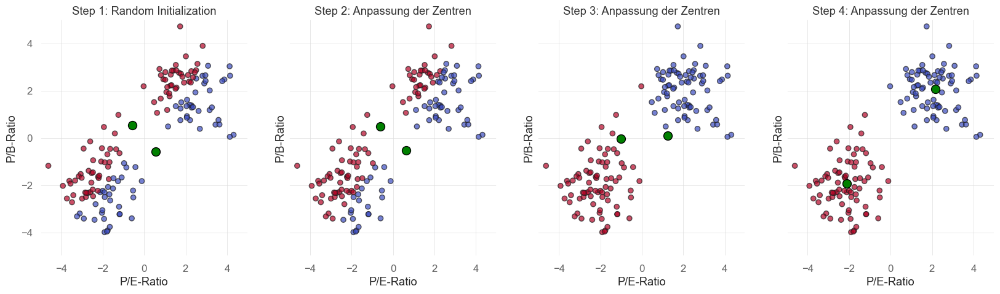

In [437]:
np.random.seed(42)
X, _ = make_blobs(n_samples=150, centers=[[-2, -2], [2, 2]], cluster_std=1.0)

def plot_kmeans_steps(X, n_clusters=2, n_steps=4):
    # Manually initialize centers within desired range
    initial_centers = np.array([[3, -3], [-3, 3]])
    kmeans = KMeans(n_clusters=n_clusters, init=initial_centers, n_init=1, max_iter=1)
    kmeans.fit(X)
    centers = [kmeans.cluster_centers_.copy()]
    pred = kmeans.predict(X)
    
    # Colors for the plots
    point_colors = ['#e377c2', '#7f7f7f']  # Lighter colors for points
    center_colors = ['#E32CC2', '#484848']  # Brighter colors for centers

    # Create plots for each step
    for i in range(n_steps):
        if i > 0:
            kmeans = KMeans(n_clusters=n_clusters, init=centers[i-1], n_init=1, max_iter=1)
            kmeans.fit(X)
            centers.append(kmeans.cluster_centers_)
            pred = kmeans.predict(X)
        
        fig = go.Figure()
        fig.add_trace(go.Scatter(
            x=X[:, 0], y=X[:, 1],
            mode='markers',
            marker=dict(color=[point_colors[j] for j in pred], size=6),
            name='Data Points'
        ))
        fig.add_trace(go.Scatter(
            x=centers[i][:, 0], y=centers[i][:, 1],
            mode='markers',
            marker=dict(color=[center_colors[j] for j in range(n_clusters)], size=12, symbol='x'),
            name='Centers'
        ))
        
        # Update plot layout
        title_text = f"Step {i+1}: Adjust Centers" if i < n_steps - 1 else "Step N: Final Centers"
        if i == 0:
            title_text = "Step 1: Random Initialization of Centroids"
        fig.update_layout(
            title=title_text,
            xaxis_title="P/E-Ratio",
            yaxis_title="P/B-Ratio",
            xaxis=dict(range=[-5, 5]),
            yaxis=dict(range=[-5, 5]),
            width=600,
            height=400,
            showlegend=True
        )
        
        fig.show()

plot_kmeans_steps(X)

In [438]:
np.random.seed(42)
centers = [[15, 15, 15], [35, 35, 35]]  # Zentren für die beiden Gruppen
X, _ = make_blobs(n_samples=150, centers=centers, cluster_std=5.0, n_features=3)  # Geringere Standardabweichung

# Extract features for different dimensions
p_b_ratio = X[:, 0]  # P/B-Ratio
p_e_ratio = X[:, 1]  # P/E-Ratio
one_y_mom = X[:, 2]  # 1YMom

# Determine threshold for grouping (e.g., a simple threshold based on P/B-Ratio)
threshold_pb = (centers[0][0] + centers[1][0]) / 2

# Group data based on the threshold of P/B-Ratio
group = np.where(p_b_ratio >= threshold_pb, 0, 1)  # Group 0 for high ratios, 1 for low ratios

# Colors for groups
colors = ['#e377c2', '#7f7f7f']

# 1D Visualization
fig_1d = go.Figure()
fig_1d.add_trace(go.Scatter(
    x=p_b_ratio,
    y=[0] * len(p_b_ratio),
    mode='markers',
    marker=dict(color=[colors[g] for g in group], size=8),
    name='P/B-Ratio'
))
fig_1d.update_layout(
    title="1D Visualization of P/B-Ratio",
    xaxis_title="P/B-Ratio",
    yaxis=dict(showticklabels=False, zeroline=False),
    xaxis=dict(range=[0, 50]),
    width=600,
    height=400
)
fig_1d.show()

# 2D Visualization
fig_2d = go.Figure()
fig_2d.add_trace(go.Scatter(
    x=p_b_ratio,
    y=p_e_ratio,
    mode='markers',
    marker=dict(color=[colors[g] for g in group], size=8),
    name='2D Space'
))
fig_2d.update_layout(
    title="2D Visualization of P/B-Ratio and P/E-Ratio",
    xaxis_title="P/B-Ratio",
    yaxis_title="P/E-Ratio",
    xaxis=dict(range=[0, 50]),
    yaxis=dict(range=[0, 50]),
    width=600,
    height=400
)
fig_2d.show()

# 3D Visualization
fig_3d = go.Figure()
fig_3d.add_trace(go.Scatter3d(
    x=p_b_ratio,
    y=p_e_ratio,
    z=one_y_mom,
    mode='markers',
    marker=dict(color=[colors[g] for g in group], size=8),
    name='3D Space'
))
fig_3d.update_layout(
    title="3D Visualization of P/B-Ratio, P/E-Ratio, and 1YMom",
    scene=dict(
        xaxis=dict(title='P/B-Ratio', range=[0, 50]),
        yaxis=dict(title='P/E-Ratio', range=[0, 50]),
        zaxis=dict(title='1YMom', range=[0, 50])
    ),
    width=600,
    height=600
)
fig_3d.show()

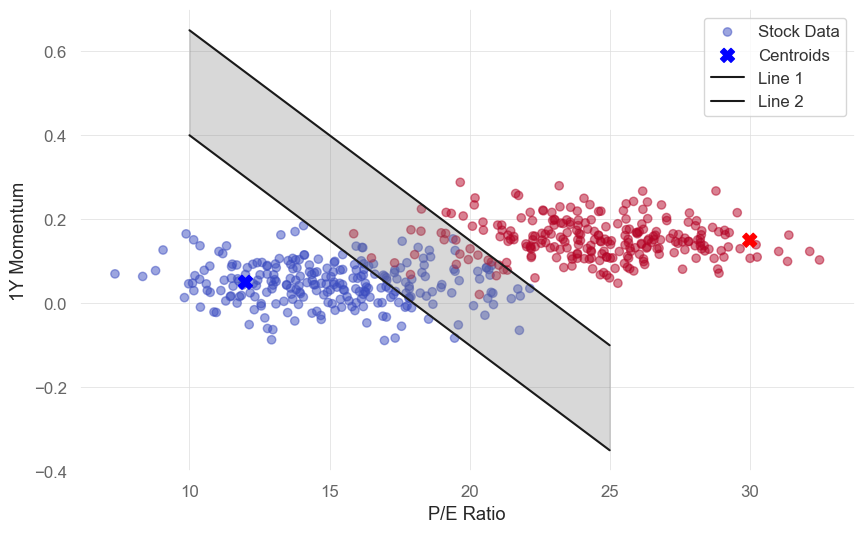

In [439]:
np.random.seed(0)

value_pe = np.random.normal(loc=15, scale=3, size=250)
value_momentum = np.random.normal(loc=0.05, scale=0.05, size=250)
growth_pe = np.random.normal(loc=25, scale=3, size=250)
growth_momentum = np.random.normal(loc=0.15, scale=0.05, size=250)

value_data = np.column_stack((value_pe, value_momentum))
growth_data = np.column_stack((growth_pe, growth_momentum))
data = np.vstack((value_data, growth_data))
labels = np.array([0] * 250 + [1] * 250)

centroid_value = [12, 0.05]
centroid_growth = [30, 0.15]

line1_start, line1_end = np.array([10, 0.4]), np.array([20, -0.1])
line2_start, line2_end = np.array([15, 0.4]), np.array([25, -0.1])

# Calculate slopes and intercepts for each line
slope1 = (line1_end[1] - line1_start[1]) / (line1_end[0] - line1_start[0])
intercept1 = line1_start[1] - slope1 * line1_start[0]
slope2 = (line2_end[1] - line2_start[1]) / (line2_end[0] - line2_start[0])
intercept2 = line2_start[1] - slope2 * line2_start[0]

# X range for plot
x_range = np.linspace(10, 25, 400)
y_line1 = slope1 * x_range + intercept1
y_line2 = slope2 * x_range + intercept2

# Correct filling between lines
plt.figure(figsize=(10, 6))
plt.scatter(data[:, 0], data[:, 1], c=labels, alpha=0.5, cmap='coolwarm', label='Stock Data')
plt.scatter([centroid_value[0], centroid_growth[0]], [centroid_value[1], centroid_growth[1]],
            c=['blue', 'red'], s=100, marker='X', label='Centroids')
plt.plot(x_range, y_line1, 'k-', label='Line 1')
plt.plot(x_range, y_line2, 'k-', label='Line 2')
plt.fill_between(x_range, y_line1, y_line2, where=(y_line1 < y_line2), color='grey', alpha=0.3)
plt.xlabel('P/E Ratio')
plt.ylabel('1Y Momentum') 
plt.legend()
plt.grid(True)
plt.show()

In [440]:

import numpy as np
import plotly.graph_objects as go

# Seed for reproducibility
np.random.seed(42)

# Generating uncorrelated data
x_uncorrelated = np.random.normal(0, 1, 100)
y_uncorrelated = np.random.normal(0, 1, 100)

# Generating correlated data
x_correlated = np.random.normal(0, 1, 100)
y_correlated = 0.8 * x_correlated + np.random.normal(0, 0.5, 100)  # Correlation factor and some noise

# Defining two points to calculate Euclidean distance
points_x = [0.5, -0.5]
points_y = [0.5, -0.5]

# Create scatter plots for both datasets
fig1 = go.Figure()
fig2 = go.Figure()

# Uncorrelated data scatter plot
fig1.add_trace(go.Scatter(x=x_uncorrelated, y=y_uncorrelated, mode='markers', name='Uncorrelated Data',
                         marker=dict(color='black')))
fig1.add_trace(go.Scatter(x=points_x, y=points_y, mode='markers+lines', name='Points & Distance',
                         marker=dict(color=['red', 'blue']), line=dict(color='magenta')))

# Correlated data scatter plot
fig2.add_trace(go.Scatter(x=x_correlated, y=y_correlated, mode='markers', name='Correlated Data',
                         marker=dict(color='black')))
fig2.add_trace(go.Scatter(x=points_x, y=points_y, mode='markers+lines', name='Points & Distance',
                         marker=dict(color=['red', 'blue']), line=dict(color='magenta')))

# Update the layout
fig1.update_layout(title="Euclidean Distance in Uncorrelated Data", xaxis_title="P/E", yaxis_title="P/B",
                   width=600, height=400)
fig2.update_layout(title="Euclidean Distance in Correlated Data", xaxis_title="P/E", yaxis_title="P/B",
                   width=600, height=400)

# Display the figures
fig1.show()
fig2.show()

### Old Code

In [ ]:
trade_log_df = pd.read_excel('simulation_results/06_Trade Log Results.xlsx')
all_dist_df = pd.read_excel('simulation_results/04_All Distances Results.xlsx')

# Convert date columns to datetime format
trade_log_df['Trade Date'] = pd.to_datetime(trade_log_df['Trade Date'])
all_dist_df['Date'] = pd.to_datetime(all_dist_df['Date'])

# Merge the dataframes on 'Instrument' and 'Trade Date'
merged_df = pd.merge(trade_log_df, all_dist_df, 
                     left_on=['Instrument', 'Trade Date'], 
                     right_on=['Instrument', 'Date'],
                     how='inner')

# Specify the columns to be retained in the final dataframe
selected_columns = [
    'Date', 'Portfolio', 'Instrument', 'Weight', 'Position', 'Price', 
    'Distance to Cluster 0', 'Distance to Cluster 1', 'Silhouette Coefficient', 
    'Distance Ratio', 'Absolute Difference', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 
    '1YMom', 'AQGR BV', 'AQGR EPS', 'AQGR Rev'
]

# Extract the relevant columns and exclude a specific date
base_data_trades = merged_df[selected_columns]
base_data_trades['Date'] = pd.to_datetime(base_data_trades['Date'])
base_data_trades = base_data_trades[base_data_trades['Date'] == '2023-12-29']

# Display the processed trade data
base_data_trades

In [ ]:
grouped = base_data_trades.groupby('Portfolio').agg({
    'Distance to Cluster 0': 'mean',
    'Distance to Cluster 1': 'mean',
    'Silhouette Coefficient': 'mean',
    'Distance Ratio': 'mean', 
    
    'P/B': 'median', 
    'P/E': 'median', 
    'P/FCF': 'median', 
    'P/Rev': 'median', 
    '1YMom': 'mean', 
    'AQGR BV': 'median', 
    'AQGR EPS': 'median', 
    'AQGR Rev': 'median'
})


grouped.columns = [
    'AVG Distance to Cluster 0', 'AVG Distance to Cluster 1',
    'AVG Silhouette Coefficient', 'AVG Distance Ratio', 'Median P/B',
    'Median P/E', 'Median P/FCF', 'Median P/Rev', 'Median 1YMom',
    'Median AQGR BV', 'Median AQGR EPS', 'Median AQGR Rev'
]

custom_order = [
    'Portfolio All',
    'Cluster 0',
    'Cluster 1',
    'Pure Cluster 0',
    'Pure Cluster 1'
]

grouped = grouped.reindex(custom_order)
#grouped.to_excel('Performance Results/01 Portfolio Overview.xlsx')
grouped

In [ ]:
# def initialize_centers(X, k):
#     n_samples = X.shape[0]
#     first_center_index = np.random.randint(0, n_samples)
#     centers = [X[first_center_index]]
#     return centers



# from sklearn.covariance import EllipticEnvelope

# def robust_create_cov_matrix(cluster_data):
#     if len(cluster_data) > 1:
#         # Erstelle ein EllipticEnvelope-Objekt mit robustem Kovarianzschätzer
#         robust_cov = EllipticEnvelope(support_fraction=1., contamination=0.1)
        
#         try:
#             # Fit das Modell zu den Daten
#             robust_cov.fit(cluster_data)
            
#             # Verwende die robuste Kovarianzmatrix
#             cov_matrix = robust_cov.covariance_
            
#             # Berechne die Inverse der Kovarianzmatrix
#             inv_cov_matrix = np.linalg.inv(cov_matrix)
#         except Exception as e:
#             print(f"Exception in covariance calculation: {e}")
#             # Fallback, falls die Kovarianzmatrix fehlerhaft ist
#             inv_cov_matrix = np.eye(cluster_data.shape[1]) * 1e-6
#     else:
#         # Fallback, wenn nicht genügend Datenpunkte vorhanden sind
#         inv_cov_matrix = np.eye(cluster_data.shape[1])
    
#     return inv_cov_matrix


# def create_cov_matrix(cluster_data):
#     # Erstellen der Kovarianzmatrix und deren Inversion
#     if len(cluster_data) > 1:
#         cov_matrix = np.cov(cluster_data, rowvar=False)
#         if np.linalg.cond(cov_matrix) > 1 / np.finfo(cov_matrix.dtype).eps:
#             cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
#         inv_cov_matrix = np.linalg.inv(cov_matrix)
#     else:
#         inv_cov_matrix = np.eye(cluster_data.shape[1])
#     return inv_cov_matrix


# def check_cluster_imbalance(labels, k, ratio):
#     # Überprüfung der Cluster-Imbalance
#     cluster_sizes = np.bincount(labels, minlength=k)
#     if np.min(cluster_sizes) < ratio * np.max(cluster_sizes):
#         return True
#     return False



# def combined_quality_score(inertia, silhouette, weights=(0.5, 0.5)):
#     # Min-Max-Normalisierung (skaliere die Scores zwischen 0 und 1)
#     scaler = MinMaxScaler()
#     scores = scaler.fit_transform([[inertia, -silhouette]])  # Beachte: Silhouette soll maximiert, Inertia minimiert werden
    
#     # Gewichtete Summe der Scores
#     combined_score = weights[0] * scores[0, 0] + weights[1] * scores[0, 1]
#     return combined_score









# def kmeans_mahalanobis(X, k=2, max_iterations=200, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
#     avg_var = None
#     max_recalcs = 200
#     n_init=300
    
#     best_score = np.inf
#     best_centroids = None
#     best_labels = None

#     recalc_iteration = 0

#     for _ in range(n_init):  # 50 Initialisierungen
#         recalc_iteration = 0
#         imbalance_detected = True

#         # 1. Initialisierung bis erfolgreich
#         while imbalance_detected and recalc_iteration < max_recalcs:
#             recalc_iteration += 1
#             imbalance_detected = False
            
#             # 1.1 Erstes Zentrum zufällig auswählen
#             centers = initialize_centers(X, k)
            
#             # 1.2 Initiale Cluster anhand der Probability rechnen. Distanz wird im ersten Durchgang mit Euklidischen Distanz gerechnet
#             for _ in range(1, k):
#                 # 1.2.1 Distanz berechnen            
#                 distances = calculate_euclidean_distances(X, centers)
#                 labels = np.argmin(distances, axis=1)

#                 # 1.2.2 Nächste Center wählen basierend auf den kumulativen Wahrscheinlichkeiten
#                 probabilities = distances**2 / np.sum(distances**2)
#                 cumulative_probabilities = np.cumsum(probabilities)
#                 r = np.random.rand()
#                 next_center_index = np.where(cumulative_probabilities >= r)[0][0]
#                 next_center = X[next_center_index]
#                 centers.append(next_center)
        
#                 new_labels = np.argmin(dist_matrix, axis=1)
#                 if np.array_equal(new_labels, labels):
#                     break
#                 labels = new_labels
#                 centers = [X[labels == clu].mean(axis=0) for clu in range(k)]

#             # 1.4 Kontrolliere Cluster-Imbalance -> sonst Neustart
#             imbalance_detected = check_cluster_imbalance(labels, k, max_cluster_imbalance_ratio)
                
            
#         # 2 Berechnung der Mahalanobis Distanzen aufgrund der akzeptable Initialisierung
#         dist_matrix = np.zeros((len(X), k))
#         VI = [create_cov_matrix(X[labels == clu]) for clu in range(k)]

#         # 3. Intertia rechnen
#         inertia_md_init = sum(mahalanobis_inertia(X[labels == clu], [centers[clu]], VI[clu]) for clu in range(k))
#         #silhouette = silhouette_score(X, labels, metric='mahalanobis')
#         #quality_score = combined_quality_score(inertia_md_init, silhouette)
        
        
#         # 4. Für alle Initialisierungen: Was ist die Beste?
#         if inertia_md_init < best_score:
#             best_score = inertia_md_init
#             best_centroids = centers
#             best_labels = labels

#     # Aufgrund bester Initialisierung, die Konvergenz suchen -> lokales Minimum
#     current_centroids = best_centroids
#     labels = best_labels
#     for iteration in range(max_iterations): 
#         VI = [create_cov_matrix(X[labels == clu]) for clu in range(k)]
#         dist_matrix = np.array([[np.dot(np.dot((x - center), VI[clu]), (x - center).T) for clu, center in enumerate(current_centroids)] for x in X])
#         new_labels = np.argmin(dist_matrix, axis=1)
        
#         if np.array_equal(new_labels, labels):
#             break
#         labels = new_labels
#         current_centroids = [X[labels == clu].mean(axis=0) for clu in range(k)]
        
#         if check_cluster_imbalance(labels, k, max_cluster_imbalance_ratio):
#             print('imbalaanaaaace')
#             continue
   
#     centroids_df = pd.DataFrame(current_centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(current_centroids, columns=columns_x)
#         avg_var = 0.0

#     if len(np.unique(labels)) >= 2:
#         inertia_md_final = sum(mahalanobis_inertia(X[labels == clu], [current_centroids[clu]], VI[clu]) for clu in range(k))
#         inertia_euk_final = calculate_euclidean_inertia(X, current_centroids, labels)
#         silhouette_avg = silhouette_score(X, labels, metric='mahalanobis')
#     else:
#         inertia_md_final = None
#         inertia_euk_final = None
#         silhouette_avg = None
        
#     cluster_counts = np.bincount(labels, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})

#     return labels, dist_matrix, centroids_df, inertia_md_final, inertia_euk_final, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected        













# ## Eigenentwicklung neu
# def mahalanobis_inertia(X, centroids, VI):
#     total_inertia = 0
#     for x in X:
#         distances = [mahalanobis(x, cent, VI) ** 2 for cent in centroids]
#         total_inertia += min(distances)
#     return total_inertia



# def kmeans_mahalanobis(X, k=2, max_iterations=100, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
#     avg_var = None
#     max_recalcs = 50
    
#     best_score = np.inf
#     best_centroids = None
#     best_labels = None

#     for _ in range(20):  # 50 Initialisierungen mit K-Means++
#         recalc_iteration = 0
#         imbalance_detected = True

#         # Initialisieren mit K-Means++ bis Centroiden gefunden wurden, welche keine Imbalance von 0.2 haben:
#         while imbalance_detected and recalc_iteration < max_recalcs:
#             recalc_iteration += 1
#             imbalance_detected = False  

#             kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=1, n_init=1)
#             kmeans.fit(X)
#             centroids = kmeans.cluster_centers_
#             P = kmeans.labels_
            
#             cluster_sizes = np.bincount(P, minlength=k)
#             min_size = np.min(cluster_sizes)
#             max_size = np.max(cluster_sizes)

#             if min_size < max_cluster_imbalance_ratio * max_size:
#                 print(f"Cluster-Imbalance zu hoch: Min = {min_size}, Max = {max_size}")
#                 imbalance_detected = True  
            
#         if recalc_iteration == max_recalcs:
#             print("Maximum number of recalculations reached without meeting criteria.")

#         #print('Init Try: '+str(recalc_iteration))

#         for iteration in range(1, max_iterations + 1): 
#             dist_matrix = np.zeros((len(X), k))
#             for idx, x in enumerate(X):
#                 for clu in range(k):
#                     try:
#                         cov_matrix = np.cov(X[P == clu], rowvar=False)
#                         if is_almost_singular(cov_matrix): # Regularisierung, wenn die Kovarianzmatrix nahezu singulär ist
#                             cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6 # Regularisierung mit einem kleinen Wert epsilon
#                         VI = np.linalg.inv(cov_matrix)
#                         dist_matrix[idx, clu] = distance.mahalanobis(x, centroids[clu], VI)
#                     except np.linalg.LinAlgError:
#                         print(f"Kovarianzmatrix für Cluster {clu} ist singulär oder leer in Iteration {iteration}.")
#                         continue 

#             tmp = np.argmin(dist_matrix, axis=1)
#             changes = np.sum(P != tmp)
#             if changes == 0 and iteration > 1:  
#                 break
#             P = tmp
#             centroids = np.array([X[P == i].mean(axis=0) for i in range(k)])

#         # Überprüfe die Cluster-Imbalance
#         cluster_sizes = np.bincount(P, minlength=k)
#         min_size = np.min(cluster_sizes)
#         max_size = np.max(cluster_sizes)
#         if min_size < max_cluster_imbalance_ratio * max_size:
#             continue  # Überspringe, wenn die Imbalance zu hoch ist

#         inertia = mahalanobis_inertia(X, centroids, VI)
#         if inertia < best_score:
#             best_score = inertia
#             best_centroids = centroids
#             best_labels = P
#         #print('Inertia: '+str(inertia))

#     centroids = best_centroids
#     P = best_labels
#     print('Best Inertia: '+str(inertia))
        
#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(centroids, columns=columns_x)
#         avg_var = 0.0

#     if len(np.unique(P)) >= 2:
#         inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#         silhouette_avg = silhouette_score(X, P, metric='mahalanobis')
#     else:
#         inertia = None
#         silhouette_avg = None
        
#     cluster_counts = np.bincount(P, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})

#     print('Anzahl MD Iterationen: '+str(iteration))

#     return P, dist_matrix, centroids_df, inertia, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected










# ## Alte Hauptversion

# def kmeans_mahalanobis(X, k=2, max_iterations=100, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
#     avg_var = None
#     imbalance_detected = False
    
#     kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=1, n_init=1) # Das muss hier auf 1 bleiben -> da ich Konvergenz in der Schlaufe mit Mahalanobis mache
#     kmeans.fit(X)
#     centroids = kmeans.cluster_centers_
#     P = kmeans.labels_
        
#     # Überprüfen der Validität der Zentroide und Labels
#     if centroids is None or P is None or len(np.unique(P)) < k:
#         raise ValueError("Ungültige Initialisierung der Clusterzentren oder Labels.")


#     for iteration in range(1, max_iterations + 1): 
#         dist_matrix = np.zeros((len(X), k))
#         for idx, x in enumerate(X):
#             for clu in range(k):
#                 try:
#                     # Berechnen der Kovarianzmatrix für den aktuellen Cluster
#                     cov_matrix = np.cov(X[P == clu], rowvar=False)
#                     if np.isnan(X).any():
#                         print("NaN in X gefunden.")
#                     if np.isnan(P).any():
#                         print("NaN in P gefunden.")

#                     # Regularisierung, wenn die Kovarianzmatrix nahezu singulär ist
#                     if is_almost_singular(cov_matrix):
#                         # Regularisierung mit einem kleinen Wert epsilon
#                         cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
#                     VI = np.linalg.inv(cov_matrix)
#                     dist_matrix[idx, clu] = distance.mahalanobis(x, centroids[clu], VI)
#                 except np.linalg.LinAlgError:
#                     print(f"Kovarianzmatrix für Cluster {clu} ist singulär oder leer in Iteration {iteration}.")
#                     continue 

#         tmp = np.argmin(dist_matrix, axis=1)
#         changes = np.sum(P != tmp)
#         if changes == 0 and iteration > 1:  
#             break
#         P = tmp

#         cluster_sizes = np.bincount(P, minlength=k)
#         min_size = np.min(cluster_sizes)
#         max_size = np.max(cluster_sizes)

#         if min_size < max_cluster_imbalance_ratio * max_size:
#             print(f"Cluster-Imbalance zu hoch: Min = {min_size}, Max = {max_size}")
#             imbalance_detected = True  # Setzen der Imbalance-Variable
#             break 

#         # Aktualisierung der Zentroide
#         centroids = np.array([X[P == i].mean(axis=0) for i in range(k)])

        
#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(centroids, columns=columns_x)
#         avg_var = 0.0

#     if len(np.unique(P)) >= 2:
#         inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#         silhouette_avg = silhouette_score(X, P, metric='mahalanobis')
#     else:
#         inertia = None
#         silhouette_avg = None
        
#     cluster_counts = np.bincount(P, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})

#     print(iteration)
    
#     return P, dist_matrix, centroids_df, inertia, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected









# # Eigenentwicklung mit Mahalanobis Inertia und K-Means++
# def kmeans_mahalanobis(X, k=2, max_iterations=100, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
#     avg_var = None
#     imbalance_detected = False

#     # Initialisiere die Kovarianzmatrix für die Mahalanobis Distanz basierend auf dem gesamten Datensatz
#     cov_matrix = np.cov(X, rowvar=False) + np.eye(X.shape[1]) * 1e-6  # Regularisierung hinzugefügt
#     VI = np.linalg.inv(cov_matrix)

#     # Funktion zur Berechnung der Mahalanobis-Inertia
#     def mahalanobis_inertia(X, centroids):
#         total_inertia = 0
#         for x in X:
#             distances = [mahalanobis(x, cent, VI) ** 2 for cent in centroids]
#             total_inertia += min(distances)
#         return total_inertia

#     # Bester Inertia-Wert und beste Zentroide speichern
#     best_score = np.inf
#     best_centroids = None
#     best_labels = None

#     for _ in range(30):  # 50 Initialisierungen mit K-Means++
#         kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=1, n_init=1)
#         kmeans.fit(X)
#         centroids = kmeans.cluster_centers_
#         labels = kmeans.labels_
#         inertia = mahalanobis_inertia(X, centroids)
#         #print('Inertia: '+str(inertia))
#         silhouette = silhouette_score(X, labels, metric='mahalanobis')
        
#         # Überprüfe die Cluster-Imbalance
#         cluster_sizes = np.bincount(labels, minlength=k)
#         min_size = np.min(cluster_sizes)
#         max_size = np.max(cluster_sizes)
#         if min_size < max_cluster_imbalance_ratio * max_size:
#             continue  # Überspringe, wenn die Imbalance zu hoch ist

#         if inertia < best_score:
#             best_score = inertia
#             best_centroids = centroids
#             best_labels = labels

#     centroids = best_centroids
#     P = best_labels
            
#     # Überprüfen der Validität der Zentroide und Labels
#     if centroids is None or P is None or len(np.unique(P)) < k:
#         raise ValueError("Ungültige Initialisierung der Clusterzentren oder Labels.")


#     for iteration in range(1, max_iterations + 1): 
#         dist_matrix = np.zeros((len(X), k))
#         for idx, x in enumerate(X):
#             for clu in range(k):
#                 try:
#                     # Berechnen der Kovarianzmatrix für den aktuellen Cluster
#                     cov_matrix = np.cov(X[P == clu], rowvar=False)
#                     if np.isnan(X).any():
#                         print("NaN in X gefunden.")
#                     if np.isnan(P).any():
#                         print("NaN in P gefunden.")

#                     # Regularisierung, wenn die Kovarianzmatrix nahezu singulär ist
#                     if is_almost_singular(cov_matrix):
#                         # Regularisierung mit einem kleinen Wert epsilon
#                         cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
#                     VI = np.linalg.inv(cov_matrix)
#                     dist_matrix[idx, clu] = distance.mahalanobis(x, centroids[clu], VI)
#                 except np.linalg.LinAlgError:
#                     print(f"Kovarianzmatrix für Cluster {clu} ist singulär oder leer in Iteration {iteration}.")
#                     continue 

#         tmp = np.argmin(dist_matrix, axis=1)
#         changes = np.sum(P != tmp)
#         if changes == 0 and iteration > 1:  
#             break
#         P = tmp

#         cluster_sizes = np.bincount(P, minlength=k)
#         min_size = np.min(cluster_sizes)
#         max_size = np.max(cluster_sizes)

#         if min_size < max_cluster_imbalance_ratio * max_size:
#             print(f"Cluster-Imbalance zu hoch: Min = {min_size}, Max = {max_size}")
#             imbalance_detected = True  # Setzen der Imbalance-Variable
#             break 

#         # Aktualisierung der Zentroide
#         centroids = np.array([X[P == i].mean(axis=0) for i in range(k)])

        
#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(centroids, columns=columns_x)
#         avg_var = 0.0

#     if len(np.unique(P)) >= 2:
#         inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#         silhouette_avg = silhouette_score(X, P, metric='mahalanobis')
#     else:
#         inertia = None
#         silhouette_avg = None
        
#     cluster_counts = np.bincount(P, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})
    
#     return P, dist_matrix, centroids_df, inertia, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected



# def initialize_maximin(X, k):
#     # Wähle das erste Zentrum zufällig
#     first_center_index = np.random.choice(range(len(X)))
#     first_center = X[first_center_index]

#     # Berechne die Distanzen von allen Punkten zum ersten Zentrum
#     distances = cdist(X, [first_center], metric='euclidean').flatten()

#     # Finde das zweite Zentrum, das die maximale Distanz zum ersten Zentrum hat
#     second_center_index = np.argmax(distances)
#     second_center = X[second_center_index]

#     # Initialisiere K-Means mit den gefundenen Zentren, wenn k = 2
#     if k == 2:
#         initial_centers = np.array([first_center, second_center])
#     else:
#         raise ValueError("Maximin initialization currently supports only k=2.")

#     return initial_centers





# ## mit Maximin Init

# def kmeans_mahalanobis(X, k=2, max_iterations=30, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
#     avg_var = None
#     imbalance_detected = False

#     if initial_centroids is None:
#         initial_centroids = initialize_maximin(X, k)

#     # Führe K-Means mit den initialen Zentren durch
#     kmeans = KMeans(n_clusters=k, init=initial_centroids, max_iter=1, n_init=1, algorithm='elkan')
#     kmeans.fit(X)
#     centroids = kmeans.cluster_centers_
#     P = kmeans.labels_


#     # Überprüfen der Validität der Zentroide und Labels
#     if centroids is None or P is None or len(np.unique(P)) < k:
#         raise ValueError("Ungültige Initialisierung der Clusterzentren oder Labels.")


#     for iteration in range(1, max_iterations + 1): 
#         dist_matrix = np.zeros((len(X), k))
#         for idx, x in enumerate(X):
#             for clu in range(k):
#                 try:
#                     # Berechnen der Kovarianzmatrix für den aktuellen Cluster
#                     cov_matrix = np.cov(X[P == clu], rowvar=False)
#                     if np.isnan(X).any():
#                         print("NaN in X gefunden.")
#                     if np.isnan(P).any():
#                         print("NaN in P gefunden.")

#                     # Regularisierung, wenn die Kovarianzmatrix nahezu singulär ist
#                     if is_almost_singular(cov_matrix):
#                         # Regularisierung mit einem kleinen Wert epsilon
#                         cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
#                     VI = np.linalg.inv(cov_matrix)
#                     dist_matrix[idx, clu] = distance.mahalanobis(x, centroids[clu], VI)
#                 except np.linalg.LinAlgError:
#                     print(f"Kovarianzmatrix für Cluster {clu} ist singulär oder leer in Iteration {iteration}.")
#                     continue 

#         tmp = np.argmin(dist_matrix, axis=1)
#         changes = np.sum(P != tmp)
#         if changes == 0 and iteration > 1:  
#             break
#         P = tmp

#         cluster_sizes = np.bincount(P, minlength=k)
#         min_size = np.min(cluster_sizes)
#         max_size = np.max(cluster_sizes)

#         if min_size < max_cluster_imbalance_ratio * max_size:
#             print(f"Cluster-Imbalance zu hoch: Min = {min_size}, Max = {max_size}")
#             imbalance_detected = True  # Setzen der Imbalance-Variable
#             break 

#         # Aktualisierung der Zentroide
#         centroids = np.array([X[P == i].mean(axis=0) for i in range(k)])

        
#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(centroids, columns=columns_x)
#         avg_var = 0.0

#     if len(np.unique(P)) >= 2:
#         inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#         silhouette_avg = silhouette_score(X, P, metric='mahalanobis')
#     else:
#         inertia = None
#         silhouette_avg = None
        
#     cluster_counts = np.bincount(P, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})
    
#     return P, dist_matrix, centroids_df, inertia, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected







# ## Alte Hauptversion

# def kmeans_mahalanobis(X, k=2, max_iterations=30, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
#     avg_var = None
#     imbalance_detected = False

#     kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=1, n_init=30) # Das muss hier auf 1 bleiben -> da ich Konvergenz in der Schlaufe mit Mahalanobis mache
#     kmeans.fit(X)
#     centroids = kmeans.cluster_centers_
#     P = kmeans.labels_
        
#     # Überprüfen der Validität der Zentroide und Labels
#     if centroids is None or P is None or len(np.unique(P)) < k:
#         raise ValueError("Ungültige Initialisierung der Clusterzentren oder Labels.")


#     for iteration in range(1, max_iterations + 1): 
#         dist_matrix = np.zeros((len(X), k))
#         for idx, x in enumerate(X):
#             for clu in range(k):
#                 try:
#                     # Berechnen der Kovarianzmatrix für den aktuellen Cluster
#                     cov_matrix = np.cov(X[P == clu], rowvar=False)
#                     if np.isnan(X).any():
#                         print("NaN in X gefunden.")
#                     if np.isnan(P).any():
#                         print("NaN in P gefunden.")

#                     # Regularisierung, wenn die Kovarianzmatrix nahezu singulär ist
#                     if is_almost_singular(cov_matrix):
#                         # Regularisierung mit einem kleinen Wert epsilon
#                         cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
#                     VI = np.linalg.inv(cov_matrix)
#                     dist_matrix[idx, clu] = distance.mahalanobis(x, centroids[clu], VI)
#                 except np.linalg.LinAlgError:
#                     print(f"Kovarianzmatrix für Cluster {clu} ist singulär oder leer in Iteration {iteration}.")
#                     continue 

#         tmp = np.argmin(dist_matrix, axis=1)
#         changes = np.sum(P != tmp)
#         if changes == 0 and iteration > 1:  
#             break
#         P = tmp

#         cluster_sizes = np.bincount(P, minlength=k)
#         min_size = np.min(cluster_sizes)
#         max_size = np.max(cluster_sizes)

#         if min_size < max_cluster_imbalance_ratio * max_size:
#             print(f"Cluster-Imbalance zu hoch: Min = {min_size}, Max = {max_size}")
#             imbalance_detected = True  # Setzen der Imbalance-Variable
#             break 

#         # Aktualisierung der Zentroide
#         centroids = np.array([X[P == i].mean(axis=0) for i in range(k)])

        
#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(centroids, columns=columns_x)
#         avg_var = 0.0

#     if len(np.unique(P)) >= 2:
#         inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#         silhouette_avg = silhouette_score(X, P, metric='mahalanobis')
#     else:
#         inertia = None
#         silhouette_avg = None
        
#     cluster_counts = np.bincount(P, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})
    
#     return P, dist_matrix, centroids_df, inertia, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected






#Nelson alt

# from scipy.stats import chi2
# from numpy.linalg import inv, LinAlgError


# def select_initial_centroids(X, k, w):
#     n = len(X)
#     distances = np.array([sum(sorted([np.linalg.norm(x-y) for y in X if not np.array_equal(x, y)])[:w]) for x in X])
#     sorted_indices = np.argsort(distances)
#     weights = np.array([(n-i)**2 for i in range(n)])
#     probabilities = weights[sorted_indices] / weights[sorted_indices].sum()
#     centroids_indices = np.random.choice(sorted_indices, size=k, replace=False, p=probabilities)
#     return X[centroids_indices], centroids_indices

# def remove_neighbors_from_selection(X, indices, w):
#     remaining_indices = set(range(len(X)))
#     for idx in indices:
#         neighbors = np.argsort([np.linalg.norm(X[idx] - y) for y in X])[:w]
#         remaining_indices -= set(neighbors)
#     return X[list(remaining_indices)]


# Nelson

# def is_singular(matrix):
#     """Prüft, ob eine Matrix singulär ist."""
#     return np.linalg.cond(matrix) > 1 / np.finfo(matrix.dtype).eps


# def initialize_clusters(X, k, w):
#     """Initialisiert Clusterzentren durch das Entfernen der nächsten Nachbarn jedes Zentrums."""
#     n = X.shape[0]
#     indices = np.random.permutation(n)
#     clusters = []

#     for i in range(k):
#         center_idx = indices[0]
#         center = X[center_idx]
#         distances = np.linalg.norm(X - center, axis=1)
#         nearest_indices = np.argsort(distances)[:w]
        
#         clusters.append(X[nearest_indices])
#         indices = np.setdiff1d(indices, nearest_indices)

#     return clusters

# def refine_clusters(X, clusters):
#     """Verfeinert Cluster durch Erweiterung um Punkte innerhalb des 95% Konfidenzellipsoids."""
#     p = X.shape[1]
#     threshold = chi2.ppf(0.50, p)
#     refined_clusters = []

#     for points in clusters:
#         while True:
#             mu = np.mean(points, axis=0)
#             sigma = np.cov(points, rowvar=False)
#             try:
#                 sigma_inv = inv(sigma)
#                 mahalanobis_dist = np.array([(x - mu) @ sigma_inv @ (x - mu) for x in X])
#                 new_points = X[mahalanobis_dist <= threshold]
#                 if len(new_points) == len(points):
#                     break
#                 points = new_points
#             except LinAlgError:
#                 sigma += np.eye(p) * 1e-10
#                 continue
        
#         refined_clusters.append(points)

#     return refined_clusters

# def assign_remaining_points(X, clusters):
#     """Weist die verbleibenden Punkte den Clustern zu, basierend auf der Mahalanobis-Distanz."""
#     used_points = np.vstack(clusters)
#     remaining_points = np.array([x for x in X if x.tolist() not in used_points.tolist()])

#     for point in remaining_points:
#         min_distance = np.inf
#         closest_cluster_idx = None

#         for idx, cluster in enumerate(clusters):
#             mu = np.mean(cluster, axis=0)
#             sigma = np.cov(cluster, rowvar=False)
#             if is_singular(sigma):
#                 sigma += np.eye(sigma.shape[0]) * 1e-10
#             sigma_inv = inv(sigma)
#             distance = (point - mu).T @ sigma_inv @ (point - mu)

#             if distance < min_distance:
#                 min_distance = distance
#                 closest_cluster_idx = idx

#         clusters[closest_cluster_idx] = np.vstack([clusters[closest_cluster_idx], point])

#     return clusters



# Nelson
# def kmeans_mahalanobis(X, k=2, max_iterations=30, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
#     w = 30  # Anzahl der nächsten Nachbarn zur Bildung des initialen Clusters

#     # Initialisiere und verfeinere Cluster
#     initial_clusters = initialize_clusters(X, k, w)
#     print(len(initial_clusters))
#     refined_clusters = refine_clusters(X, initial_clusters)
#     print(refined_clusters)
#     final_clusters = initial_clusters
#     #final_clusters = assign_remaining_points(X, refined_clusters)

#     # Konvertiere Clusterlisten in ein Array für die Verarbeitung und extrahiere Labels
#     cluster_labels = np.zeros(len(X))
#     for idx, cluster in enumerate(final_clusters):
#         for point in cluster:
#             point_idx = np.where((X == point).all(axis=1))[0][0]
#             cluster_labels[point_idx] = idx

#     # Berechne Zentroide und Distanzmatrix basierend auf den verfeinerten Clustern
#     centroids = np.array([np.mean(cluster, axis=0) for cluster in final_clusters])
#     dist_matrix = np.zeros((len(X), k))
#     for idx, x in enumerate(X):
#         for clu, centroid in enumerate(centroids):
#             cov_matrix = np.cov(final_clusters[clu], rowvar=False)
#             if is_almost_singular(cov_matrix):
#                 cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
#             VI = np.linalg.inv(cov_matrix)
#             dist_matrix[idx, clu] = distance.mahalanobis(x, centroid, VI)

#     # Clustergrößen und Imbalance prüfen
#     cluster_sizes = np.bincount(cluster_labels.astype(int), minlength=k)
#     min_size = np.min(cluster_sizes)
#     max_size = np.max(cluster_sizes)
#     if min_size < max_cluster_imbalance_ratio * max_size:
#         print(f"Cluster-Imbalance zu hoch: Min = {min_size}, Max = {max_size}")
#         imbalance_detected = True
#     else:
#         imbalance_detected = False

#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(centroids, columns=columns_x)
#         avg_var = 0.0

#     # Zusätzliche Metriken berechnen
#     inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#     if len(np.unique(cluster_labels)) >= 2:
#         silhouette_avg = silhouette_score(X, cluster_labels, metric='mahalanobis')
#     else:
#         silhouette_avg = None

#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_sizes})
#     iteration = 1

#     return cluster_labels, dist_matrix, centroids_df, inertia, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected







# def kmeans_mahalanobis(X, k=2, max_iterations=30, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None):
#     avg_var = None
#     imbalance_detected = False

#     # Initialisiere die Kovarianzmatrix für die Mahalanobis Distanz basierend auf dem gesamten Datensatz
#     cov_matrix = np.cov(X, rowvar=False) + np.eye(X.shape[1]) * 1e-6  # Regularisierung hinzugefügt
#     VI = np.linalg.inv(cov_matrix)

#     # Funktion zur Berechnung der Mahalanobis-Inertia
#     def mahalanobis_inertia(X, centroids):
#         total_inertia = 0
#         for x in X:
#             distances = [mahalanobis(x, cent, VI) ** 2 for cent in centroids]
#             total_inertia += min(distances)
#         return total_inertia

#     # Bester Inertia-Wert und beste Zentroide speichern
#     best_score = np.inf
#     best_centroids = None
#     best_labels = None

#     for _ in range(100):  # 50 Initialisierungen mit K-Means++
#         kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=1, n_init=1)
#         kmeans.fit(X)
#         centroids = kmeans.cluster_centers_
#         labels = kmeans.labels_
#         inertia = mahalanobis_inertia(X, centroids)
#         #print('Inertia: '+str(inertia))
#         silhouette = silhouette_score(X, labels, metric='mahalanobis')
#         #print('Silhouette: '+str(silhouette))
#         # Berechne den gewichteten Score, z.B. eine Kombination aus Inertia und Silhouette
#         # Hier: Je niedriger die Inertia und je höher der Silhouette-Score, desto besser
#         score = inertia - silhouette  # Gewichtung anpassen je nach Bedarf
#         #print('Score: '+str(score))

#         # Überprüfe die Cluster-Imbalance
#         cluster_sizes = np.bincount(labels, minlength=k)
#         min_size = np.min(cluster_sizes)
#         max_size = np.max(cluster_sizes)
#         if min_size < max_cluster_imbalance_ratio * max_size:
#             continue  # Überspringe, wenn die Imbalance zu hoch ist

#         if inertia < best_score:
#             best_score = inertia
#             best_centroids = centroids
#             best_labels = labels

#     centroids = best_centroids
#     P = best_labels
            
#     # Überprüfen der Validität der Zentroide und Labels
#     if centroids is None or P is None or len(np.unique(P)) < k:
#         raise ValueError("Ungültige Initialisierung der Clusterzentren oder Labels.")


#     for iteration in range(1, max_iterations + 1): 
#         dist_matrix = np.zeros((len(X), k))
#         for idx, x in enumerate(X):
#             for clu in range(k):
#                 try:
#                     # Berechnen der Kovarianzmatrix für den aktuellen Cluster
#                     cov_matrix = np.cov(X[P == clu], rowvar=False)
#                     if np.isnan(X).any():
#                         print("NaN in X gefunden.")
#                     if np.isnan(P).any():
#                         print("NaN in P gefunden.")

#                     # Regularisierung, wenn die Kovarianzmatrix nahezu singulär ist
#                     if is_almost_singular(cov_matrix):
#                         # Regularisierung mit einem kleinen Wert epsilon
#                         cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
#                     VI = np.linalg.inv(cov_matrix)
#                     dist_matrix[idx, clu] = distance.mahalanobis(x, centroids[clu], VI)
#                 except np.linalg.LinAlgError:
#                     print(f"Kovarianzmatrix für Cluster {clu} ist singulär oder leer in Iteration {iteration}.")
#                     continue 

#         tmp = np.argmin(dist_matrix, axis=1)
#         changes = np.sum(P != tmp)
#         if changes == 0 and iteration > 1:  
#             break
#         P = tmp

#         cluster_sizes = np.bincount(P, minlength=k)
#         min_size = np.min(cluster_sizes)
#         max_size = np.max(cluster_sizes)

#         if min_size < max_cluster_imbalance_ratio * max_size:
#             print(f"Cluster-Imbalance zu hoch: Min = {min_size}, Max = {max_size}")
#             imbalance_detected = True  # Setzen der Imbalance-Variable
#             break 

#         # Aktualisierung der Zentroide
#         centroids = np.array([X[P == i].mean(axis=0) for i in range(k)])

        
#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(centroids, columns=columns_x)
#         avg_var = 0.0

#     if len(np.unique(P)) >= 2:
#         inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#         silhouette_avg = silhouette_score(X, P, metric='mahalanobis')
#     else:
#         inertia = None
#         silhouette_avg = None
        
#     cluster_counts = np.bincount(P, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})
    
#     return P, dist_matrix, centroids_df, inertia, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected






# from scipy.linalg import pinv

# def kmeans_mahalanobis(X, k=2, max_iterations=30, columns_x=None, max_cluster_imbalance_ratio=None):
#     best_score = -1
#     best_labels = None
#     best_centroids = None
#     best_iteration = None
#     best_inertia = None
#     best_silhouette = -1

#     for init in range(50):  # 50 wiederholte Initialisierungen
#         kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=1, n_init=1)
#         kmeans.fit(X)
#         centroids = kmeans.cluster_centers_
#         P = kmeans.labels_
#         print(init)
#         for iteration in range(1, max_iterations + 1):
#             dist_matrix = np.zeros((len(X), k))
#             for idx, x in enumerate(X):
#                 for clu in range(k):
#                     try:
#                         cov_matrix = np.cov(X[P == clu], rowvar=False)
#                         # Regularisierung, wenn die Kovarianzmatrix nahezu singulär ist
#                         if np.linalg.cond(cov_matrix) > 1e10:  # Konditionszahl als Schwellwert
#                             cov_matrix += np.eye(cov_matrix.shape[0]) * 1e-6
#                         VI = pinv(cov_matrix)  # Verwendung der Pseudoinverse für Stabilität
#                         dist_matrix[idx, clu] = distance.mahalanobis(x, centroids[clu], VI)
#                     except np.linalg.LinAlgError:
#                         print(f"Kovarianzmatrix für Cluster {clu} ist singulär oder leer in Iteration {iteration}.")
#                         continue

#             new_labels = np.argmin(dist_matrix, axis=1)
#             if np.array_equal(P, new_labels):
#                 break
#             P = new_labels
#             centroids = np.array([X[P == i].mean(axis=0) for i in range(k)])

#         inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#         silhouette_avg = silhouette_score(X, P, metric='mahalanobis') if len(set(P)) > 1 else -1

#         if silhouette_avg > best_silhouette:  # Besseren Silhouette-Score als Auswahlkriterium verwenden
#             best_labels = P.copy()
#             best_centroids = centroids.copy()
#             best_iteration = iteration
#             best_inertia = inertia
#             best_silhouette = silhouette_avg

#     centroids_df = pd.DataFrame(best_centroids, columns=columns_x)
#     cluster_counts = np.bincount(best_labels, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})

#     return best_labels, dist_matrix, centroids_df, best_inertia, cluster_counts_df, best_iteration, best_silhouette, None, False





# def initialize_centroids(X, k, w):
#     # Berechnung der Summe der Distanzen zu den nächsten w Nachbarn für jeden Punkt
#     distances = distance.cdist(X, X, 'euclidean')
#     sorted_distances = np.sort(distances, axis=1)
#     nearest_distances = sorted_distances[:, 1:w+1]
#     cumulative_distances = np.sum(nearest_distances, axis=1)
#     # Auswahl der k Punkte mit den geringsten kumulativen Distanzen als initiale Zentren
#     initial_centroid_indices = np.argpartition(cumulative_distances, k)[:k]
#     return X[initial_centroid_indices]





# def kmeans_mahalanobis(X, k=2, max_iterations=30, initial_centroids=None, initial_labels=None, columns_x=None, max_cluster_imbalance_ratio=None ,w=5):
#     avg_var = None
#     imbalance_detected = False
#     n_samples, n_features = X.shape


#     kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=1, n_init=30)
#     kmeans.fit(X)
#     centroids = kmeans.cluster_centers_
#     P = kmeans.labels_

#     # Überprüfen der Validität der Zentroide und Labels
#     if centroids is None or P is None or len(np.unique(P)) < k:
#         raise ValueError("Ungültige Initialisierung der Clusterzentren oder Labels.")

    
#     for iteration in range(max_iterations):
#         # Euklidische Distanzen für die erste Iteration, danach Mahalanobis
#         if iteration == 0:
#             # Erste Runde mit euklidischen Distanzen
#             dist_matrix = distance.cdist(X, centroids, 'euclidean')
#         else:
#             # Berechnung der Mahalanobis-Distanzmatrix
#             dist_matrix = np.zeros((n_samples, k))
#             for clu in range(k):
#                 cluster_points = X[P == clu]
#                 if len(cluster_points) < w:
#                     continue  # Zu wenige Punkte für eine valide Kovarianzmatrix
#                 cov_matrix = np.cov(cluster_points, rowvar=False)
#                 VI = np.linalg.inv(cov_matrix + np.eye(n_features) * 1e-6)
#                 for idx, x in enumerate(X):
#                     dist_matrix[idx, clu] = distance.mahalanobis(x, centroids[clu], VI)

#         # Cluster-Zuweisung mit Wahrscheinlichkeitskriterium
#         new_labels = np.argmin(dist_matrix, axis=1)
#         if iteration > 0:
#             # Dynamische Anpassung mit Chi-Quadrat-Kriterium
#             for i in range(n_samples):
#                 for clu in range(k):
#                     threshold = chi2.ppf(0.95, df=n_features)  # 95% Konfidenzniveau
#                     if dist_matrix[i, clu] < threshold:
#                         new_labels[i] = clu

#         # Prüfen auf Konvergenz
#         if np.array_equal(P, new_labels):
#             break
#         P = new_labels
#         centroids = np.array([X[P == i].mean(axis=0) for i in range(k) if np.any(P == i)])


        
#     centroids_df = pd.DataFrame(centroids, columns=columns_x)
#     if initial_centroids is not None:
#         centroid_diff = abs(centroids_df - initial_centroids)
#         avg_var = centroid_diff.mean(axis=1).mean()
#         #print('AVG Var of Matrix: '+str(avgvar))
        
#     else:
#         centroids_df = pd.DataFrame(centroids, columns=columns_x)
#         avg_var = 0.0

#     if len(np.unique(P)) >= 2:
#         inertia = np.sum(np.min(dist_matrix ** 2, axis=1))
#         silhouette_avg = silhouette_score(X, P, metric='mahalanobis')
#     else:
#         inertia = None
#         silhouette_avg = None
        
#     cluster_counts = np.bincount(P, minlength=k)
#     cluster_counts_df = pd.DataFrame({'Cluster ID': range(k), 'Count': cluster_counts})
    
#     return P, dist_matrix, centroids_df, inertia, cluster_counts_df, iteration, silhouette_avg, avg_var, imbalance_detected



In [ ]:
# #columns_x = ['1YMom', '24MA BV 1YGR', '24MA EPS 1YGR', '24MA Rev 1YGR', 'P/B', 'P/E', 'P/FCF', 'P/Rev']
# columns_x = ['P/B', 'P/E', 'P/FCF', 'P/Rev']
# #columns_x = ['1YMom', '24MA BV 1YGR', '24MA EPS 1YGR', '24MA Rev 1YGR']
# k = 2
# all_distances_dfs = []
# all_centroids_dfs = []
# cluster_stats_dfs = []
# topnC0_dfs = [] 
# topnC1_dfs = [] 
# n = 20
# initial_centroids = None
# initial_labels = None
# avg_var = float('inf')
# max_avgvar_threshold = 0.5
# max_recalcs = 20

# start_date = dt.strptime('2008-03-01', '%Y-%m-%d').date()
# end_date = dt.strptime('2023-12-29', '%Y-%m-%d').date()
# trading_dates = [date for date in quarter_end_dates_list if start_date <= date <= end_date]
# trading_dates.sort()
# iteration_id = 0


# for date in trading_dates:
#     print('Analysis Date: ' + date.strftime('%Y-%m-%d'))
#     cluster_data = fin_data_transformed_log[fin_data_transformed_log['Date'] == pd.Timestamp(date)]

#     X = cluster_data[columns_x].values
#     iteration_id += 1
#     recalc_iteration = 0
#     avg_var = float('inf') 
    
#     while recalc_iteration < max_recalcs and avg_var > max_avgvar_threshold:
#         recalc_iteration += 1
#         prediction, mahalanobis_distances, final_centroids, inertia, cluster_counts, nr_iterations, silhouette_avg, avg_var = kmeans_mahalanobis(
#             X, k=k, initial_centroids=initial_centroids, initial_labels=initial_labels
#         )

#         if avg_var > max_avgvar_threshold:
#             print(f"AVG Var too high: {avg_var} -> {max_avgvar_threshold}. Clustering will be attempted again.")
#         else:
#             initial_centroids = final_centroids.copy()
#             break 

#     initial_centroids = final_centroids



#     distances_df = pd.DataFrame({
#         'Date': date.strftime('%Y-%m-%d'),
#         'Cluster': prediction,
#         'Distance to Cluster 0': mahalanobis_distances[:, 0],
#         'Distance to Cluster 1': mahalanobis_distances[:, 1]
#     })
    
#     for col in columns_x:
#         distances_df[col] = cluster_data[col].values
    
#     distances_df['Instrument'] = cluster_data['Instrument']
#     all_distances_dfs.append(distances_df)

#     topnC0_df = distances_df[distances_df['Cluster'] == 0]
#     topnC0_df = topnC0_df.nsmallest(n, 'Distance to Cluster 0')
    
#     topnC1_df = distances_df[distances_df['Cluster'] == 1]
#     topnC1_df = topnC1_df.nsmallest(n, 'Distance to Cluster 1')
    
#     # Füge die gefundenen DataFrames den Listen hinzu
#     topnC0_dfs.append(topnC0_df)
#     topnC1_dfs.append(topnC1_df)


#     centroids_df = pd.DataFrame(final_centroids, columns=columns_x)
#     centroids_df['Date'] = date.strftime('%Y-%m-%d')
#     centroids_df['Cluster_ID'] = range(k)  
#     all_centroids_dfs.append(centroids_df)

#     clustering_stats = pd.DataFrame({
#     'Date': date.strftime('%Y-%m-%d'),
#     'Iterations needed': [nr_iterations],
#     'AVG Var Matrix': avg_var,
#     'Inertia': [inertia],
#     'Silhouette AVG': [silhouette_avg]
#     })
    
#     for i, row in cluster_counts.iterrows():
#         clustering_stats[f'Nr. Cluster {row["Cluster ID"]}'] = [row['Count']]

#     cluster_stats_dfs.append(clustering_stats)

    
# all_topnC0 = pd.concat(topnC0_dfs).reset_index(drop=True)
# all_topnC1 = pd.concat(topnC1_dfs).reset_index(drop=True)
# all_topnC0.to_excel('TopnC0.xlsx')
# all_topnC1.to_excel('TopnC1.xlsx')
# all_centr = pd.concat(all_centroids_dfs, ignore_index=True)
# all_centr.to_excel('All Centroids.xlsx')
# all_dist = pd.concat(all_distances_dfs, ignore_index=True)
# all_dist.to_excel('All Distances.xlsx')
# all_clust_info = pd.concat(cluster_stats_dfs, ignore_index=True)
# all_clust_info.to_excel('All Cluster Info.xlsx')
# all_clust_info 


In [ ]:
# https://www.kaggle.com/code/utathya/kmeans-with-mahalanobis-distance






# cluster_data = fin_data_transformed_log[fin_data_transformed_log['Date'] == '2023-12-29']
# data = cluster_data[['1YMom', '24MA BV 1YGR', '24MA EPS 1YGR', '24MA Rev 1YGR', '24MA DPS 1YGR', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield']] 
# data


# fig = px.scatter_3d(cluster_data, x='P/B', y='P/E', z='P/FCF',
#                     hover_data=['Instrument'],
#                     labels={'P/B': 'P/B Ratio', 'P/E': 'P/E Ratio', 'P/FCF': 'P/FCF'},
#                     size_max=1) 
# fig.update_layout(width=700, height=700, 
#                   scene=dict(
#                       xaxis_title='P/B Ratio',
#                       yaxis_title='P/E Ratio',
#                       zaxis_title='P/FCF'),
#                   legend_title='Instrument')

# fig.show()

# X = cluster_data[['1YMom', '24MA BV 1YGR', '24MA EPS 1YGR', '24MA Rev 1YGR', '24MA DPS 1YGR', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield']].values

# kmeans = KMeans(n_clusters=2, n_init='auto')
# kmeans.fit(X)

# centroids = kmeans.cluster_centers_

# centroids_df = pd.DataFrame(centroids, columns=['1YMom', '24MA BV 1YGR', '24MA EPS 1YGR', '24MA Rev 1YGR', '24MA DPS 1YGR', 'P/B', 'P/E', 'P/FCF', 'P/Rev', 'Div Yield'])
# centroids_df['Cluster'] = centroids_df.index

# iterations = kmeans.n_iter_
# inertia = kmeans.inertia_
# score = kmeans.score(X)

# cluster_info_df = pd.DataFrame({
#     'Metric': ['Iterations', 'Inertia', 'Score'],
#     'Value': [iterations, inertia, score]
# })

# silhouette_avg = silhouette_score(X, kmeans.labels_)
# cluster_output_info = pd.DataFrame([cluster_info_df['Value'].values], columns=cluster_info_df['Metric'].values)
# cluster_output_info['Silhouette Score'] = silhouette_avg

# labels = kmeans.labels_
# distances = kmeans.transform(X)

# results_df = pd.DataFrame(cluster_data['Instrument'], columns=['Instrument'])
# results_df['Cluster'] = labels

# for i in range(distances.shape[1]):
#     results_df[f'Distance to Cluster {i}'] = distances[:, i]

# cluster_counts = results_df['Cluster'].value_counts().rename_axis('Cluster').reset_index(name='Counts')
# centroids_df

In [ ]:
    # # Sets um Diff herauszufinden
    # const_instruments_set = set(current_const['Instrument'])
    # financial_instruments_set = set(fin_data['Instrument'])
    # missing_instruments = const_instruments_set - financial_instruments_set
    # if missing_instruments:
    #     print(f'Fehlende Constituents: {missing_instruments}')

    # # Alle Missing Values ausgeben pro Instrument
    # missing_data = fin_data.isnull()
    # for column in missing_data.columns[2:]:  # Überspringe von 'Instrument' und 'Date'
    #     missing_isins = fin_data[missing_data[column]]['Instrument']
    #     if not missing_isins.empty:
    #         print('Total fehlende ISIN: ' + str(len(missing_isins)) +f' Folgende {column} Daten bei ISINs: {missing_isins.tolist()}')

    # missing_counts = defaultdict(int)
    # total_counts = defaultdict(lambda: len(col_for_clustering) - 2) 
    # for column in col_for_clustering[2:]:  
    #     missing_isins = fin_data[fin_data[column].isnull()]['Instrument']
    #     for isin in missing_isins:
    #         missing_counts[isin] += 1

    # sorted_instruments = sorted(missing_counts.items(), key=lambda x: x[1], reverse=True)
    # for isin, count in sorted_instruments:
    #     print(f'{isin}: {count}/{total_counts[isin]} Values')

    # #Printe das Ergebnis
    # for isin, columns_missing in instruments_missing_data.items():
    #    print(f'Instrument {isin} fehlt Daten in den Spalten: {", ".join(columns_missing)}')